### load the library

In [2]:
import pandas as pd
import numpy as np
from sklearn.feature_selection import VarianceThreshold
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
import seaborn as sns

### load the datasets

In [3]:
df = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv")
df_feature_desc = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/event_info.csv", sep=";")
df_event_info = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/feature_description.csv", sep=";")

# Methodology 

## WP 1: Feature Extraction(Data cleaning and data preprocessing)

### Low-Variance and High-Correlation Feature Removal


In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

#  Step 1: Load sensor data 
df_sensors = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv', sep=';')

#  Step 2: Keep only numeric columns 
df_sensors_numeric = df_sensors.select_dtypes(include=[np.number])

#  Step 3: Remove near-constant features (low variance) 
variances = df_sensors_numeric.var()
low_variance_features = variances[variances < 1e-5].index.tolist()
print(" Low variance features removed:", low_variance_features)
df_sensors_filtered = df_sensors_numeric.drop(columns=low_variance_features)

#  Step 4: Remove highly correlated features (correlation > 0.95) 
corr_matrix = df_sensors_filtered.corr().abs()
upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
to_drop = [column for column in upper_tri.columns if any(upper_tri[column] > 0.95)]
df_sensors_selected = df_sensors_filtered.drop(columns=to_drop)

print(f" Highly correlated features removed: {len(to_drop)}")

#  Step 5: Remove features with too many zeros or NaNs (>90%) 
zero_threshold = 0.90
zero_frac = (df_sensors_selected == 0).sum() / len(df_sensors_selected)
high_zero_features = zero_frac[zero_frac > zero_threshold].index.tolist()

nan_frac = df_sensors_selected.isna().sum() / len(df_sensors_selected)
high_nan_features = nan_frac[nan_frac > zero_threshold].index.tolist()

too_sparse_features = list(set(high_zero_features + high_nan_features))
print(" Features with too many zeros or NaNs removed:", too_sparse_features)

df_final_features = df_sensors_selected.drop(columns=too_sparse_features)

#  Step 6: Print final result 
print(f" Total features after all filtering: {df_final_features.shape[1]}")
print(" Remaining features after low variance, high correlation, and sparsity filtering:")
print(df_final_features.columns.tolist())


 Low variance features removed: ['asset_id', 'sensor_27_min', 'sensor_28_min', 'sensor_29_min', 'sensor_30_min', 'sensor_31_min', 'sensor_32_min', 'sensor_33_min', 'sensor_34_min', 'sensor_45_std', 'sensor_81_min', 'sensor_82_min', 'sensor_95_avg', 'sensor_95_max', 'sensor_95_min', 'sensor_95_std', 'sensor_96_avg', 'sensor_96_min', 'sensor_96_std']
 Highly correlated features removed: 616
 Features with too many zeros or NaNs removed: ['status_type_id', 'sensor_211_std', 'sensor_135_min', 'sensor_22_avg', 'sensor_97_std', 'sensor_133_min', 'sensor_96_max', 'sensor_4_min', 'sensor_9_min', 'sensor_134_min', 'sensor_22_std', 'sensor_16_std', 'sensor_11_min']
 Total features after all filtering: 307
 Remaining features after low variance, high correlation, and sparsity filtering:
['id', 'sensor_0_avg', 'sensor_0_std', 'sensor_1_avg', 'sensor_1_max', 'sensor_1_min', 'sensor_1_std', 'sensor_3_avg', 'sensor_3_max', 'sensor_3_std', 'sensor_4_avg', 'sensor_7_avg', 'sensor_7_std', 'sensor_8_avg'

### Domain-Relevant(Knowledge) Feature Filtering

In [ ]:
import pandas as pd

#  Load and normalize feature description and event info 
df_feature_desc = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/feature_description.csv', sep=';')
df_event_info = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/event_info.csv', sep=';')
df_feature_desc.columns = df_feature_desc.columns.str.strip().str.lower()
df_event_info.columns = df_event_info.columns.str.strip().str.lower()

#  Your cleaned feature list (shortened for clarity) 
remaining_features = [
    'id', 'sensor_0_avg', 'sensor_0_std', 'sensor_1_avg', 'sensor_1_max', 'sensor_1_min', 'sensor_1_std', 
    'sensor_3_avg', 'sensor_3_max', 'sensor_3_std', 'sensor_4_avg', 'sensor_7_avg', 'sensor_7_std', 'sensor_8_avg', 
    'sensor_8_std', 'sensor_9_avg', 'sensor_9_max', 'sensor_9_std', 'sensor_10_avg', 'sensor_10_max', 'sensor_10_min',
    'sensor_10_std', 'sensor_11_avg', 'sensor_11_max', 'sensor_11_std', 'sensor_12_avg', 'sensor_12_max', 'sensor_12_min', 
    'sensor_12_std', 'sensor_13_avg', 'sensor_13_max', 'sensor_13_min', 'sensor_13_std', 'sensor_14_avg', 'sensor_14_max', 
    'sensor_14_min', 'sensor_14_std', 'sensor_15_avg', 'sensor_15_std', 'sensor_16_avg', 'sensor_16_min', 'sensor_18_avg',
    'sensor_18_std', 'sensor_23_avg', 'sensor_23_max', 'sensor_23_std', 'sensor_24_avg', 'sensor_24_max', 'sensor_24_std', 
    'sensor_25_avg', 'sensor_25_max', 'sensor_25_min', 'sensor_25_std', 'sensor_26_avg', 'sensor_26_max', 'sensor_26_min', 
    'sensor_26_std', 'sensor_27_avg', 'sensor_27_max', 'sensor_27_std', 'sensor_35_avg', 'sensor_35_std', 'sensor_36_avg', 
    'sensor_36_max', 'sensor_36_min', 'sensor_36_std', 'sensor_37_max', 'sensor_37_min', 'sensor_37_std', 'sensor_38_max', 
    'sensor_38_std', 'sensor_39_avg', 'sensor_40_avg', 'sensor_40_min', 'sensor_40_std', 'sensor_41_std', 'sensor_42_avg', 
    'sensor_42_max', 'sensor_42_std', 'sensor_43_avg', 'sensor_43_max', 'sensor_43_std', 'sensor_44_avg', 'sensor_44_max',
    'sensor_44_min', 'sensor_44_std', 'sensor_45_avg', 'sensor_45_max', 'sensor_46_avg', 'sensor_46_std', 'sensor_47_avg', 
    'sensor_47_std', 'sensor_48_avg', 'sensor_48_max', 'sensor_48_min', 'sensor_49_avg', 'sensor_49_max', 'sensor_51_avg', 
    'sensor_51_min', 'sensor_51_std', 'sensor_52_max', 'sensor_53_avg', 'sensor_53_max', 'sensor_53_min', 'sensor_53_std', 'sensor_54_avg',
    'sensor_54_max', 'sensor_54_min', 'sensor_54_std', 'sensor_55_max', 'sensor_58_std', 'sensor_61_std', 'sensor_62_avg', 
    'sensor_62_std', 'sensor_65_avg', 'sensor_65_std', 'sensor_66_avg', 'sensor_70_min', 'sensor_71_avg', 'sensor_71_max', 
    'sensor_71_min', 'sensor_71_std', 'sensor_74_avg', 'sensor_74_min', 'sensor_74_std', 'sensor_75_avg', 'sensor_75_std', 
    'sensor_76_avg', 'sensor_76_min', 'sensor_76_std', 'sensor_77_avg', 'sensor_77_std', 'sensor_78_avg', 'sensor_78_std', 
    'sensor_81_avg', 'sensor_81_max', 'sensor_82_avg', 'sensor_82_max', 'sensor_83_avg', 'sensor_83_max', 'sensor_83_min',
    'sensor_83_std', 'sensor_84_avg', 'sensor_84_max', 'sensor_84_min', 'sensor_84_std', 'sensor_85_avg', 'sensor_85_max', 
    'sensor_85_min', 'sensor_85_std', 'sensor_86_avg', 'sensor_86_max', 'sensor_86_min', 'sensor_86_std', 'sensor_87_avg',
    'sensor_87_std', 'sensor_88_avg', 'sensor_88_std', 'sensor_89_avg', 'sensor_89_max', 'sensor_89_std', 'sensor_90_avg', 
    'sensor_90_max', 'sensor_90_min', 'sensor_90_std', 'sensor_91_avg', 'sensor_92_avg', 'sensor_92_max', 'sensor_92_min',
    'sensor_92_std', 'sensor_93_avg', 'sensor_94_avg', 'sensor_94_std', 'sensor_97_avg', 'sensor_97_max', 'sensor_97_min',
    'sensor_100_avg', 'sensor_100_std', 'sensor_106_avg', 'sensor_106_std', 'sensor_109_min', 'sensor_111_max', 'sensor_113_max',
    'sensor_115_avg', 'sensor_115_max', 'sensor_115_std', 'sensor_117_avg', 'sensor_117_std', 'reactive_power_119_avg',
    'reactive_power_119_max', 'reactive_power_119_min', 'reactive_power_119_std', 'reactive_power_120_std', 'reactive_power_121_avg', 
    'reactive_power_121_std', 'reactive_power_122_max', 'reactive_power_122_std', 'sensor_123_avg', 'sensor_123_max', 
    'sensor_123_min', 'sensor_123_std', 'sensor_124_max', 'sensor_124_min', 'sensor_124_std', 'sensor_125_max', 
    'sensor_125_min', 'sensor_126_max', 'sensor_126_min', 'sensor_133_max', 'sensor_133_std', 'sensor_134_std',
    'sensor_139_std', 'sensor_148_avg', 'sensor_148_max', 'sensor_148_min', 'sensor_149_avg', 'sensor_150_avg',
    'sensor_151_avg', 'sensor_151_std', 'sensor_152_std', 'sensor_153_std', 'sensor_155_std', 'sensor_157_std', 
    'sensor_159_std', 'sensor_161_std', 'sensor_163_std', 'sensor_165_std', 'sensor_167_avg', 'sensor_167_std', 
    'sensor_168_std', 'sensor_170_avg', 'sensor_170_std', 'sensor_171_std', 'sensor_172_avg', 'sensor_172_std',
    'sensor_173_avg', 'sensor_173_std', 'sensor_175_avg', 'sensor_175_std', 'sensor_176_avg', 'sensor_176_std', 
    'sensor_177_std', 'sensor_178_avg', 'sensor_178_std', 'sensor_179_std', 'sensor_180_avg', 'sensor_180_max', 
    'sensor_180_std', 'sensor_181_avg', 'sensor_181_max', 'sensor_181_std', 'sensor_182_avg', 'sensor_182_max', 
    'sensor_182_std', 'sensor_183_std', 'sensor_186_std', 'sensor_187_std', 'sensor_188_std', 'sensor_189_avg',
    'sensor_189_std', 'sensor_191_avg', 'sensor_191_std', 'sensor_192_std', 'sensor_193_std', 'sensor_194_avg', 
    'sensor_196_std', 'sensor_197_std', 'sensor_198_std', 'sensor_199_avg', 'sensor_199_std', 'sensor_205_std', 
    'sensor_206_std', 'sensor_208_std', 'sensor_209_std', 'sensor_210_avg', 'sensor_210_std', 'sensor_212_avg',
    'sensor_212_min', 'sensor_212_std', 'sensor_213_max', 'sensor_213_min', 'sensor_214_min', 'sensor_214_std', 
    'sensor_215_avg', 'sensor_215_std', 'sensor_216_avg', 'sensor_216_std', 'sensor_217_avg', 'sensor_217_std', 
    'sensor_218_avg', 'sensor_218_min', 'sensor_218_std', 'sensor_225_avg', 'sensor_225_std', 'sensor_226_avg', 
    'sensor_226_std', 'sensor_227_avg', 'sensor_227_std', 'sensor_228_avg', 'sensor_228_std', 'sensor_230_avg', 
    'sensor_230_std', 'sensor_233_avg', 'sensor_233_std', 'wind_speed_236_avg', 'wind_speed_236_min', 'wind_speed_236_std'
]

# Extract base sensor names
sensor_base_names = set(['_'.join(col.split('_')[:2]) for col in remaining_features])

# Filter feature descriptions for those sensor base names
df_feat_subset = df_feature_desc[df_feature_desc['sensor_name'].isin(sensor_base_names)]

# Keywords based on anomaly description
keywords = ['cooling', 'water', 'valve', 'temperature', 'flow', 'pressure', 'hydraulic', 'oil']

# Match keywords in descriptions
df_relevant = df_feat_subset[df_feat_subset['description'].str.lower().apply(
    lambda desc: any(kw in desc for kw in keywords)
)]

# Now generate full feature names like sensor_18_avg, etc.
relevant_sensor_names = df_relevant['sensor_name'].tolist()
relevant_features = [f"{base}_{stat}" for base in relevant_sensor_names
                     for stat in ['avg', 'min', 'max', 'std']
                     if f"{base}_{stat}" in remaining_features]

print(f"\nDomain-relevant features matched with anomaly description: {len(relevant_features)}")
print(relevant_features)



Domain-relevant features matched with anomaly description: 165
['sensor_7_avg', 'sensor_7_std', 'sensor_15_avg', 'sensor_15_std', 'sensor_18_avg', 'sensor_18_std', 'sensor_23_avg', 'sensor_23_max', 'sensor_23_std', 'sensor_24_avg', 'sensor_24_max', 'sensor_24_std', 'sensor_39_avg', 'sensor_40_avg', 'sensor_40_min', 'sensor_40_std', 'sensor_41_std', 'sensor_42_avg', 'sensor_42_max', 'sensor_42_std', 'sensor_43_avg', 'sensor_43_max', 'sensor_43_std', 'sensor_44_avg', 'sensor_44_min', 'sensor_44_max', 'sensor_44_std', 'sensor_45_avg', 'sensor_45_max', 'sensor_46_avg', 'sensor_46_std', 'sensor_48_avg', 'sensor_48_min', 'sensor_48_max', 'sensor_49_avg', 'sensor_49_max', 'sensor_51_avg', 'sensor_51_min', 'sensor_51_std', 'sensor_52_max', 'sensor_53_avg', 'sensor_53_min', 'sensor_53_max', 'sensor_53_std', 'sensor_54_avg', 'sensor_54_min', 'sensor_54_max', 'sensor_54_std', 'sensor_55_max', 'sensor_61_std', 'sensor_62_avg', 'sensor_62_std', 'sensor_65_avg', 'sensor_65_std', 'sensor_74_avg', 's

### Predicts all the failure events for all turbines as early in advance as possible.

### Using Random forest for getting Top 30 features by their Importance

In [ ]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler

#  Step 1: Load dataset with correct separator 
df = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv", sep=';')  # Important!

#  Step 2: Define domain-relevant feature list 
domain_features = ['sensor_7_avg', 'sensor_7_std', 'sensor_15_avg', 'sensor_15_std', 'sensor_18_avg', 'sensor_18_std', 'sensor_23_avg', 'sensor_23_max', 'sensor_23_std', 'sensor_24_avg', 'sensor_24_max', 'sensor_24_std', 'sensor_39_avg', 'sensor_40_avg', 'sensor_40_min', 'sensor_40_std', 'sensor_41_std', 'sensor_42_avg', 'sensor_42_max', 'sensor_42_std', 'sensor_43_avg', 'sensor_43_max', 'sensor_43_std', 'sensor_44_avg', 'sensor_44_min', 'sensor_44_max', 'sensor_44_std', 'sensor_45_avg', 'sensor_45_max', 'sensor_46_avg', 'sensor_46_std', 'sensor_48_avg', 'sensor_48_min', 'sensor_48_max', 'sensor_49_avg', 'sensor_49_max', 'sensor_51_avg', 'sensor_51_min', 'sensor_51_std', 'sensor_52_max', 'sensor_53_avg', 'sensor_53_min', 'sensor_53_max', 'sensor_53_std', 'sensor_54_avg', 'sensor_54_min', 'sensor_54_max', 'sensor_54_std', 'sensor_55_max', 'sensor_61_std', 'sensor_62_avg', 'sensor_62_std', 'sensor_65_avg', 'sensor_65_std', 'sensor_74_avg', 'sensor_74_min', 'sensor_74_std', 'sensor_81_avg', 'sensor_81_max', 'sensor_82_avg', 'sensor_82_max', 'sensor_83_avg', 'sensor_83_min', 'sensor_83_max', 'sensor_83_std', 'sensor_84_avg', 'sensor_84_min', 'sensor_84_max', 'sensor_84_std', 'sensor_85_avg', 'sensor_85_min', 'sensor_85_max', 'sensor_85_std', 'sensor_86_avg', 'sensor_86_min', 'sensor_86_max', 'sensor_86_std', 'sensor_87_avg', 'sensor_87_std', 'sensor_88_avg', 'sensor_88_std', 'sensor_89_avg', 'sensor_89_max', 'sensor_89_std', 'sensor_94_avg', 'sensor_94_std', 'sensor_106_avg', 'sensor_106_std', 'sensor_109_min', 'sensor_111_max', 'sensor_113_max', 'sensor_115_avg', 'sensor_115_max', 'sensor_115_std', 'sensor_117_avg', 'sensor_117_std', 'sensor_151_avg', 'sensor_151_std', 'sensor_152_std', 'sensor_153_std', 'sensor_155_std', 'sensor_157_std', 'sensor_159_std', 'sensor_161_std', 'sensor_163_std', 'sensor_165_std', 'sensor_168_std', 'sensor_170_avg', 'sensor_170_std', 'sensor_171_std', 'sensor_172_avg', 'sensor_172_std', 'sensor_173_avg', 'sensor_173_std', 'sensor_175_avg', 'sensor_175_std', 'sensor_176_avg', 'sensor_176_std', 'sensor_177_std', 'sensor_178_avg', 'sensor_178_std', 'sensor_179_std', 'sensor_180_avg', 'sensor_180_max', 'sensor_180_std', 'sensor_181_avg', 'sensor_181_max', 'sensor_181_std', 'sensor_182_avg', 'sensor_182_max', 'sensor_182_std', 'sensor_183_std', 'sensor_186_std', 'sensor_187_std', 'sensor_188_std', 'sensor_189_avg', 'sensor_189_std', 'sensor_191_avg', 'sensor_191_std', 'sensor_192_std', 'sensor_193_std', 'sensor_194_avg', 'sensor_196_std', 'sensor_197_std', 'sensor_198_std', 'sensor_199_avg', 'sensor_199_std', 'sensor_205_std', 'sensor_206_std', 'sensor_208_std', 'sensor_209_std', 'sensor_210_avg', 'sensor_210_std', 'sensor_225_avg', 'sensor_225_std', 'sensor_226_avg', 'sensor_226_std', 'sensor_227_avg', 'sensor_227_std', 'sensor_228_avg', 'sensor_228_std', 'sensor_230_avg', 'sensor_230_std', 'sensor_233_avg', 'sensor_233_std']


#  Step 3: Filter features and labels 
X = df[domain_features]
y = df['status_type_id'].apply(lambda x: 0 if x in [0, 2] else 1)  # 0 = normal, 1 = anomaly

#  Step 4: Standardize features 
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

#  Step 5: Train Random Forest 
rf = RandomForestClassifier(n_estimators=100, random_state=42, class_weight='balanced')
rf.fit(X_scaled, y)

#  Step 6: Get feature importances 
importances = rf.feature_importances_
importance_df = pd.DataFrame({'feature': domain_features, 'importance': importances})
importance_df = importance_df.sort_values(by='importance', ascending=False)

#  Step 7: Show top 30 features 
top_30_features = importance_df.head(30)
print("\n Top 30 Features by Importance:")
print(top_30_features.to_string(index=False))



 Top 30 Features by Importance:
       feature  importance
 sensor_43_max    0.100699
 sensor_18_avg    0.079727
sensor_230_avg    0.068766
 sensor_43_std    0.057947
sensor_117_std    0.055844
 sensor_43_avg    0.054923
 sensor_42_max    0.042693
sensor_226_avg    0.038943
 sensor_74_avg    0.035672
 sensor_42_avg    0.034456
sensor_230_std    0.033454
sensor_117_avg    0.032097
 sensor_46_avg    0.030030
 sensor_74_min    0.022647
sensor_227_std    0.020740
 sensor_94_std    0.018637
sensor_168_std    0.018407
sensor_226_std    0.018106
 sensor_55_max    0.016973
sensor_199_avg    0.013256
 sensor_42_std    0.010494
 sensor_54_max    0.010069
 sensor_54_min    0.009709
sensor_172_std    0.009682
 sensor_54_avg    0.009609
sensor_194_avg    0.009547
sensor_189_avg    0.008556
 sensor_18_std    0.006302
sensor_183_std    0.005687
 sensor_23_avg    0.005344


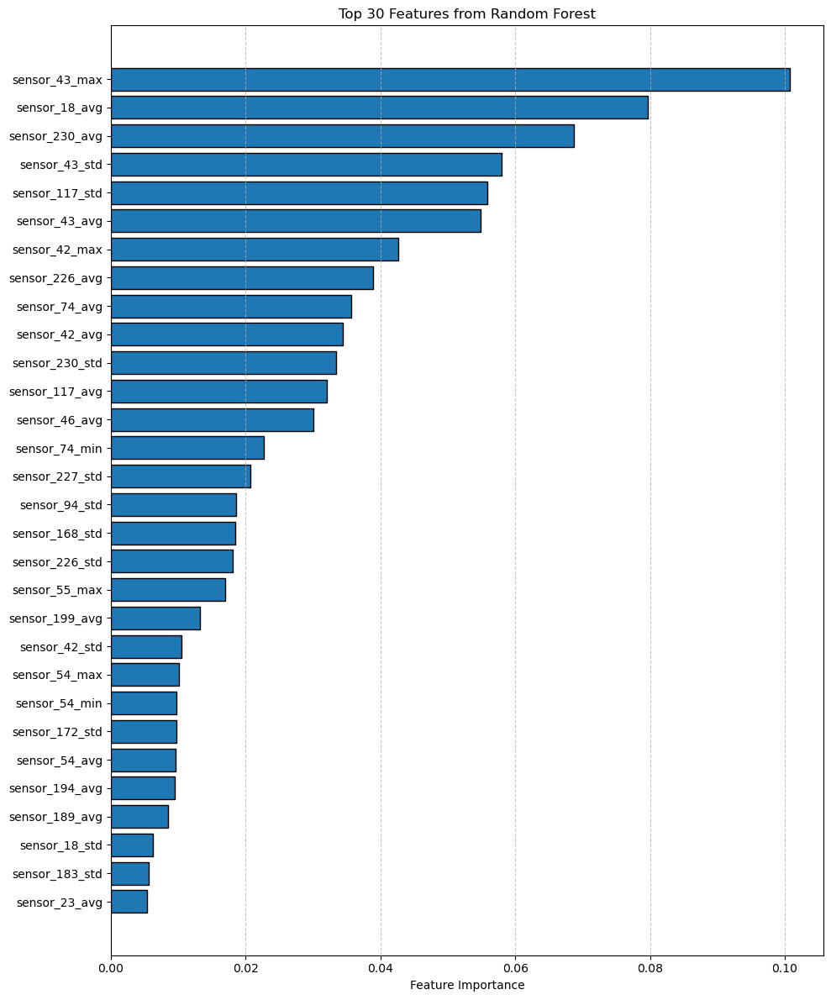

In [7]:
import matplotlib.pyplot as plt

# Sort by importance (already done, but ensuring here)
top_30_sorted = importance_df.head(30).sort_values(by='importance', ascending=True)

# Plot
plt.figure(figsize=(10, 12))
plt.barh(top_30_sorted['feature'], top_30_sorted['importance'], edgecolor='black')
plt.xlabel("Feature Importance")
plt.title("Top 30 Features from Random Forest")
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


### failure checking into the whole data range

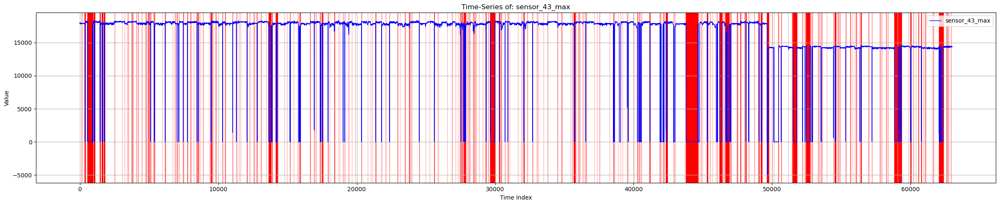

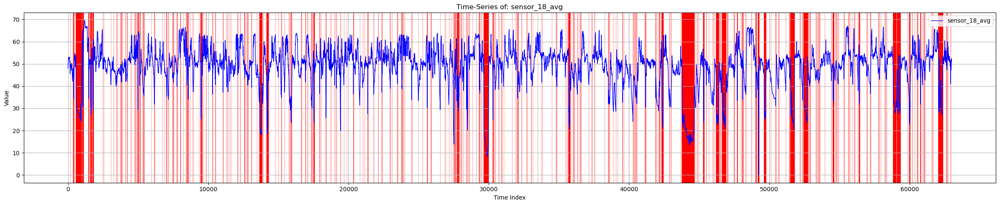

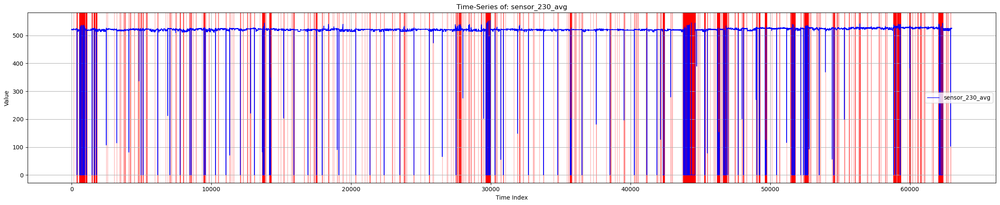

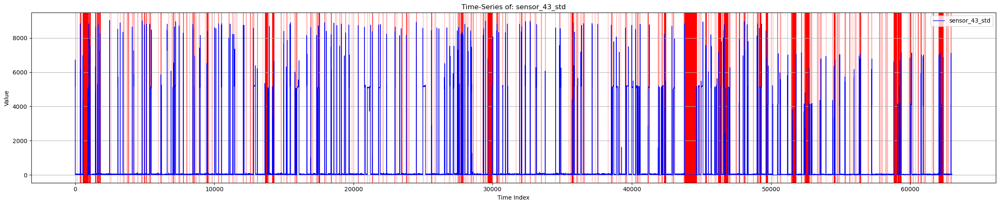

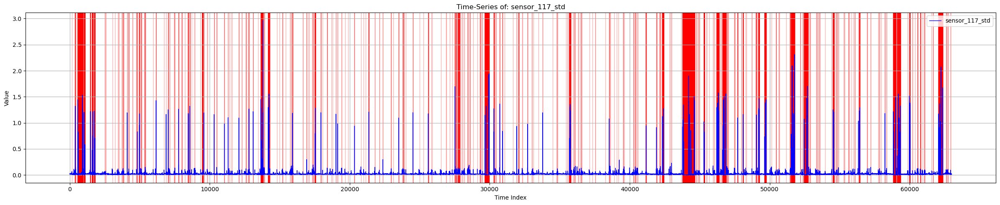

...

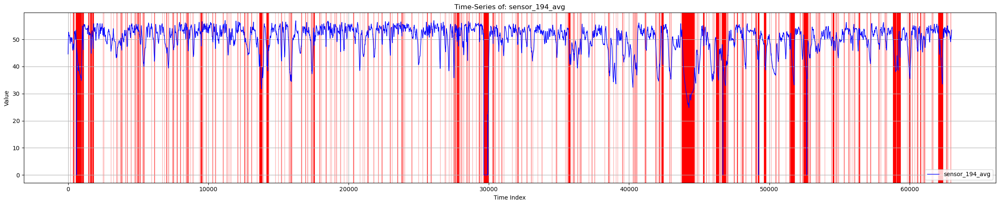

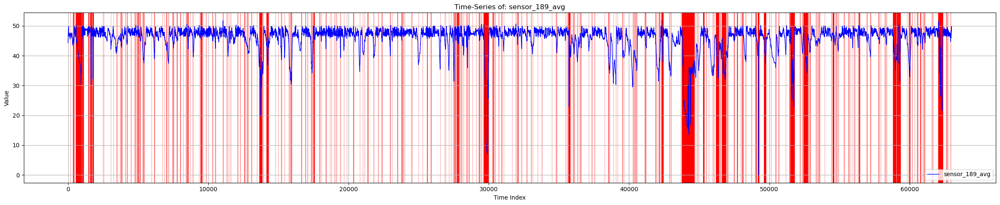

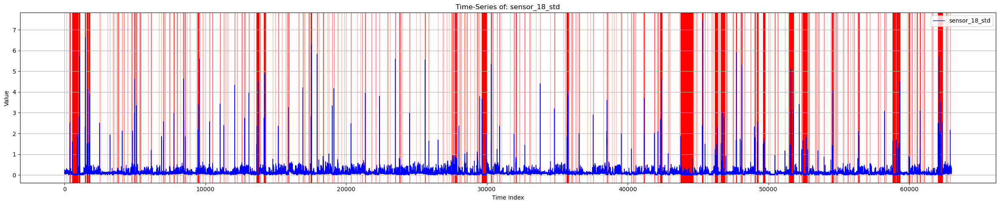

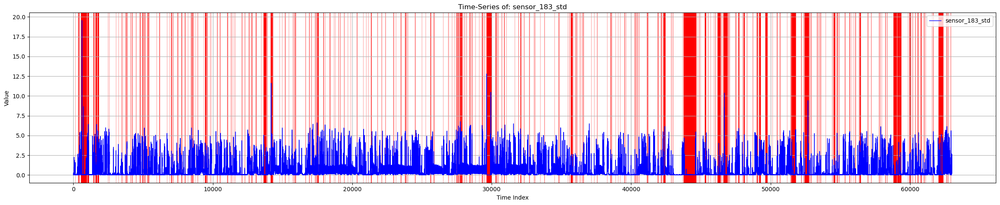

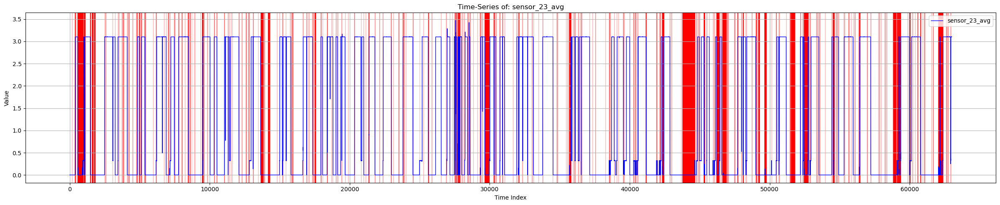

In [10]:
import matplotlib.pyplot as plt
import numpy as np

# Create binary target column (if not done)
df['target'] = df['status_type_id'].apply(lambda x: 0 if x in [0, 2] else 1)
anomaly_mask = df['target'].values

# Make sure top_30_features is a list of column names
top_30_features = importance_df.head(30)['feature'].tolist()

# Plot each top feature
for feature in top_30_features:
    plt.figure(figsize=(24, 5))

    # Anomaly background
    for i in range(len(anomaly_mask)):
        if anomaly_mask[i] == 1:
            plt.axvspan(i, i + 1, color='red', alpha=0.3)

    # Plot sensor signal
    plt.plot(df[feature].values, label=feature, color='blue', linewidth=1)

    # Formatting
    plt.title(f"Time-Series of: {feature}")
    plt.xlabel("Time Index")
    plt.ylabel("Value")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


### checking the differnt failure(anomaly) using different color marking

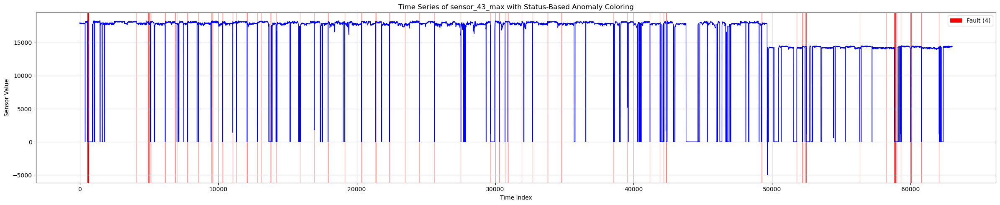

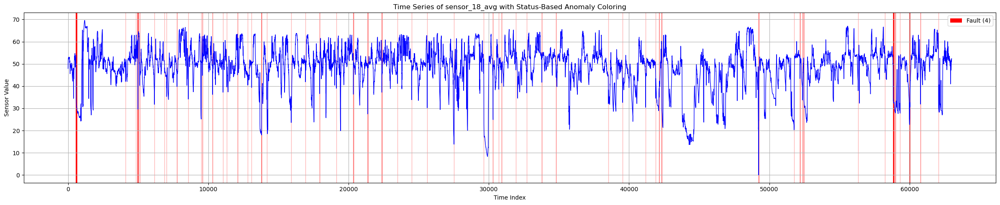

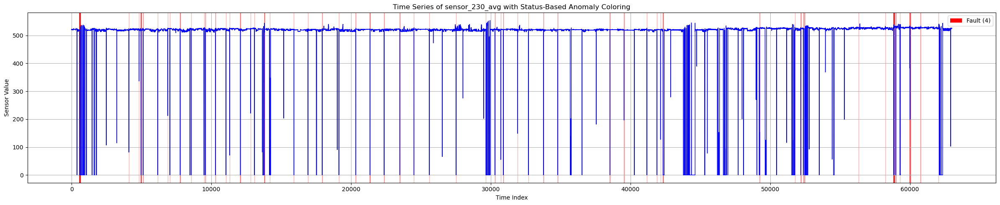

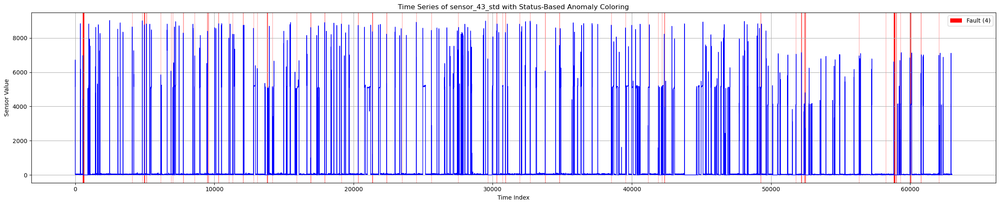

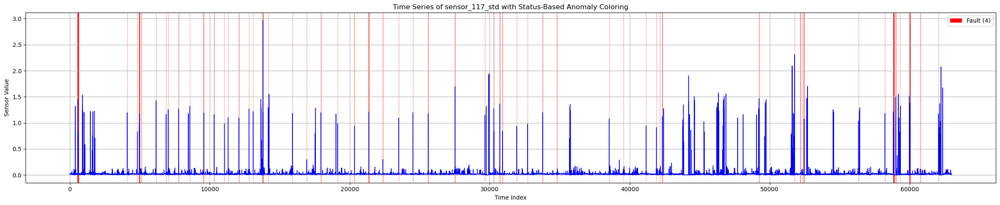

...

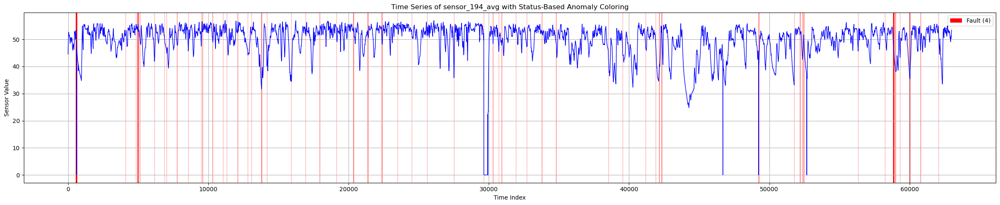

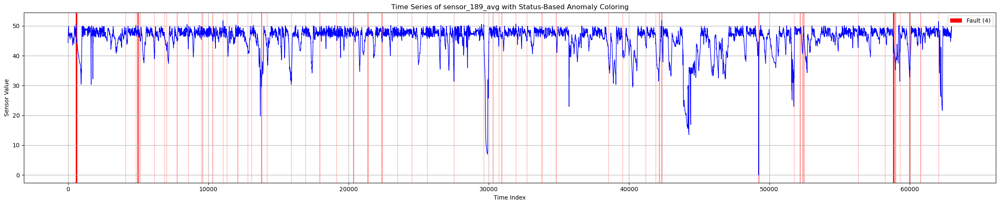

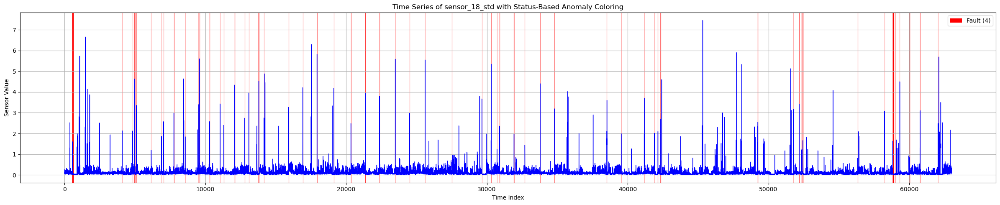

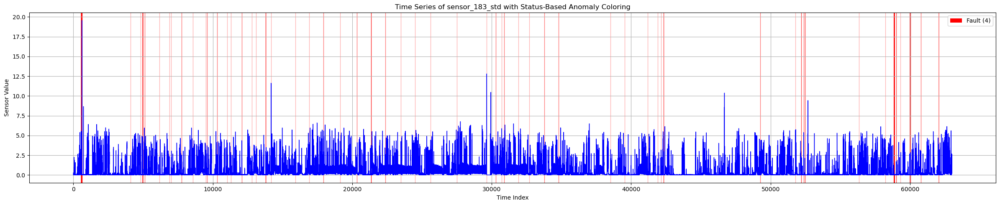

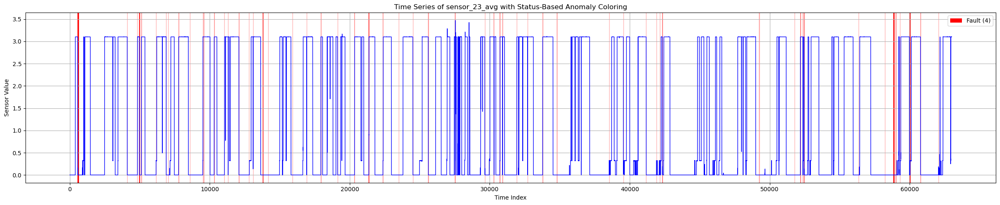

In [97]:
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# Set top 30 features
top_30_features = [
    'sensor_43_max', 'sensor_18_avg', 'sensor_230_avg', 'sensor_43_std', 'sensor_117_std',
    'sensor_43_avg', 'sensor_42_max', 'sensor_226_avg', 'sensor_74_avg', 'sensor_42_avg',
    'sensor_230_std', 'sensor_117_avg', 'sensor_46_avg', 'sensor_74_min', 'sensor_227_std',
    'sensor_94_std', 'sensor_168_std', 'sensor_226_std', 'sensor_55_max', 'sensor_199_avg',
    'sensor_42_std', 'sensor_54_max', 'sensor_54_min', 'sensor_172_std', 'sensor_54_avg',
    'sensor_194_avg', 'sensor_189_avg', 'sensor_18_std', 'sensor_183_std', 'sensor_23_avg'
]

# Background color map
status_color_map = {
    4: 'red',      # Fault
}

# Get status array
status_array = df['status_type_id'].values

# Plot each feature
for feature in top_30_features:
    plt.figure(figsize=(24, 5))

    # Mark background by status
    for i, status in enumerate(status_array):
        color = status_color_map.get(status)
        if color:
            plt.axvspan(i, i + 1, color=color, alpha=0.3)

    # Plot sensor data
    plt.plot(df[feature].values, label=feature, color='blue', linewidth=1)

    # Add legend for background colors
    legend_elements = [
        Patch(facecolor='red', label='Fault (4)'),
        
    ]
    plt.legend(handles=legend_elements)

    # Labels and layout
    plt.title(f"Time Series of {feature} with Status-Based Anomaly Coloring")
    plt.xlabel("Time Index")
    plt.ylabel("Sensor Value")
    plt.grid(True)
    plt.tight_layout()
    plt.show()


### Experiment: This is for the checking each sensors before the anomaly event (you can change the buffer)

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


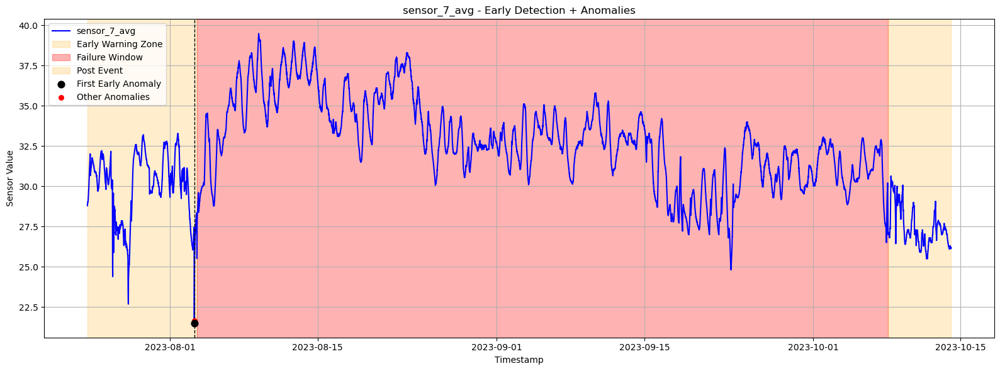

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


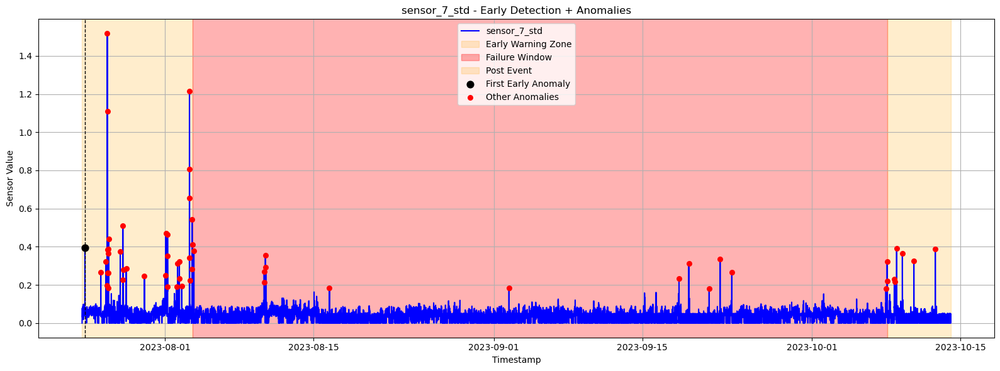

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


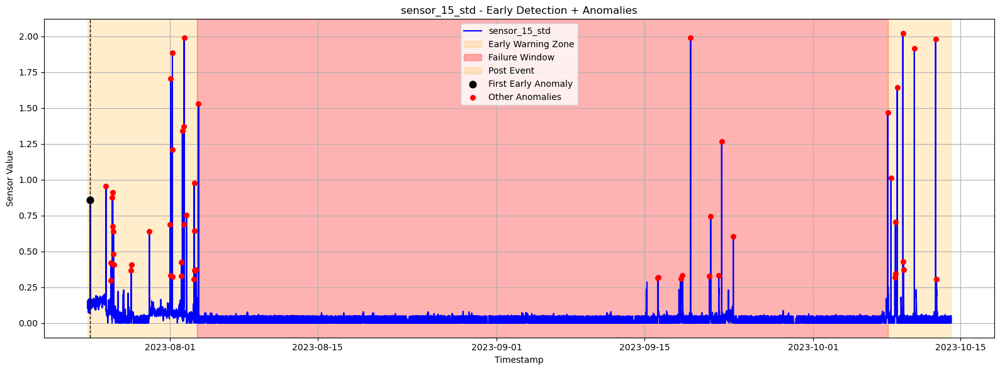

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


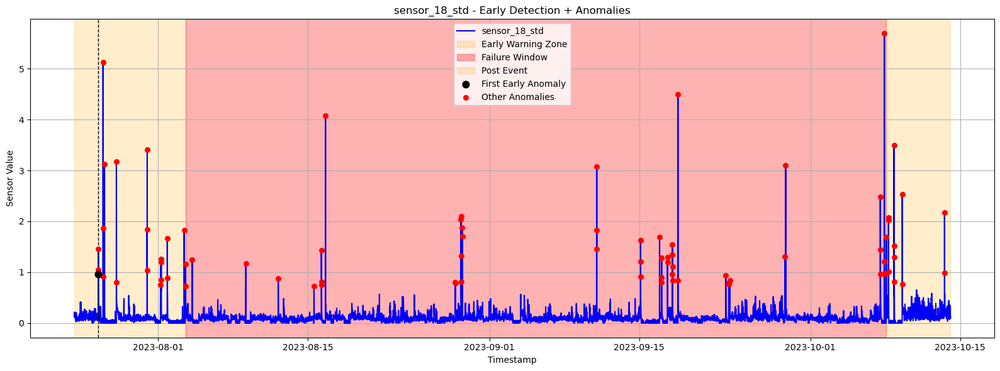

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


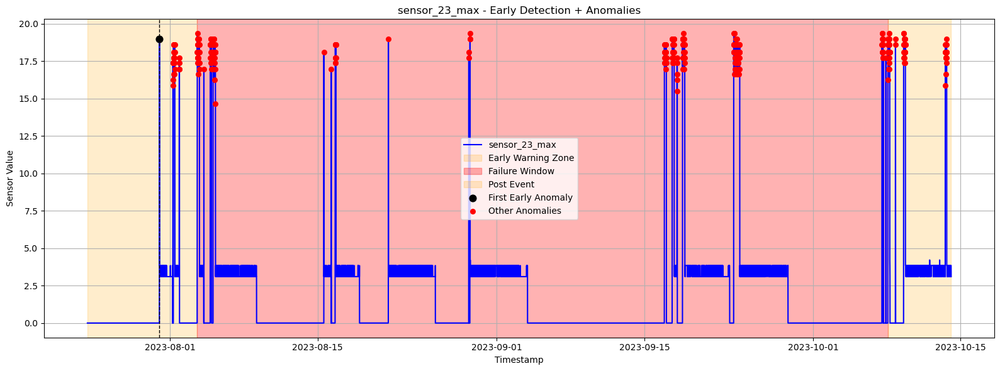

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


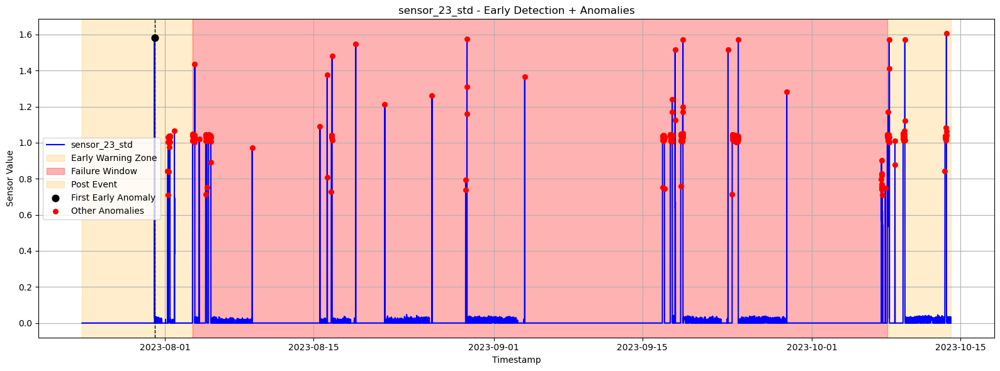

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


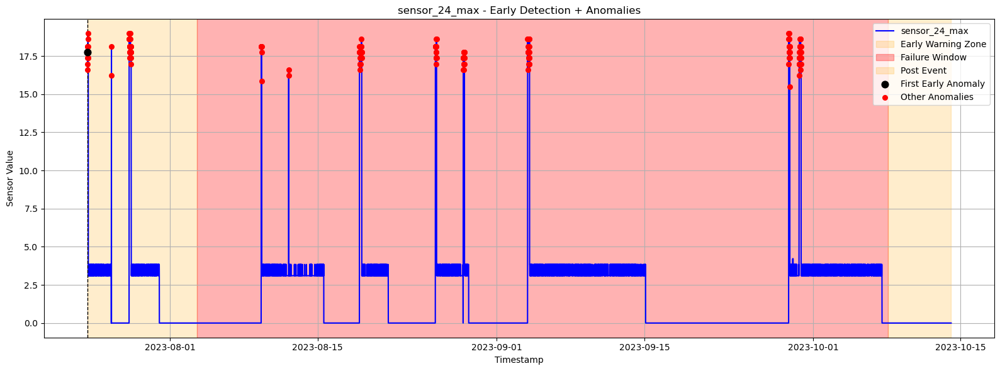

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


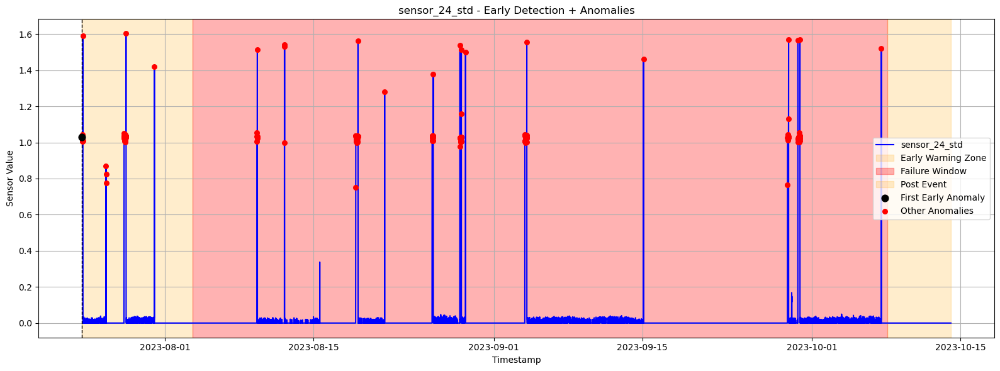

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


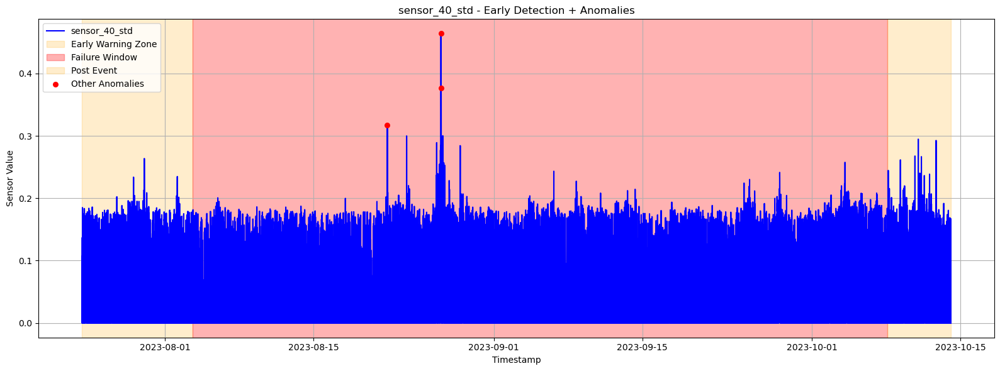

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


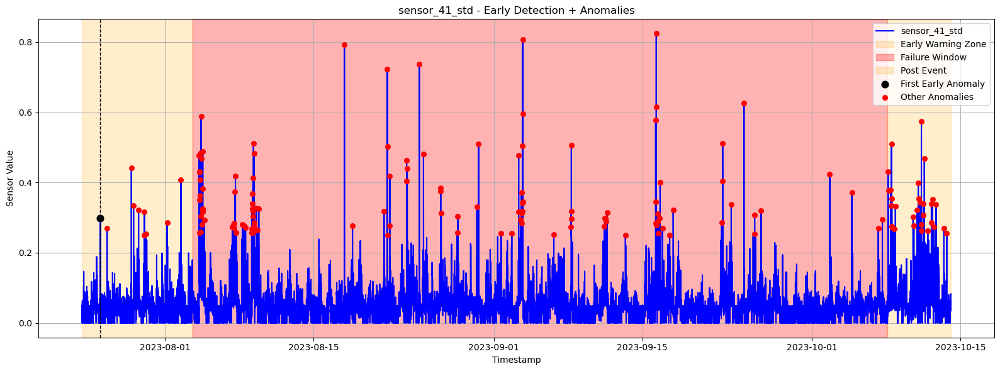

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


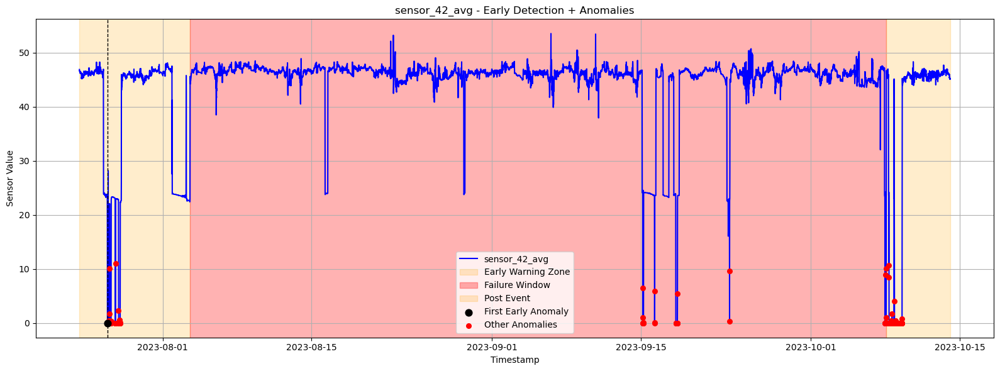

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


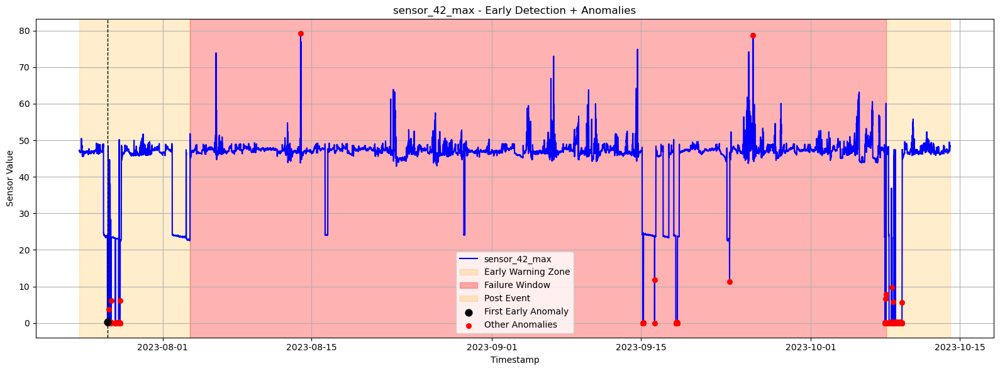

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


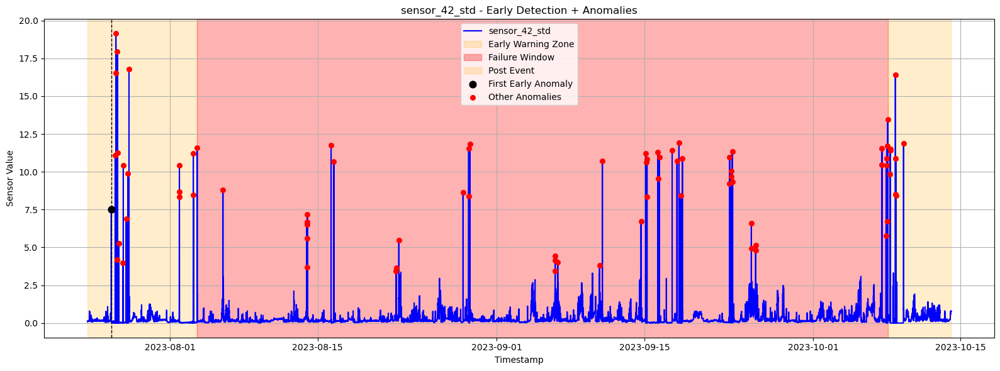

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


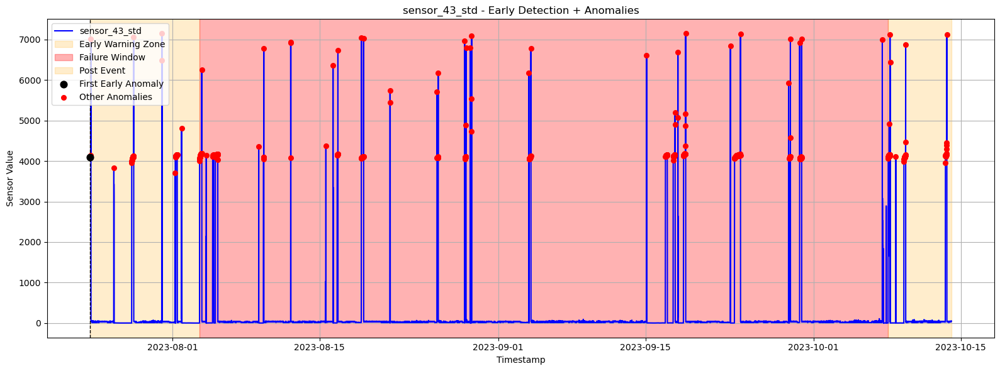

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


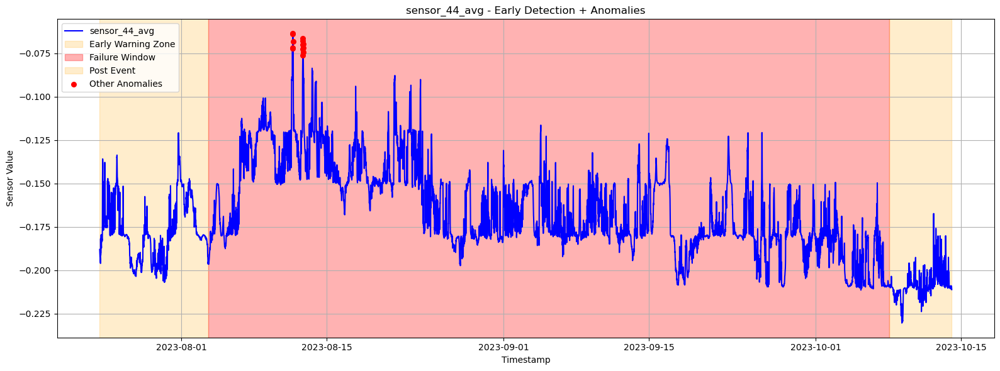

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


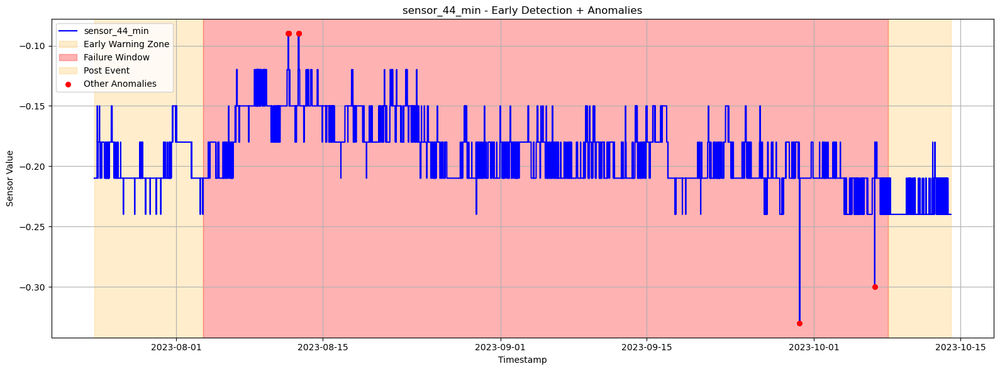

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


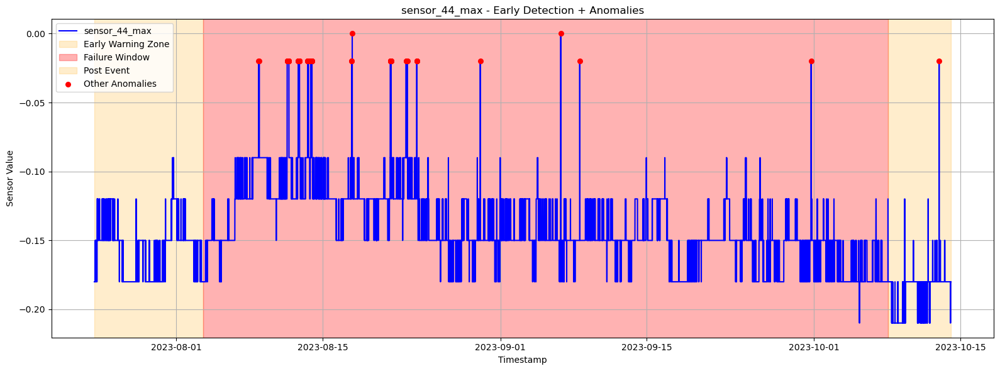

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


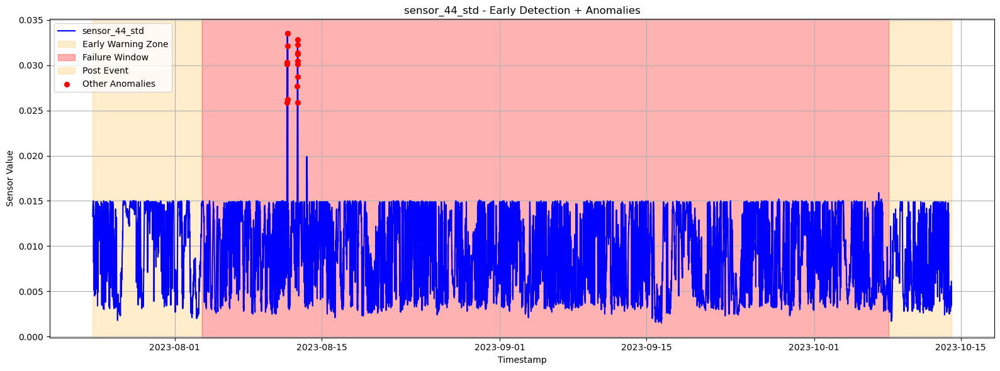

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


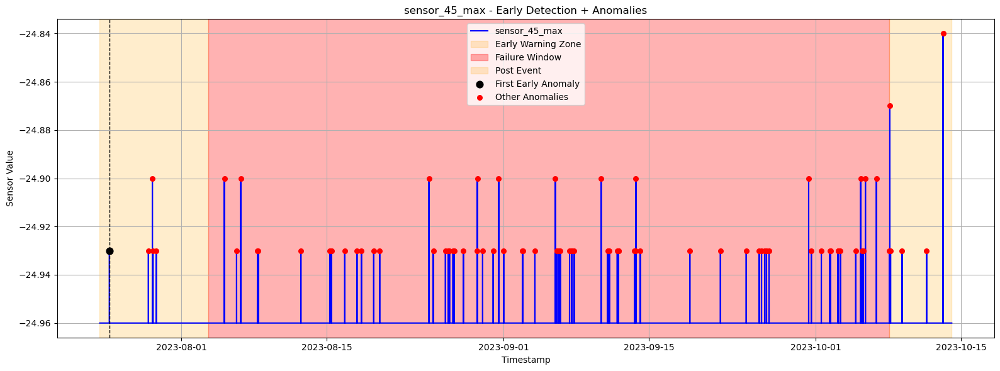

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


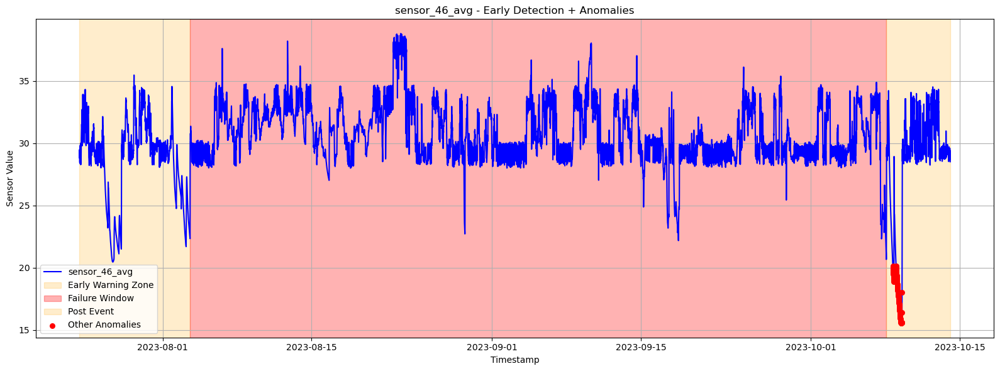

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


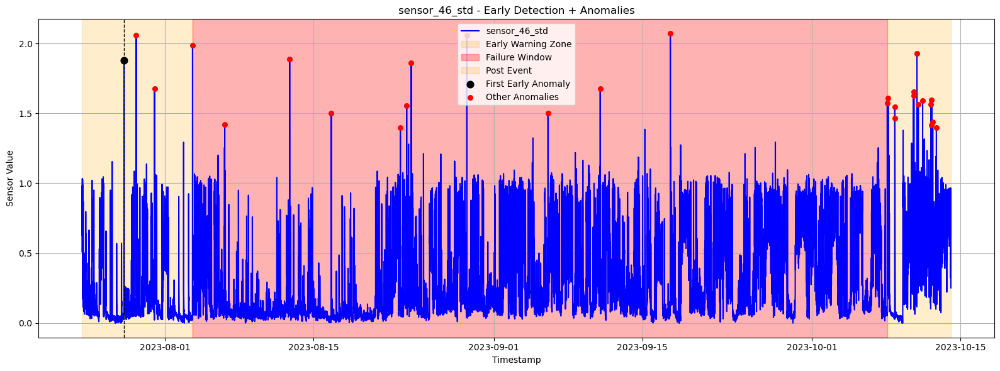

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


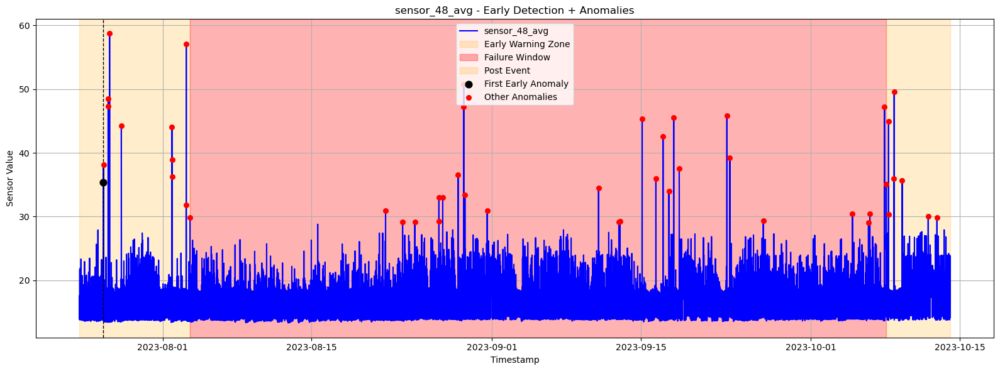

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


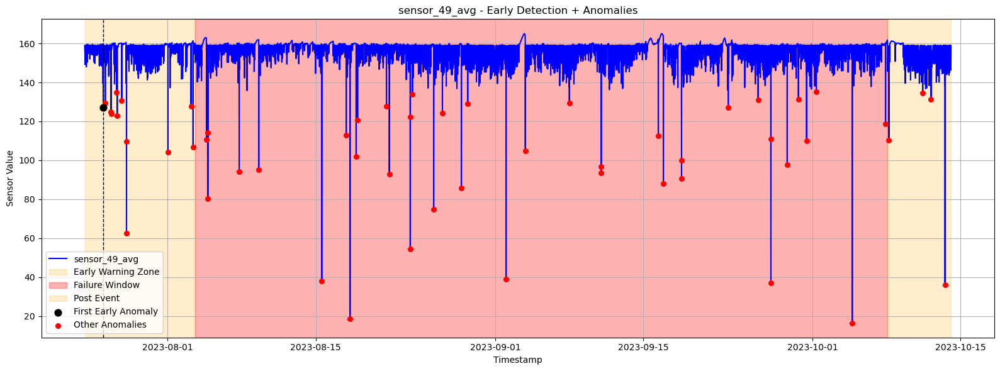

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


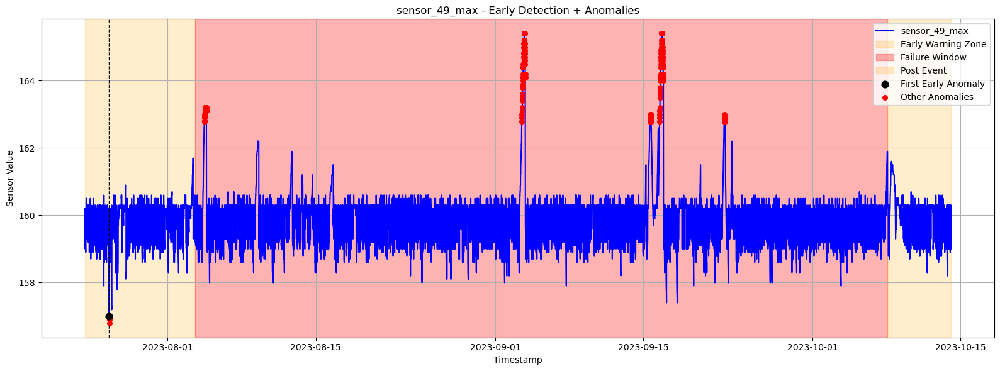

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


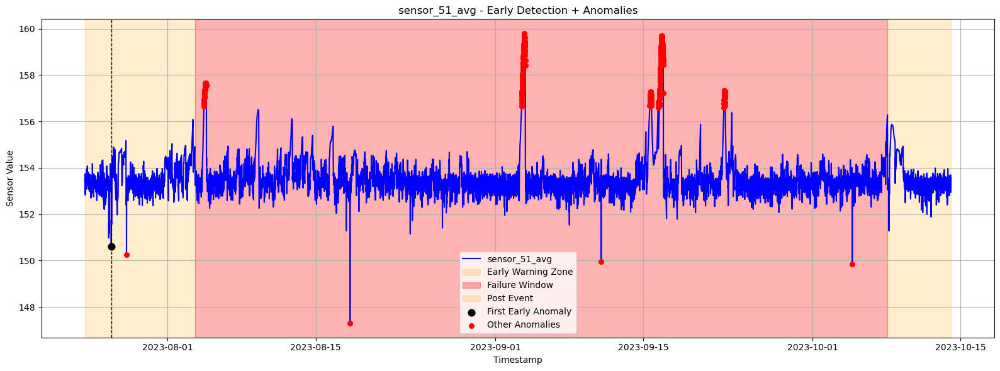

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


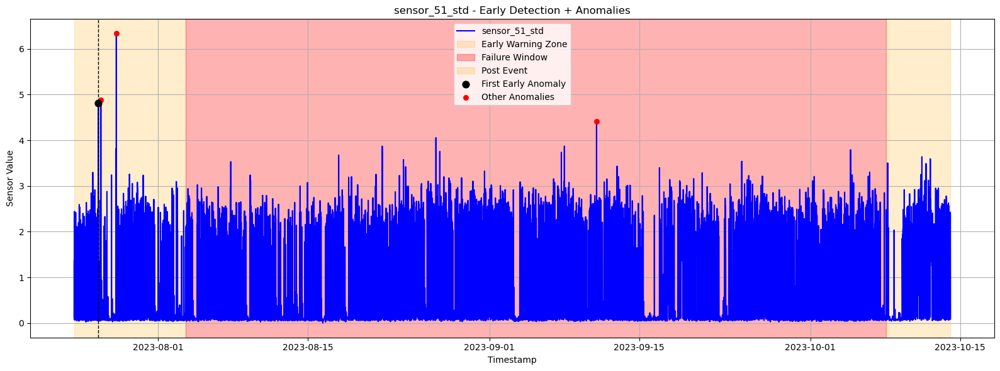

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


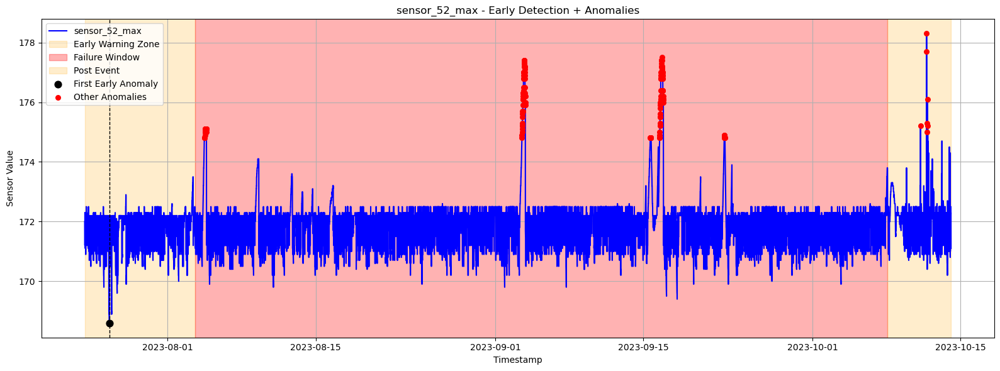

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


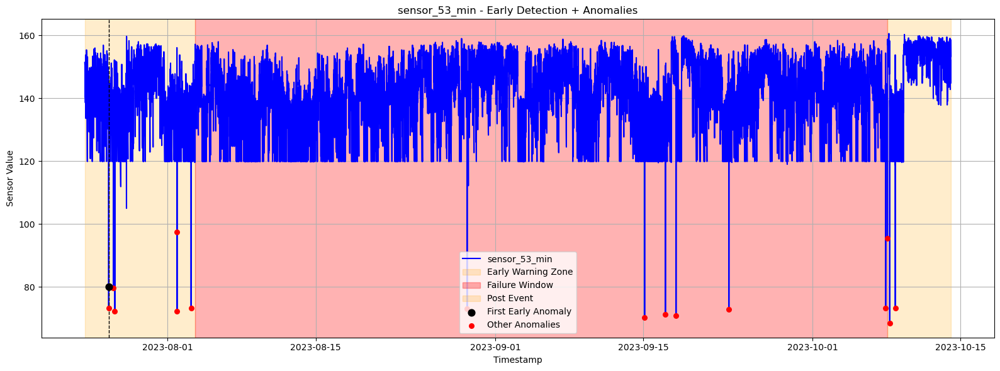

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


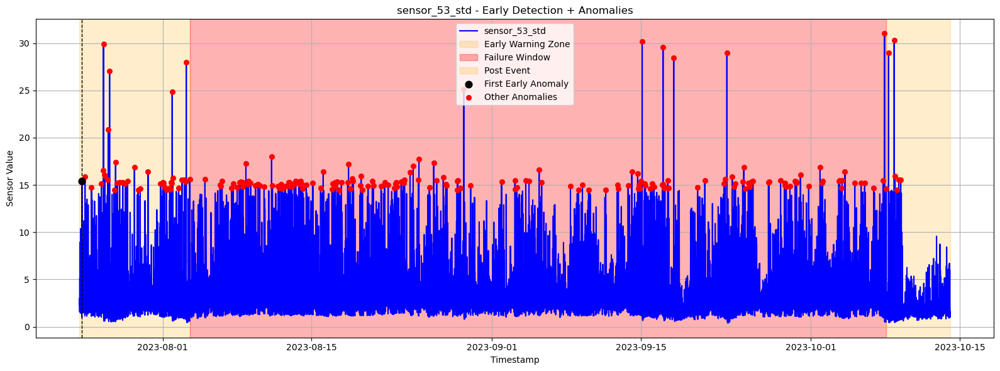

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


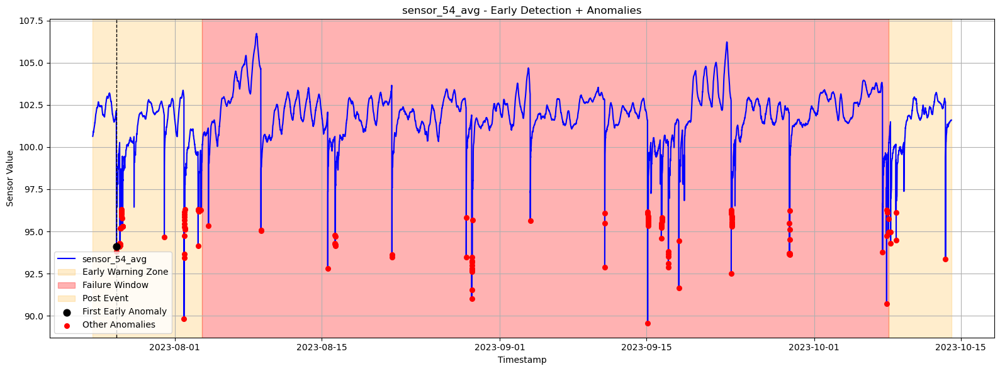

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


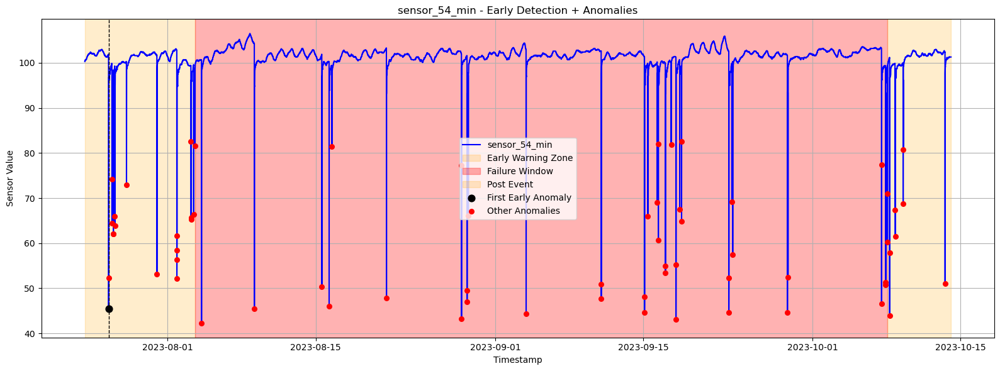

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


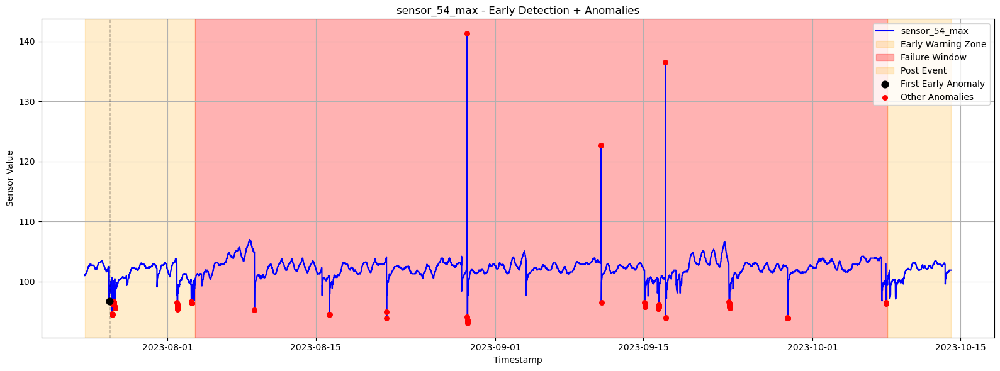

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


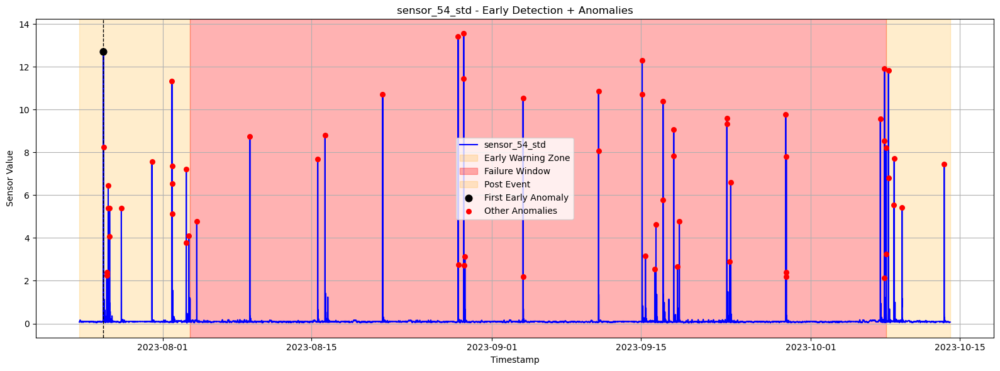

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


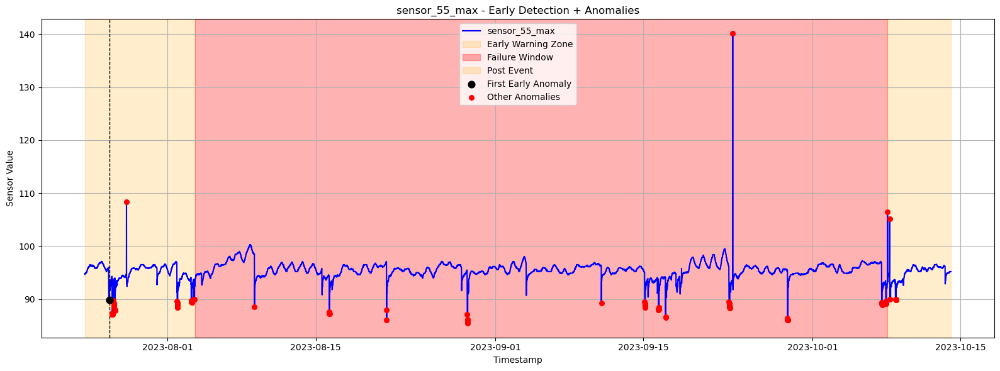

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


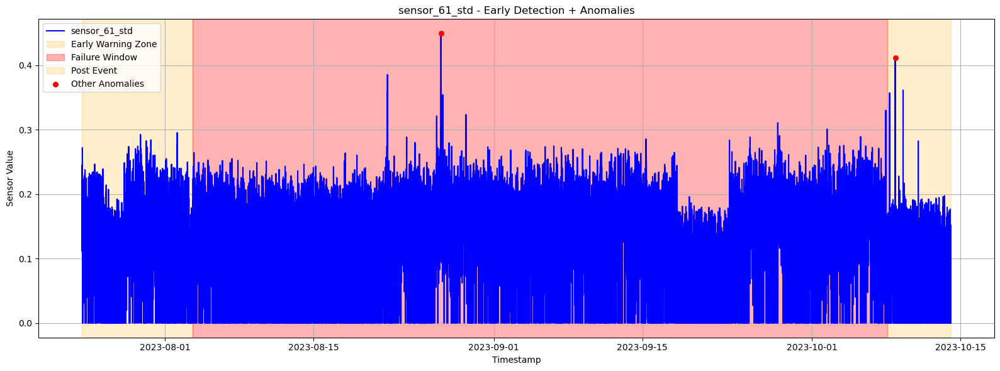

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


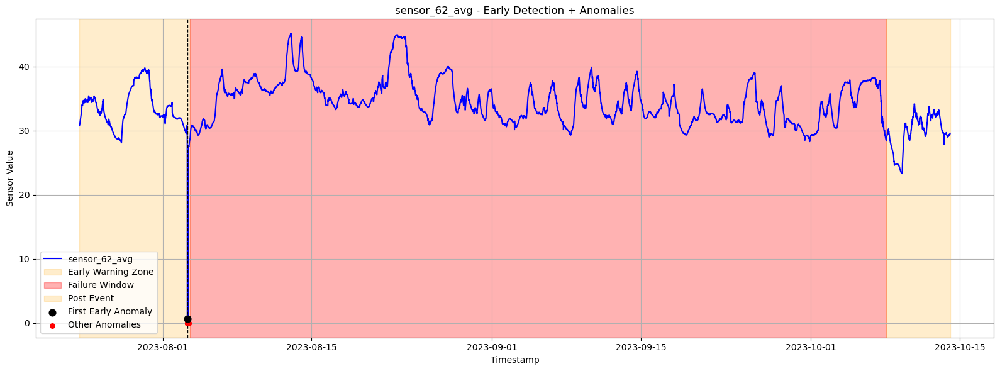

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


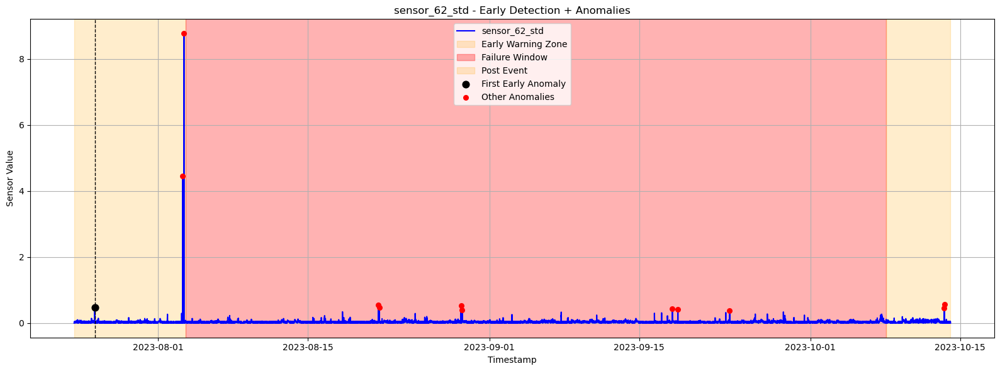

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


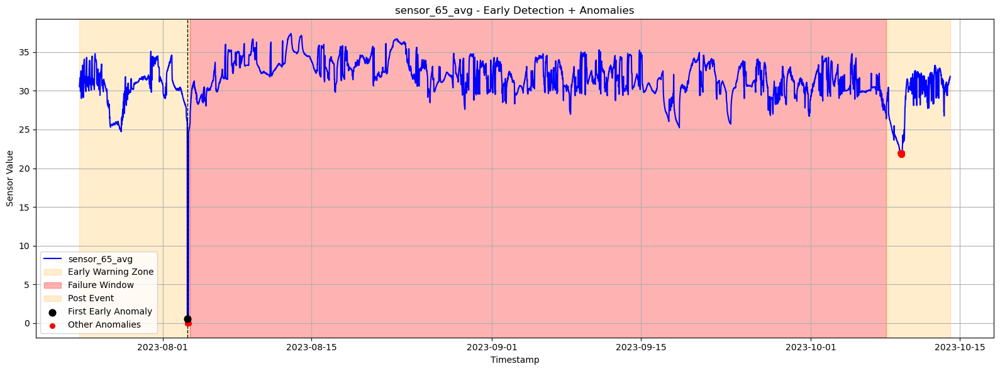

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


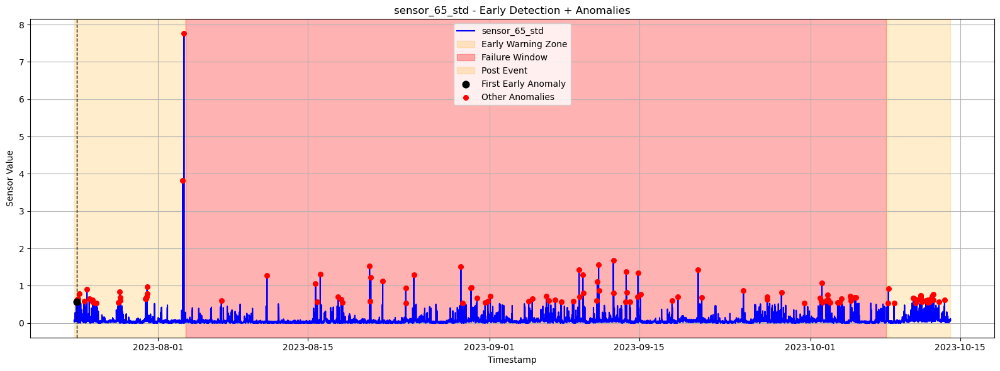

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


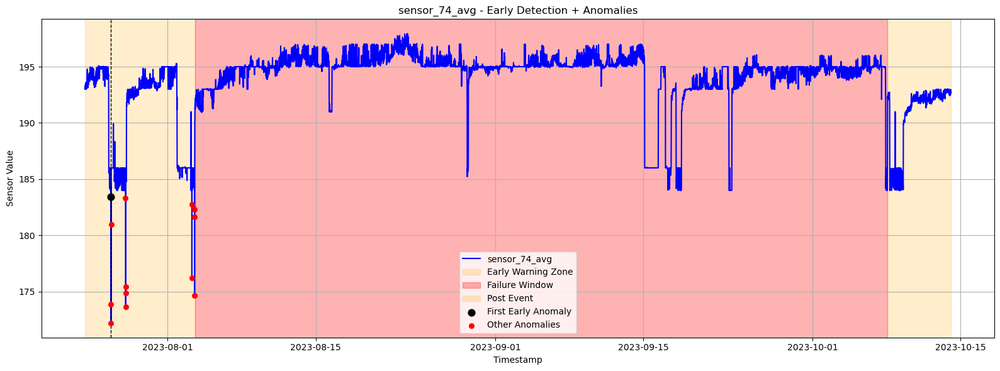

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


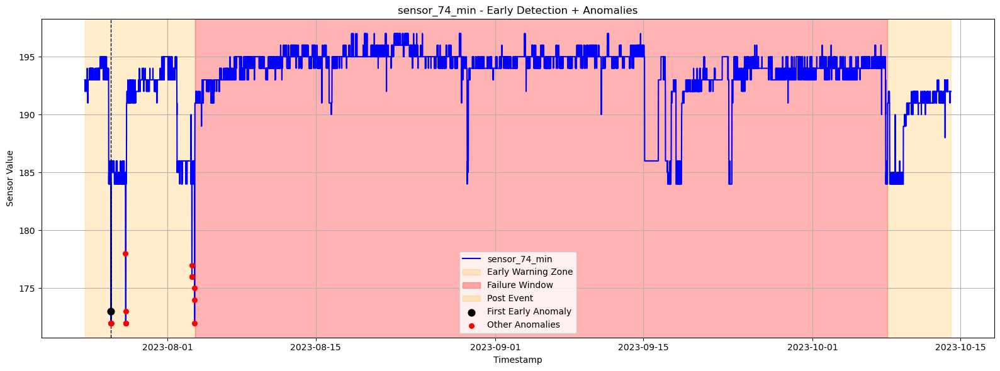

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


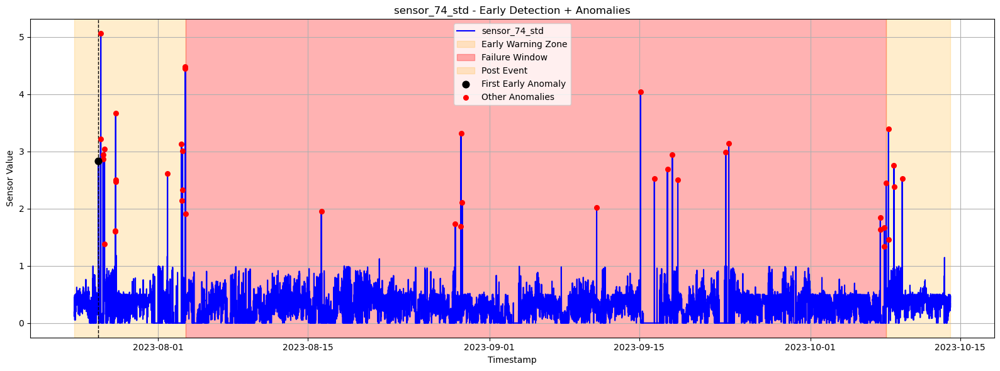

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


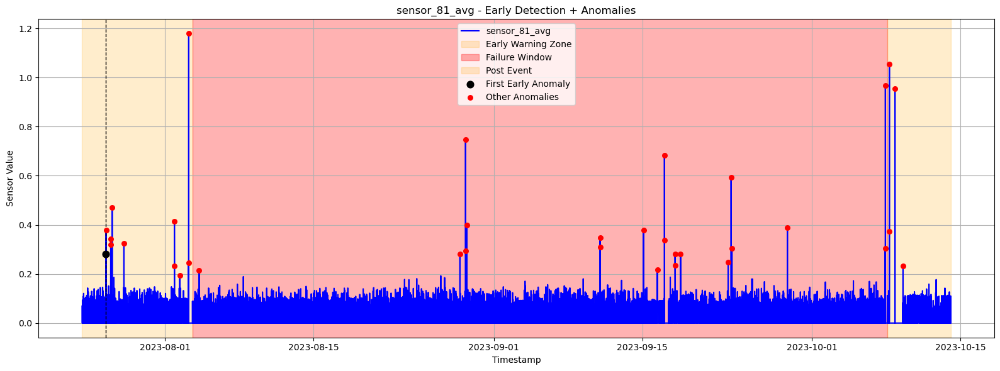

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


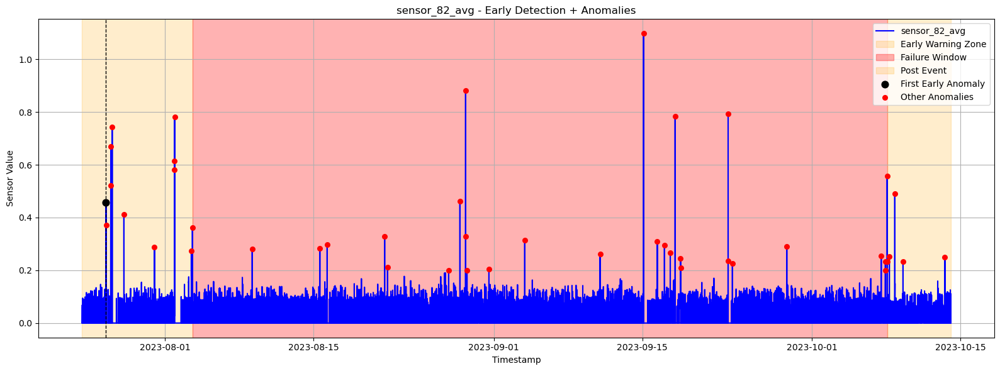

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746

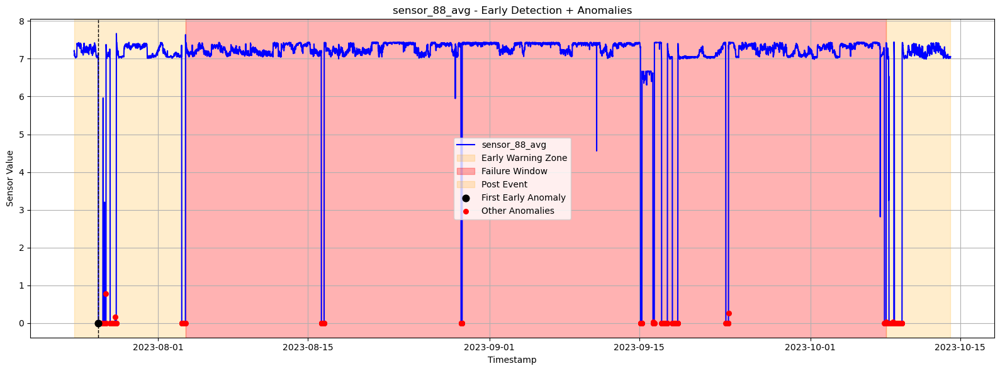

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


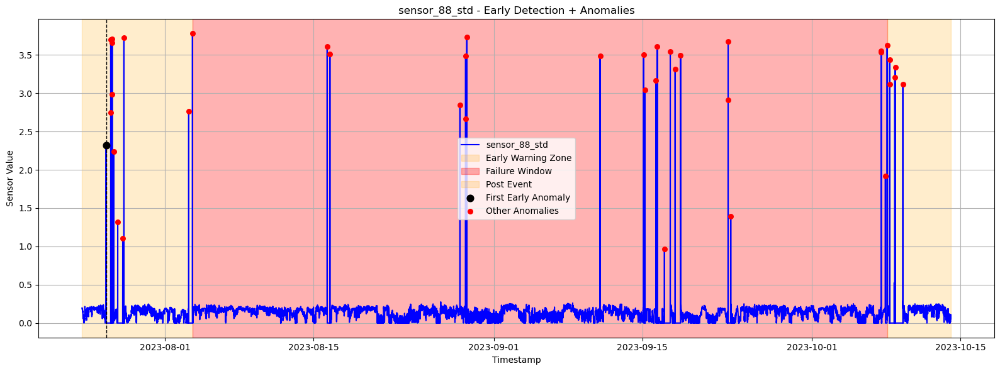

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


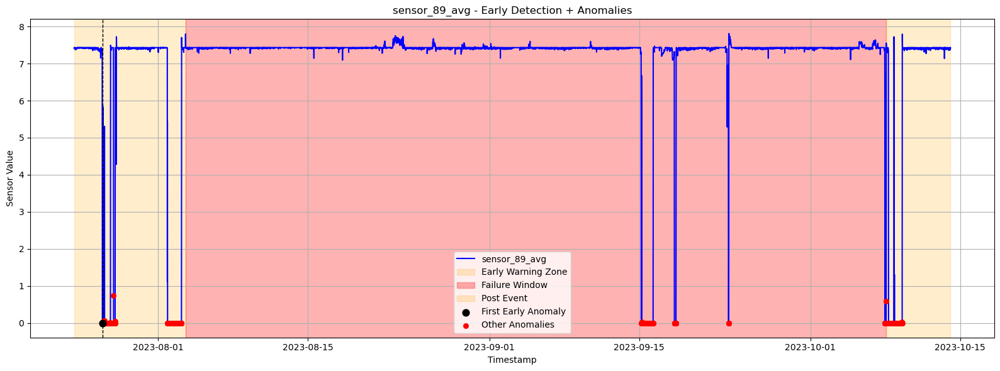

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


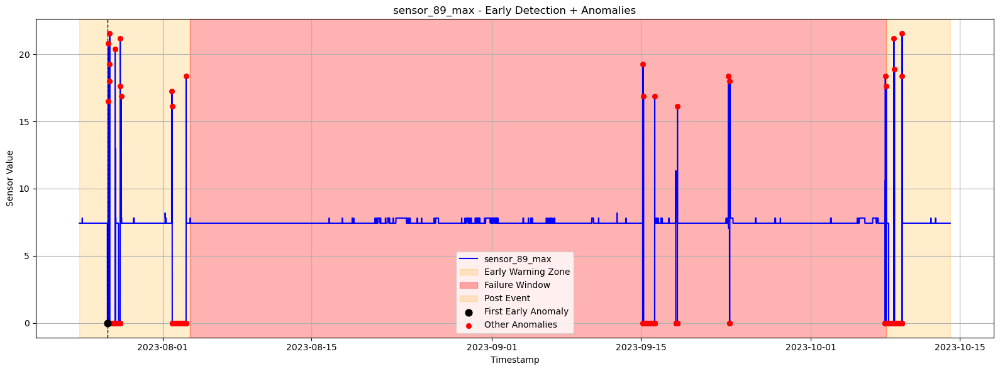

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


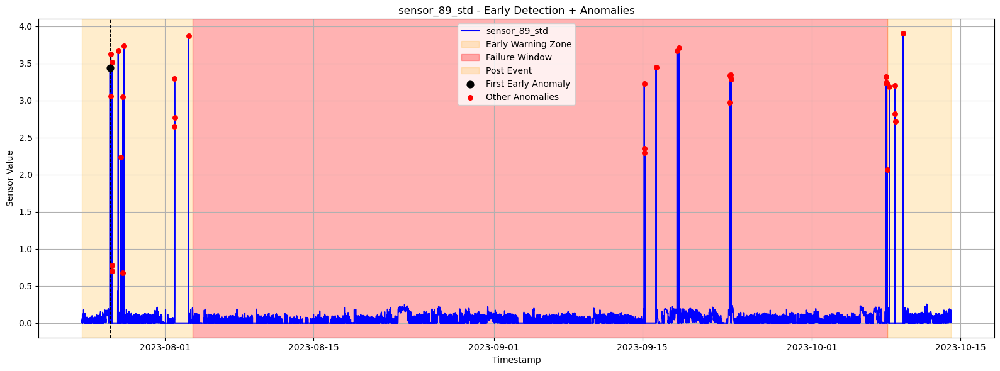

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


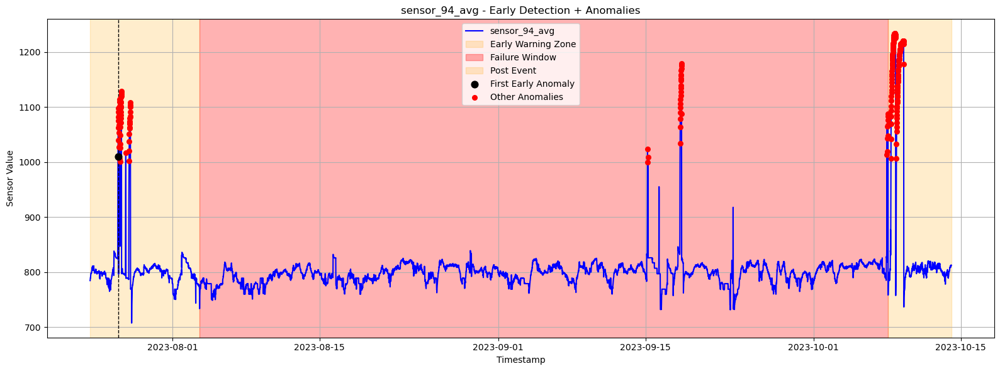

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


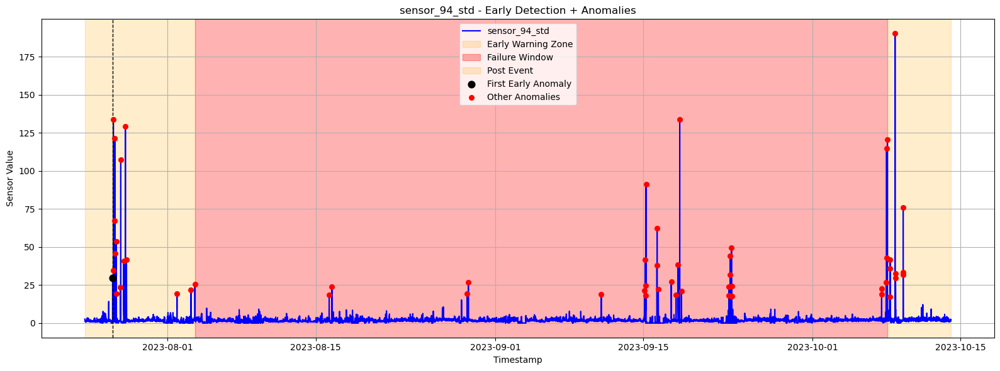

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


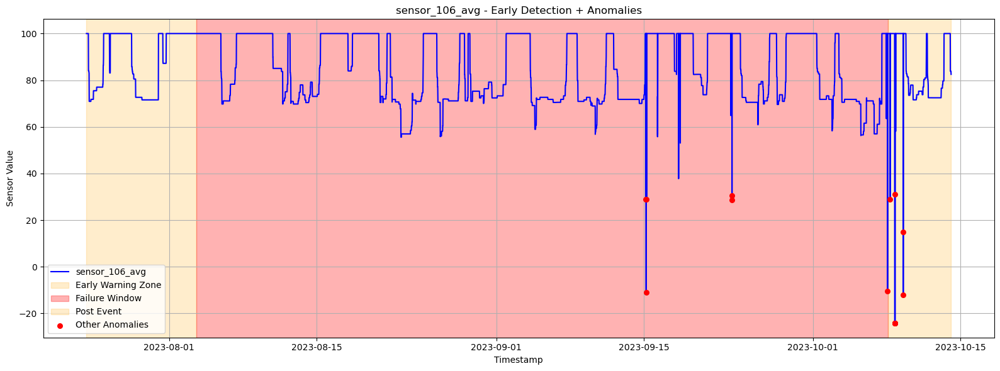

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


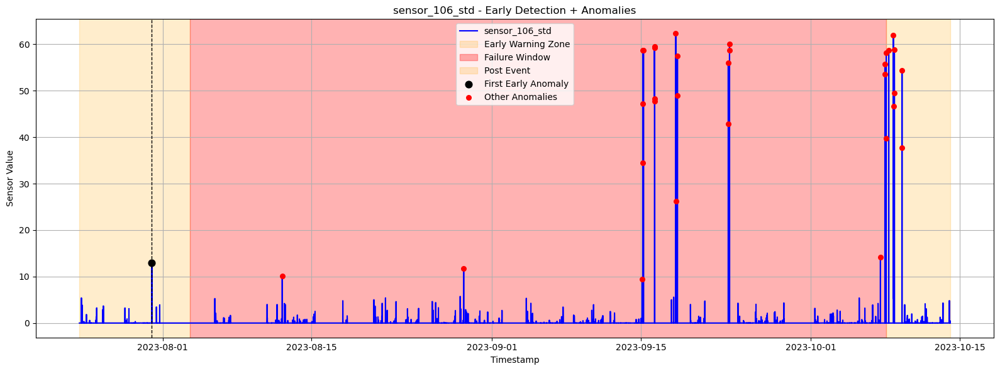

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


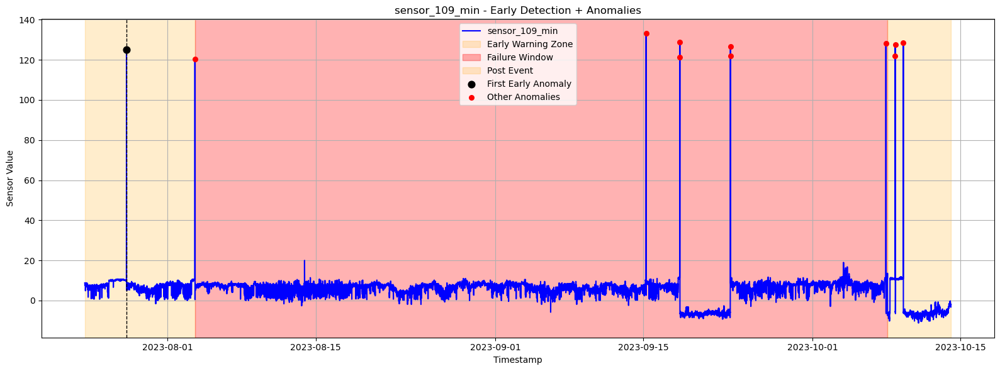

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


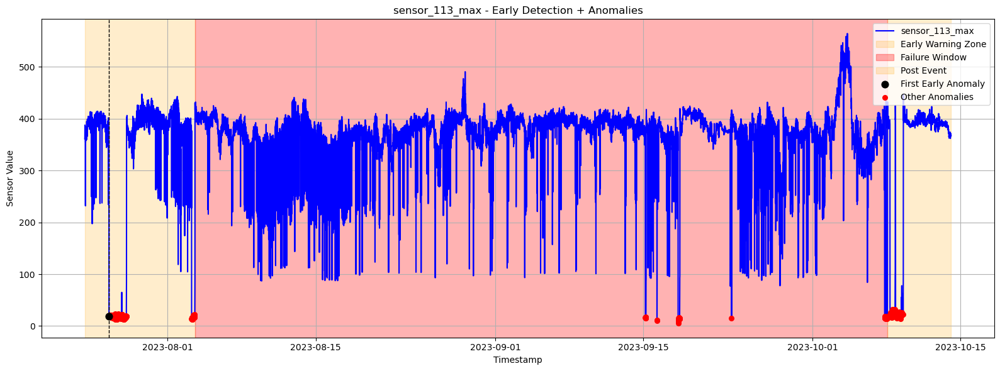

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


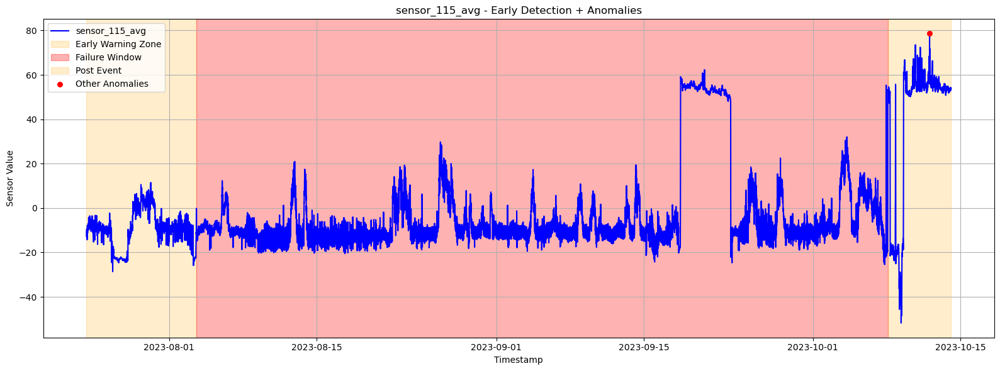

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


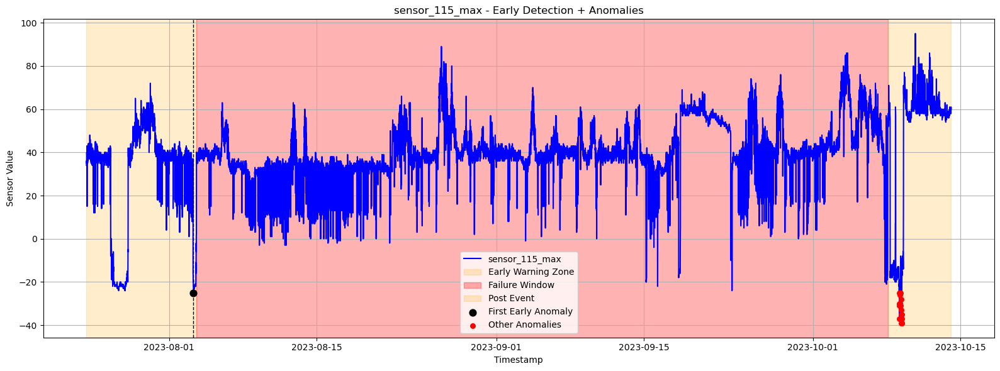

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


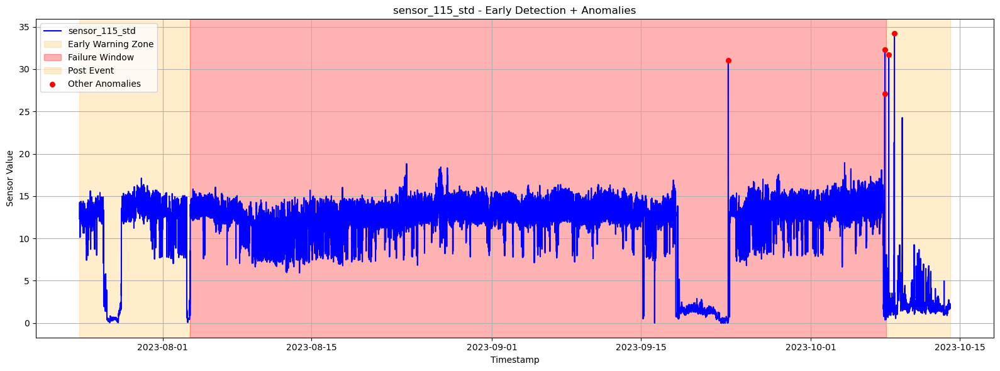

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


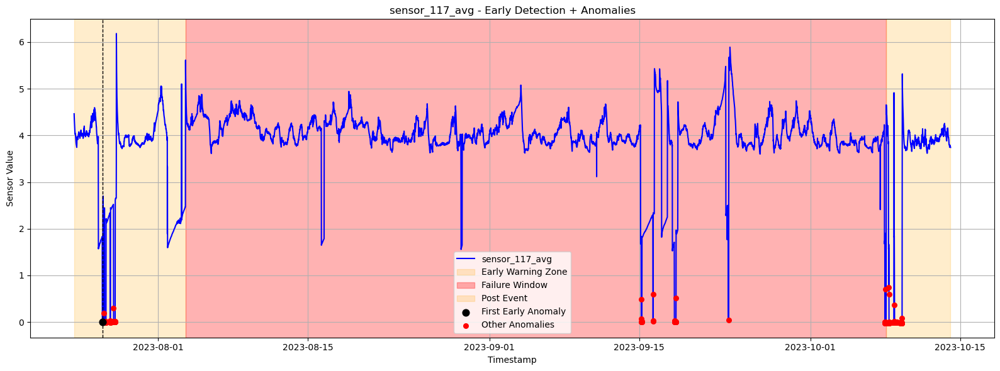

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


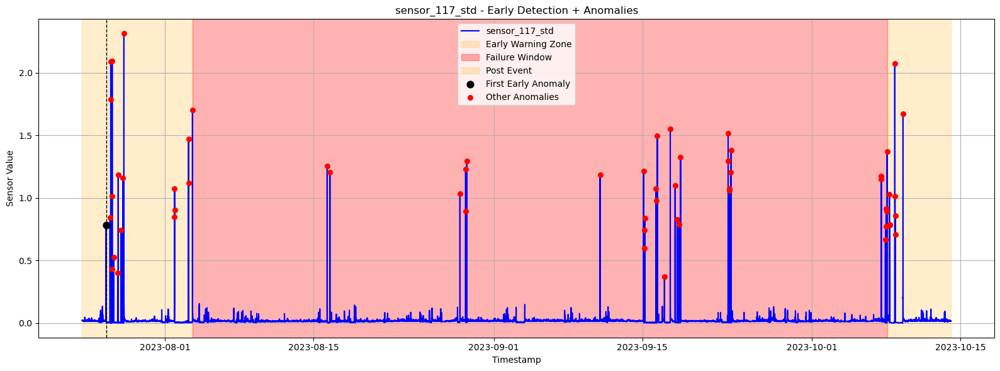

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


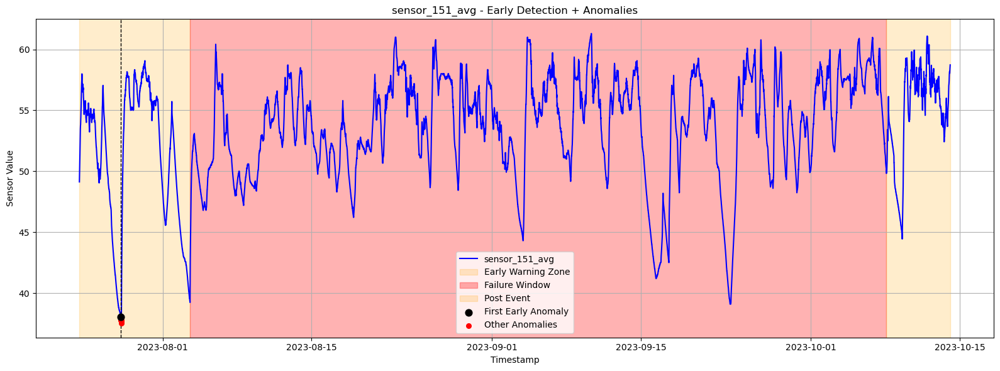

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


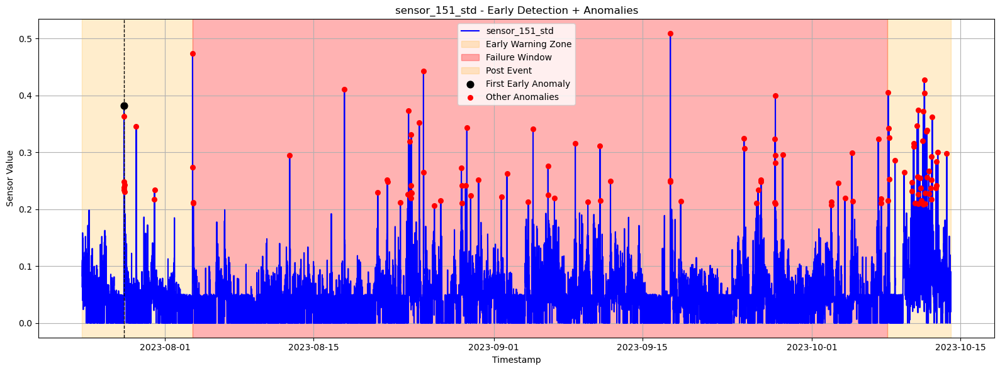

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


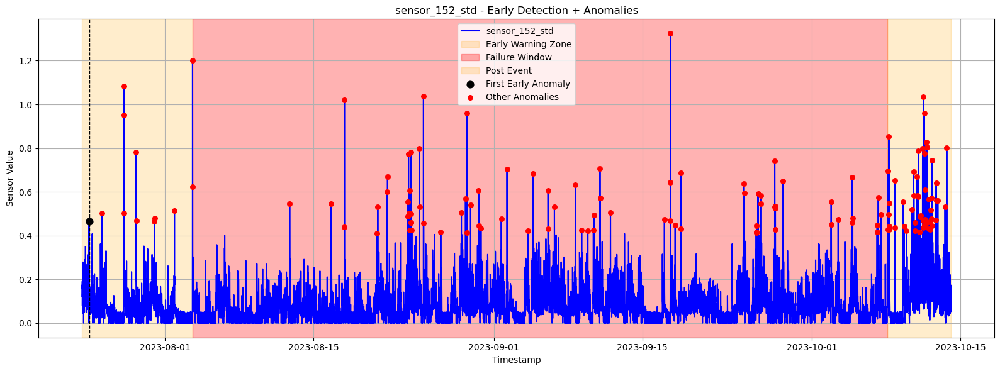

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


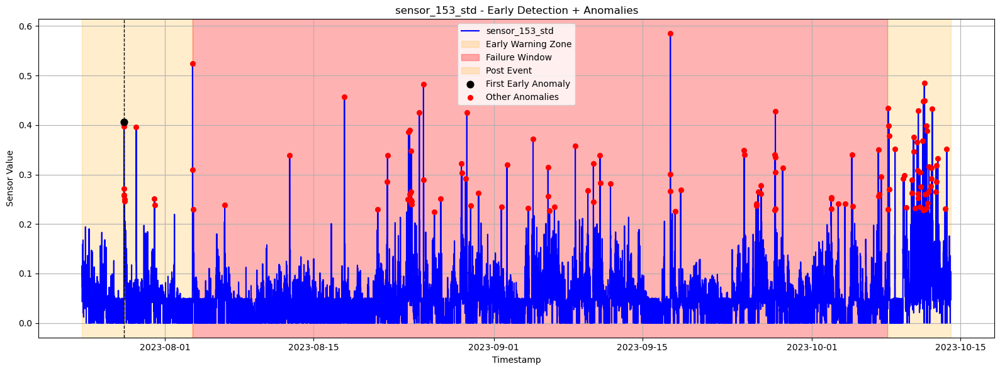

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


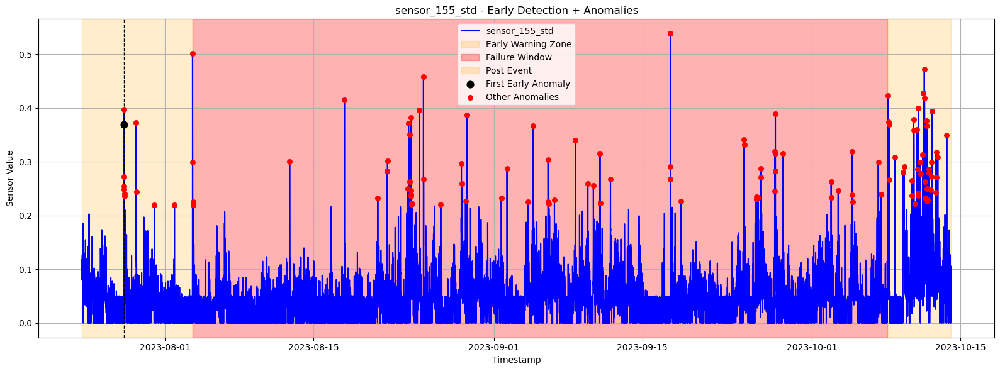

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


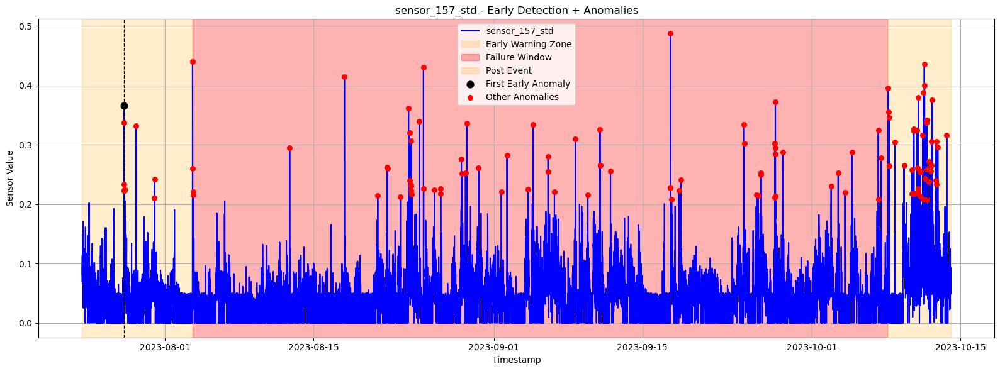

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


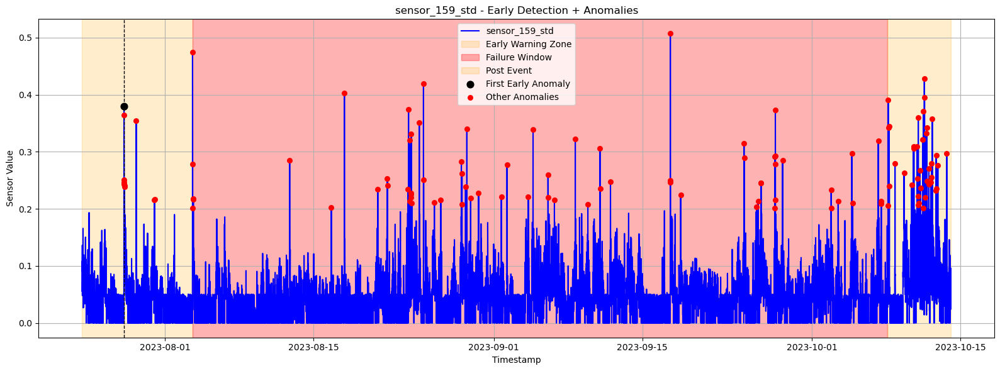

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


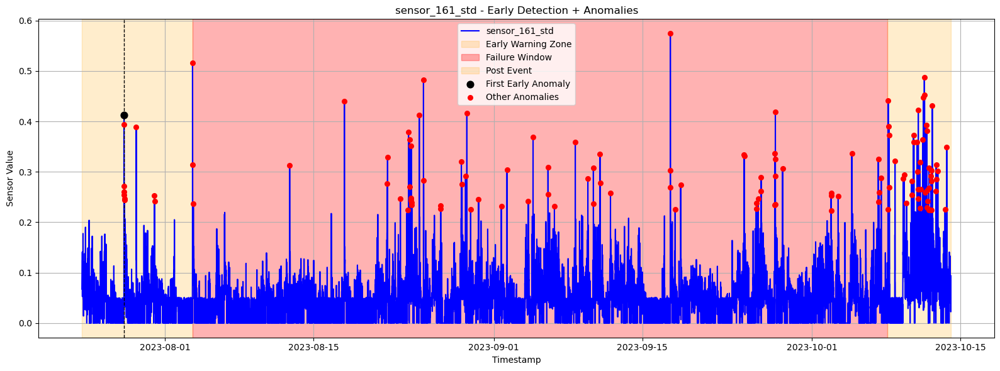

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


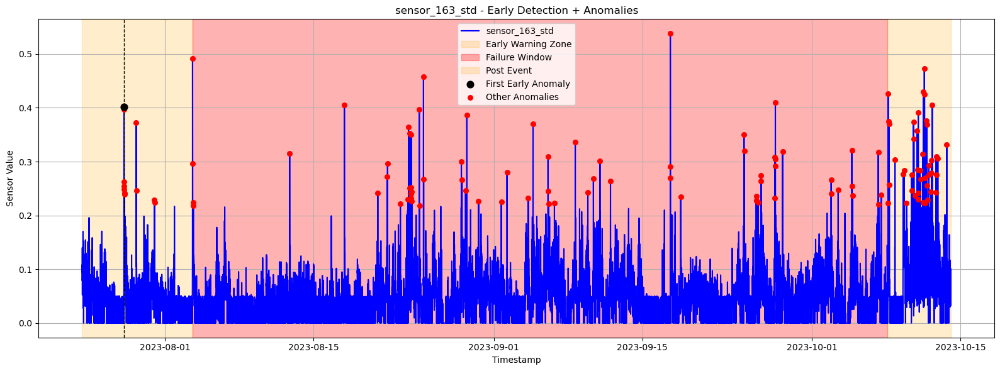

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


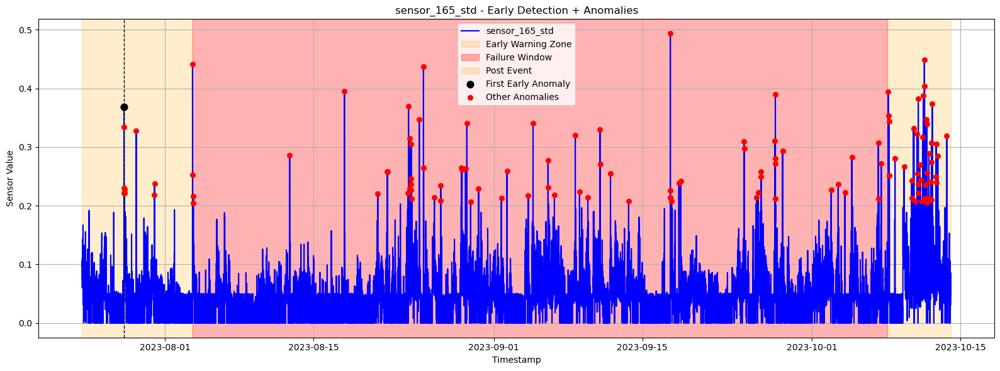

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


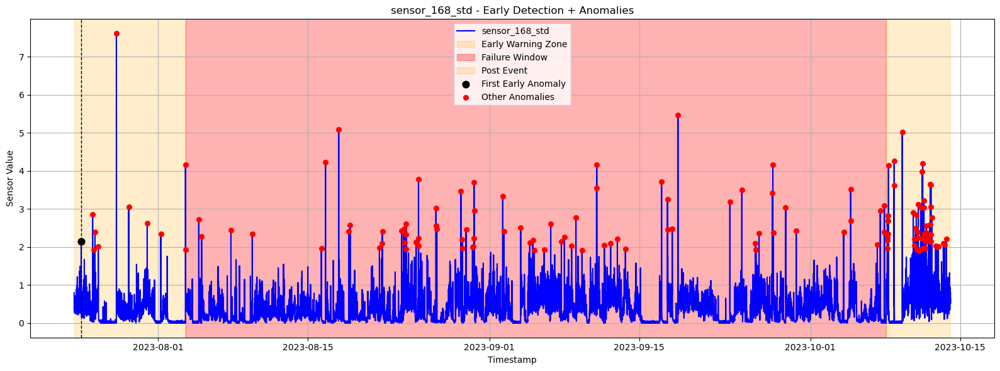

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


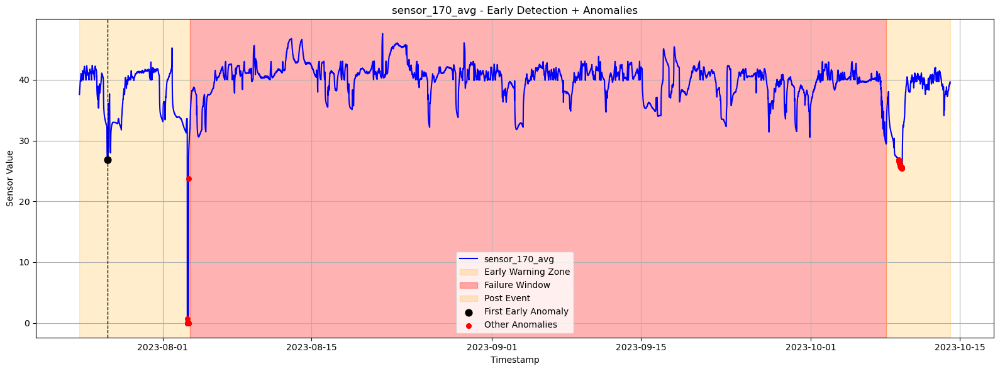

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


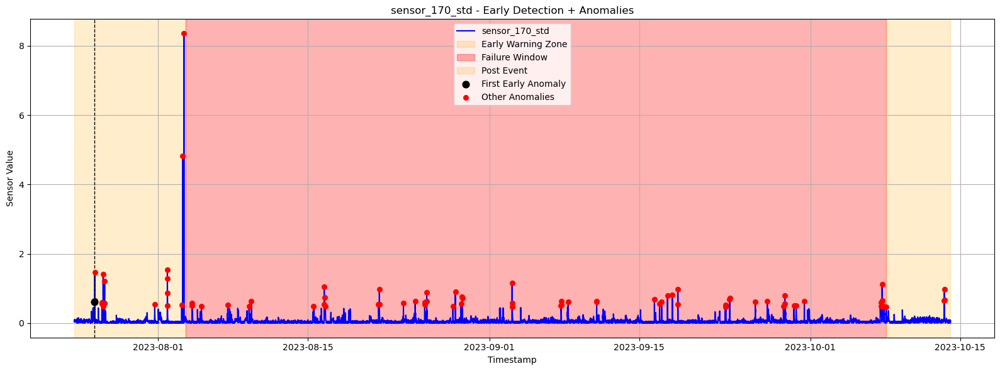

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


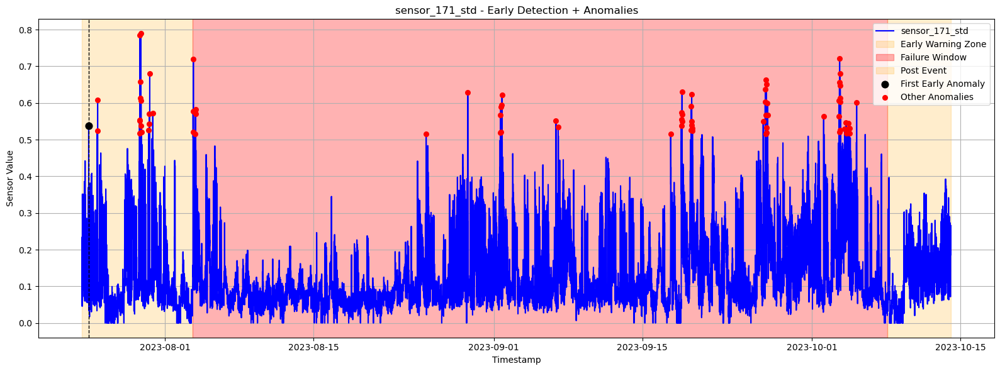

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


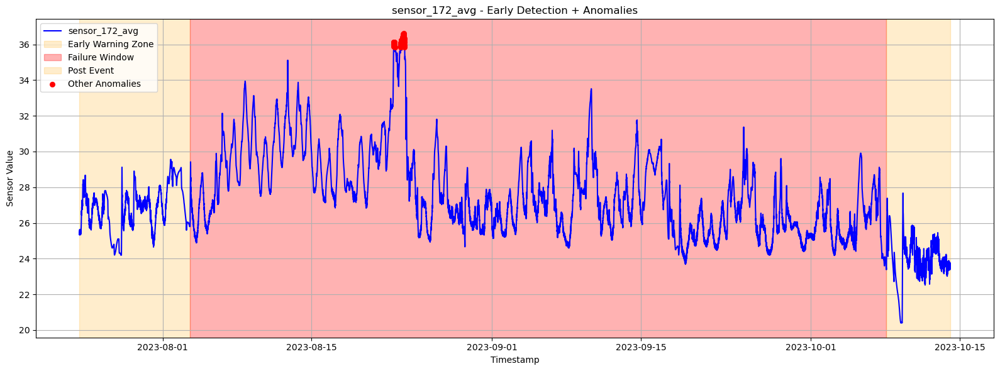

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


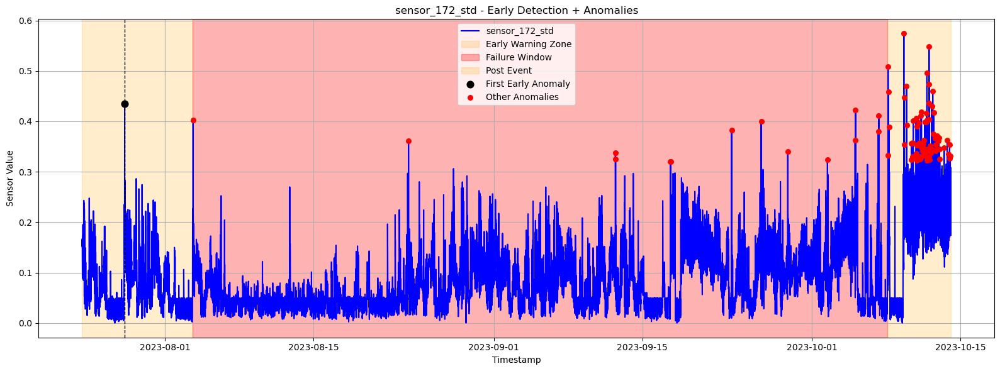

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


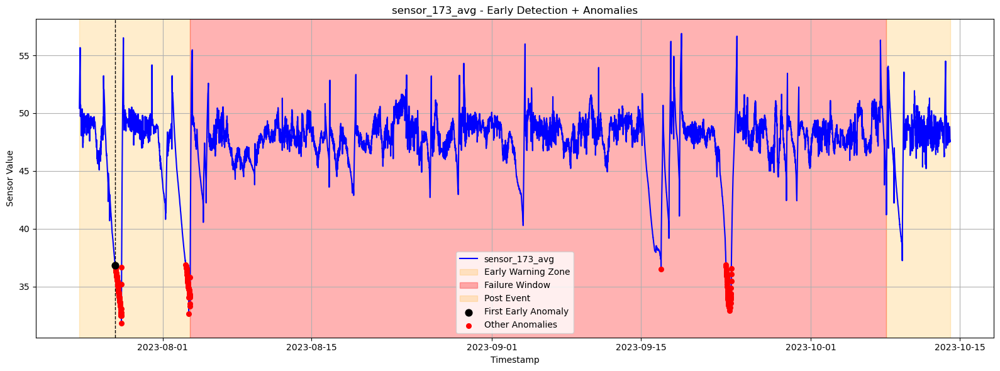

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


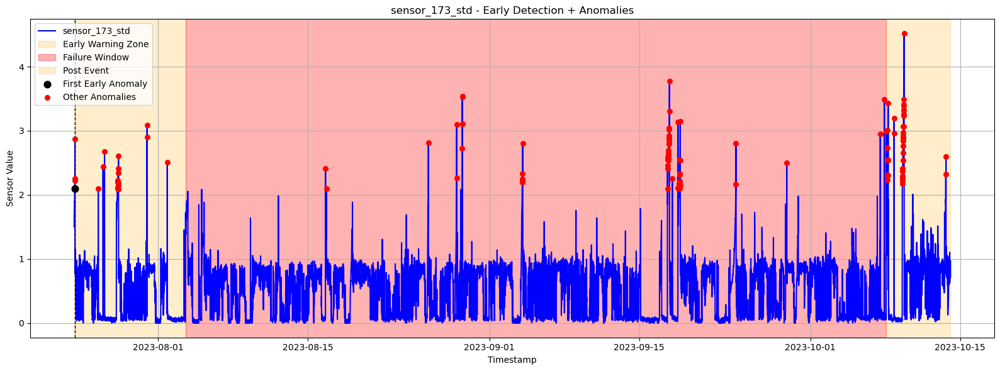

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


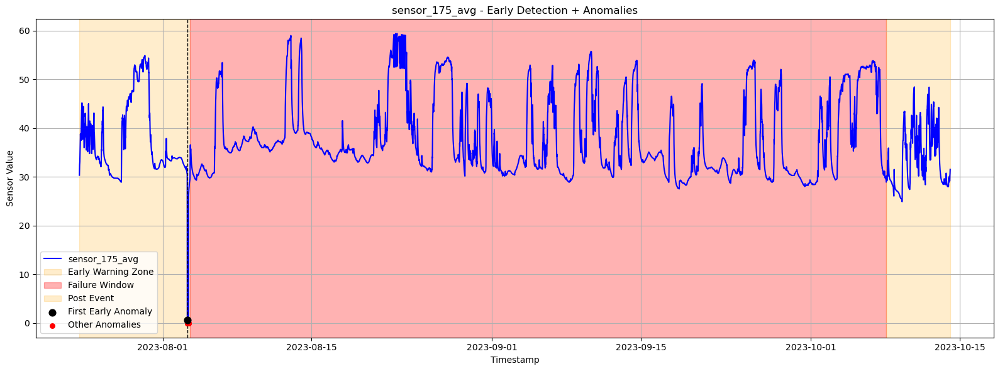

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


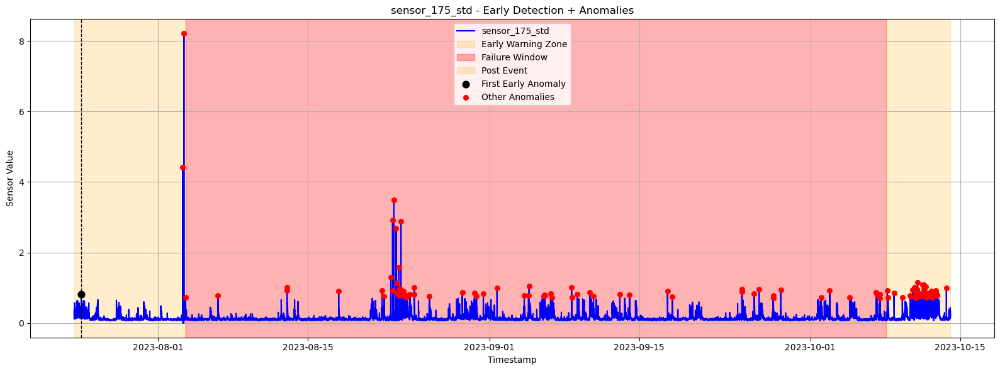

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


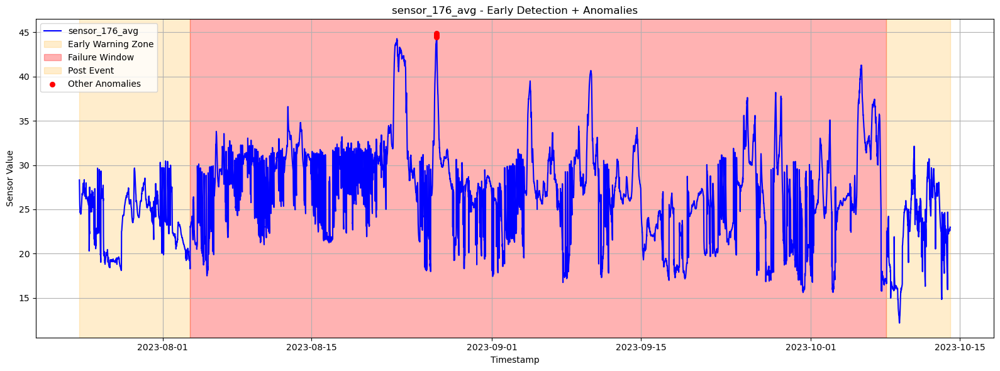

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


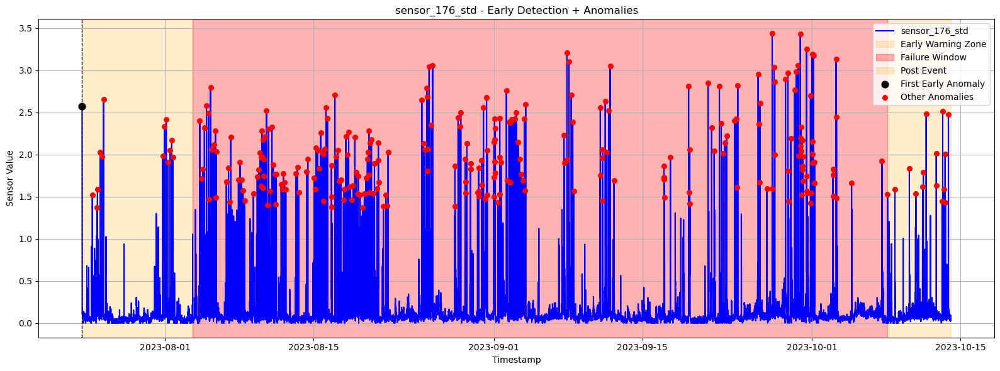

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


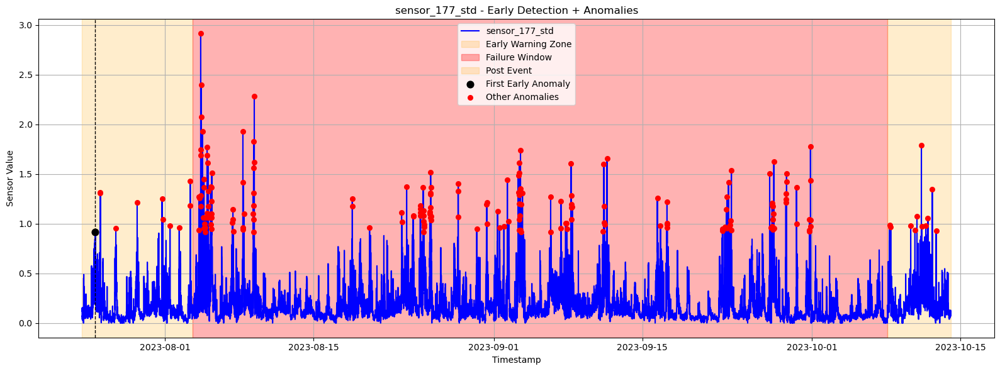

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


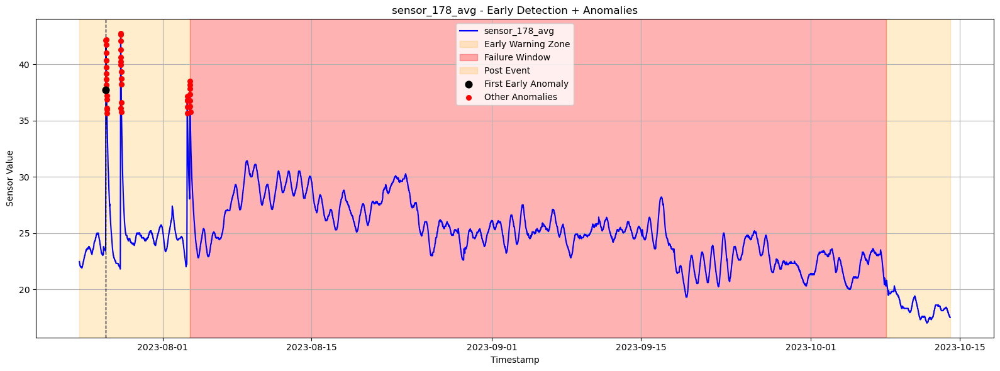

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


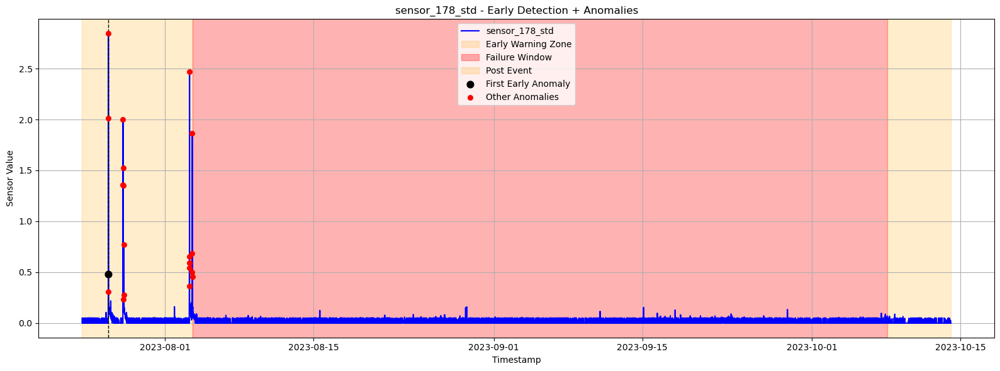

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


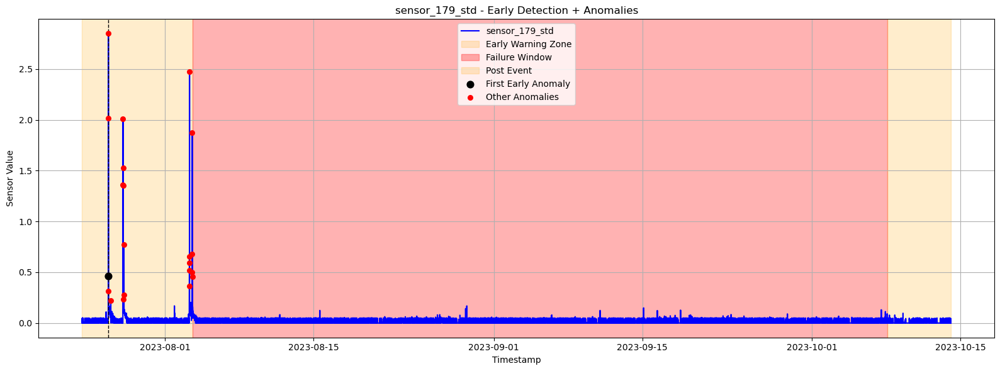

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


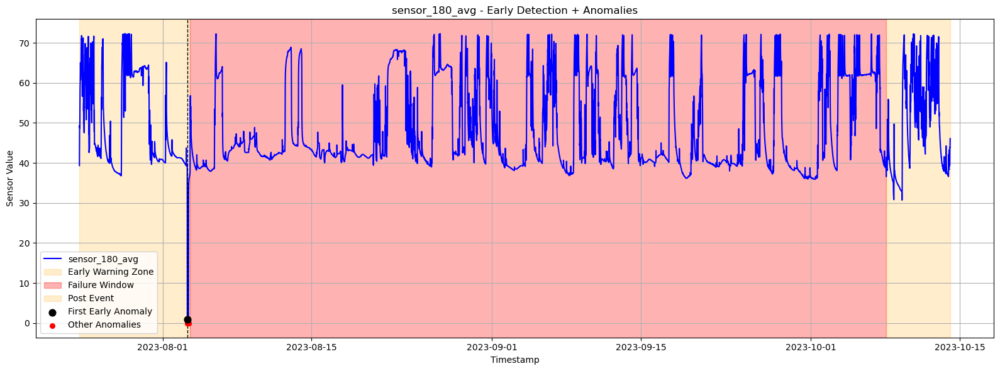

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


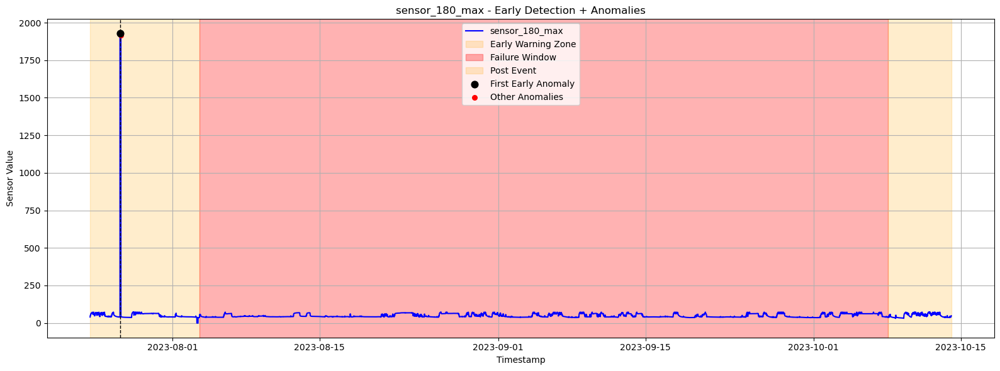

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


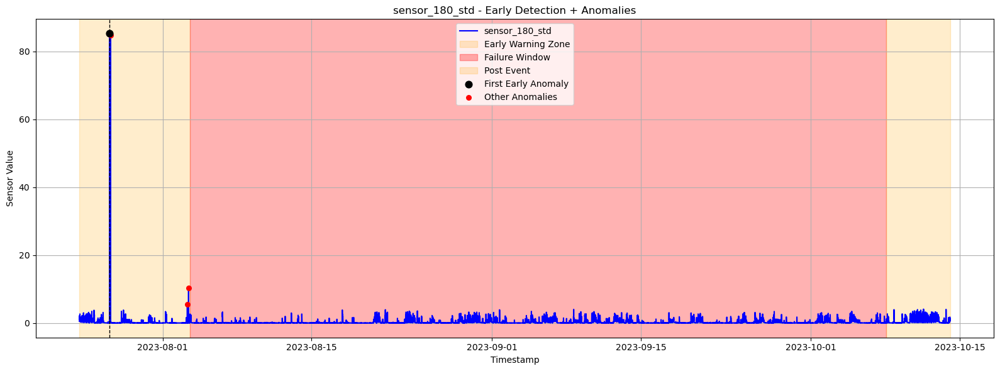

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


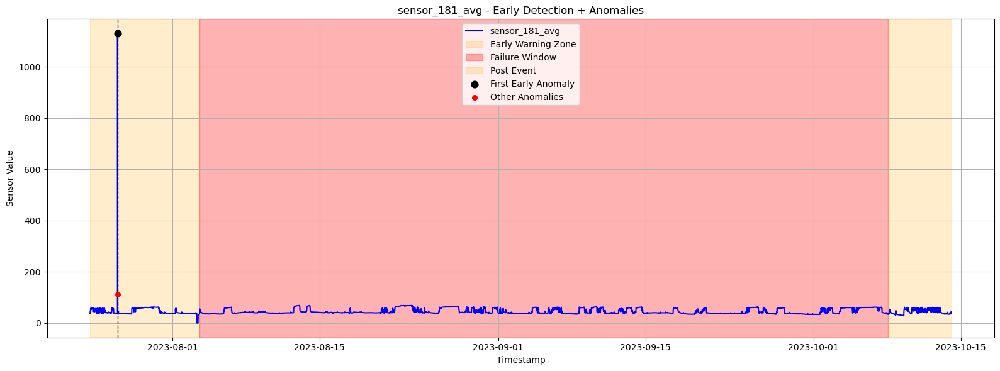

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


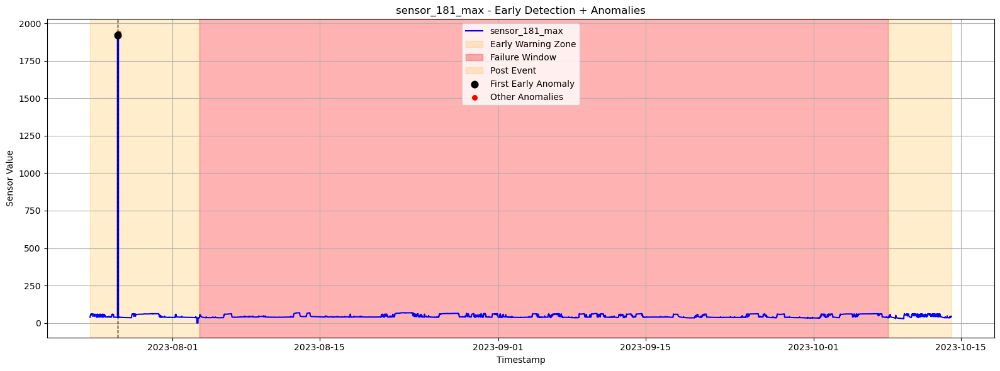

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


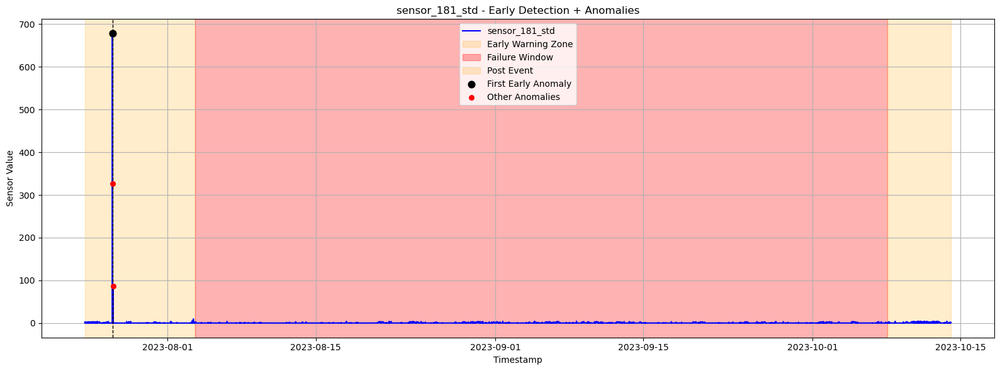

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


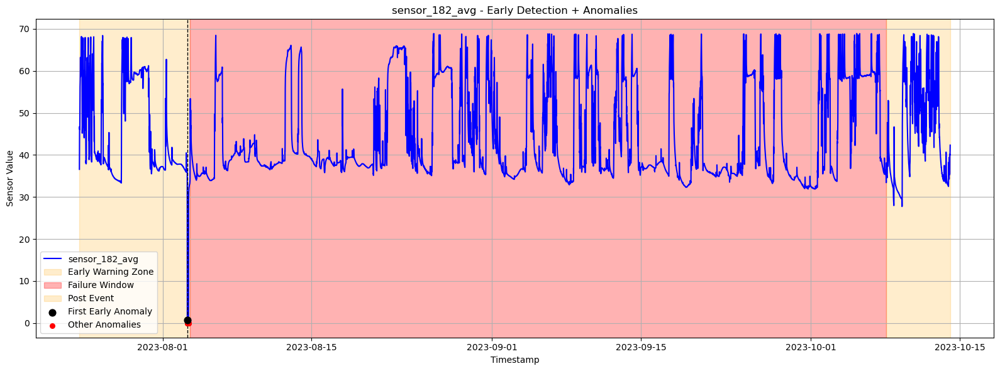

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


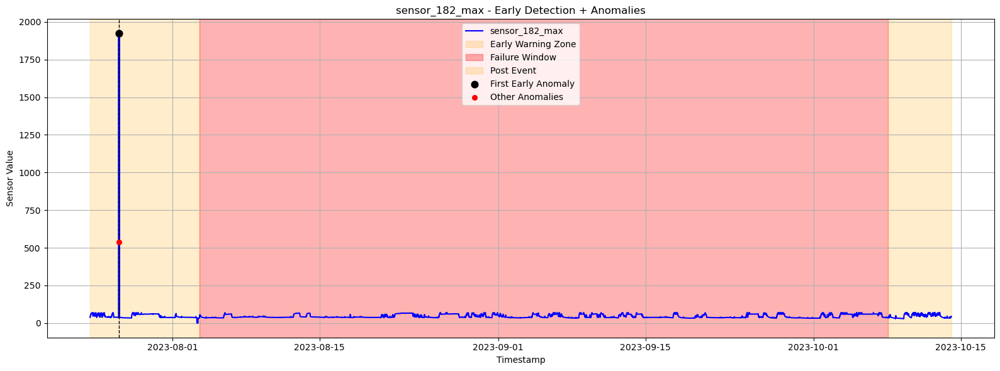

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


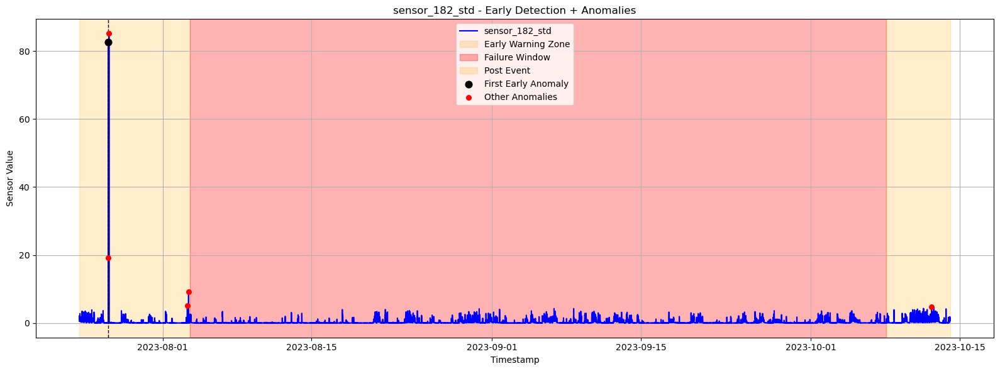

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


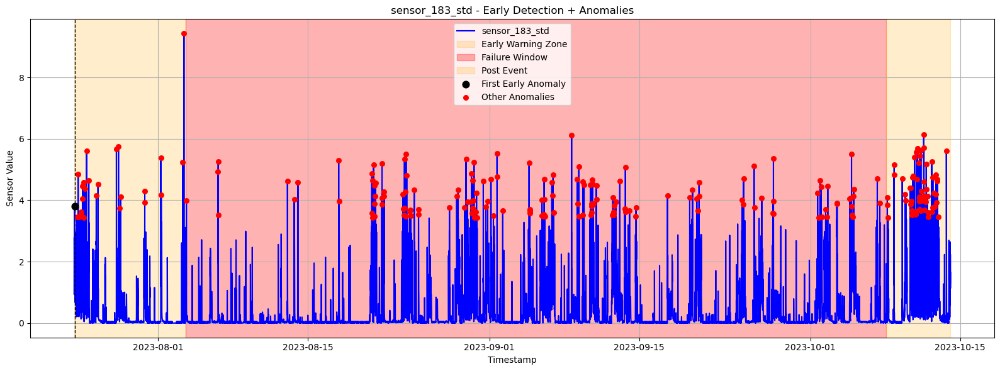

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


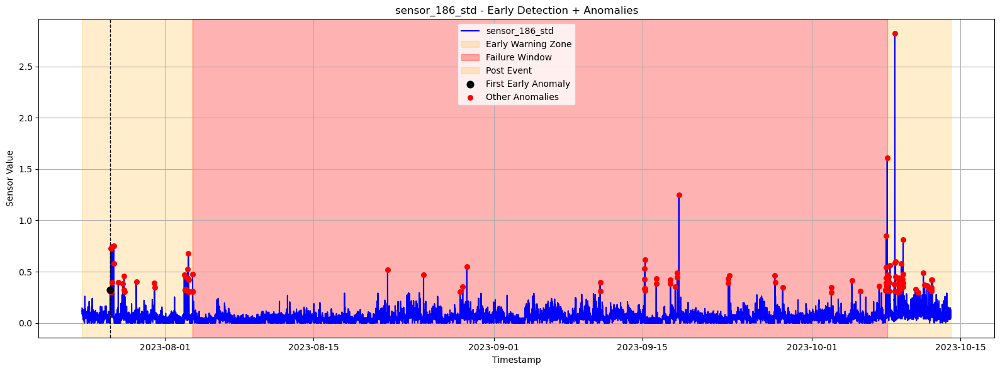

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


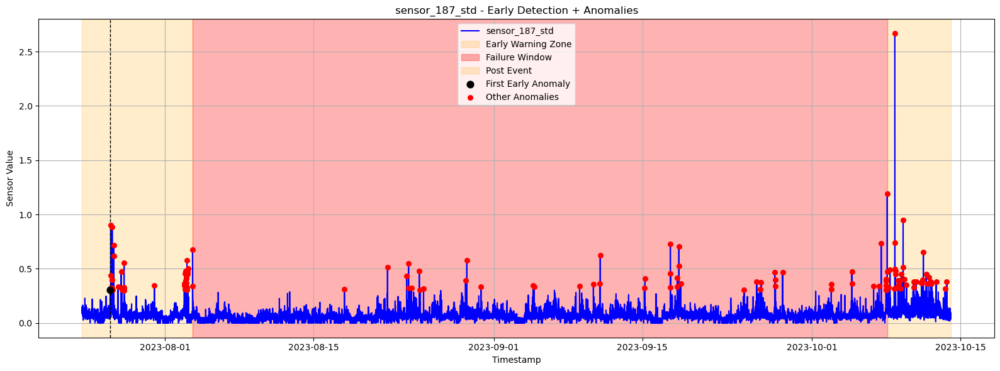

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


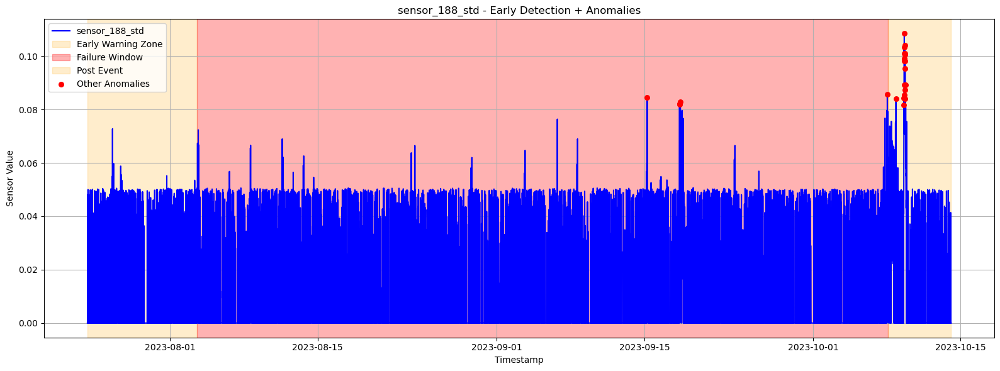

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


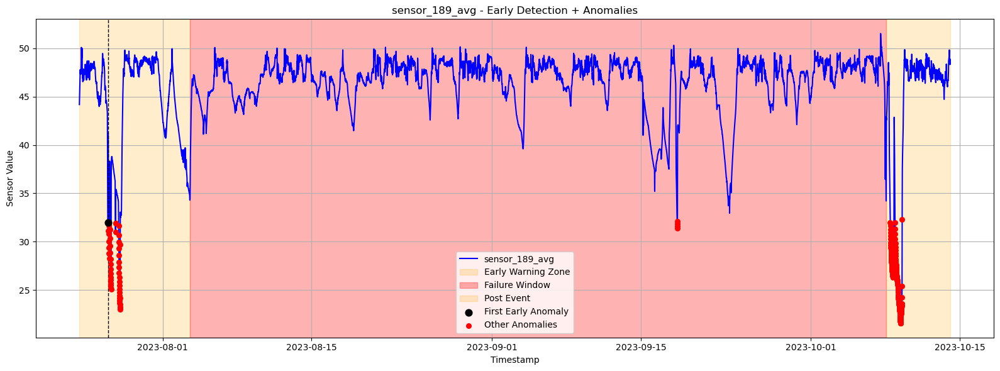

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


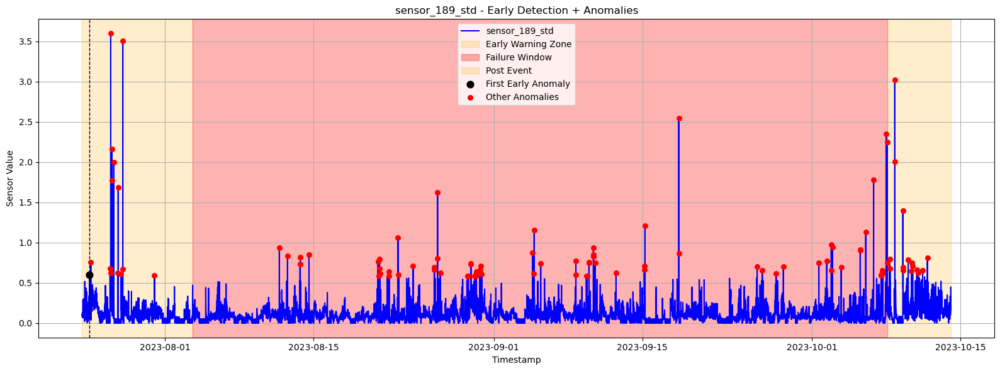

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


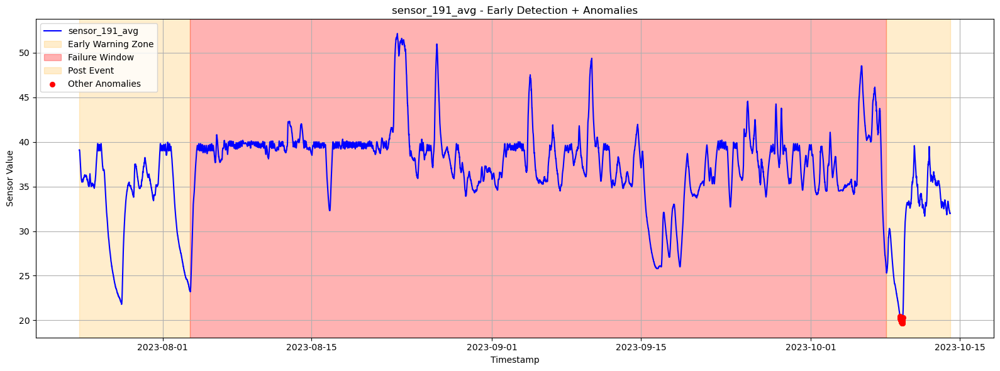

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


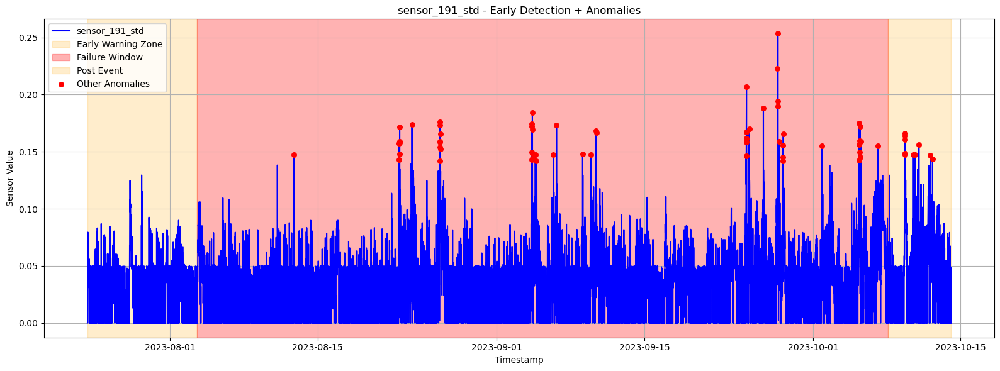

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


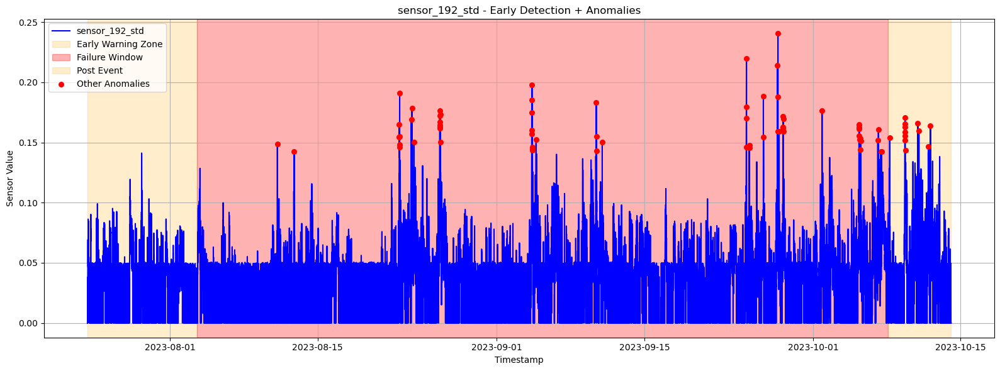

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


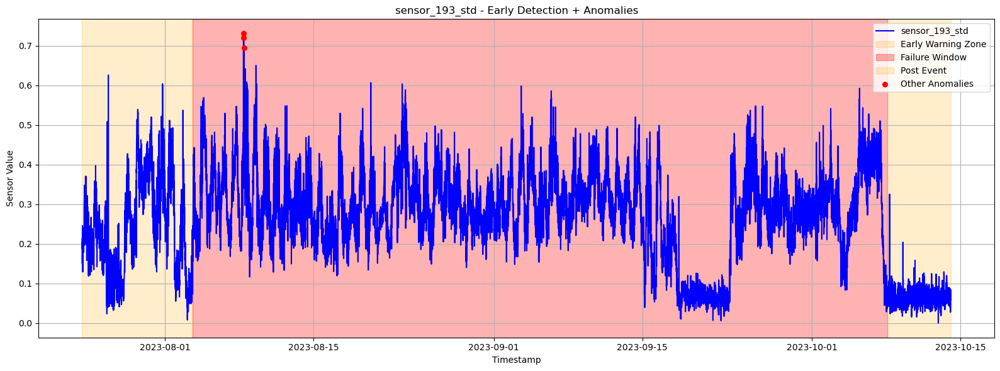

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


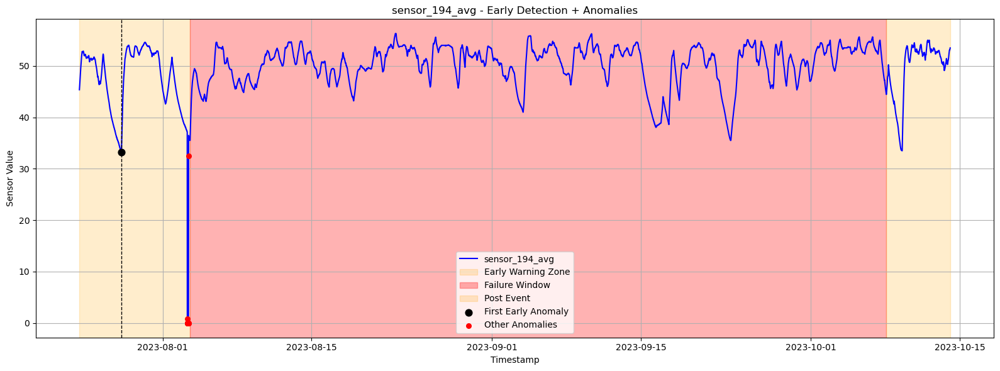

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


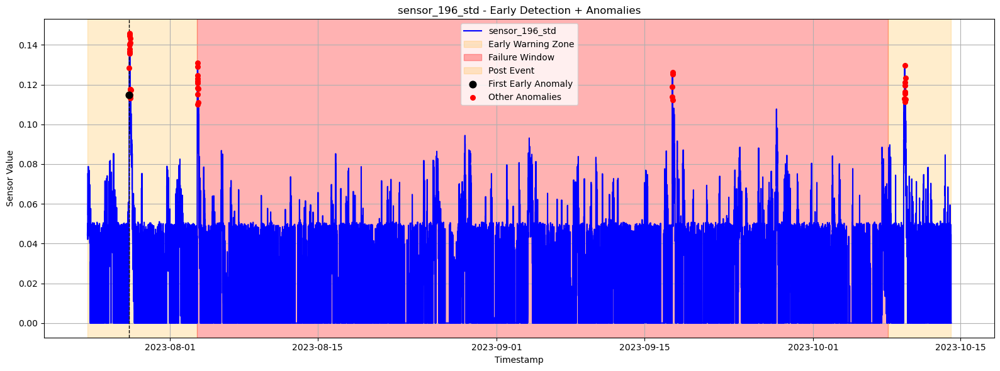

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


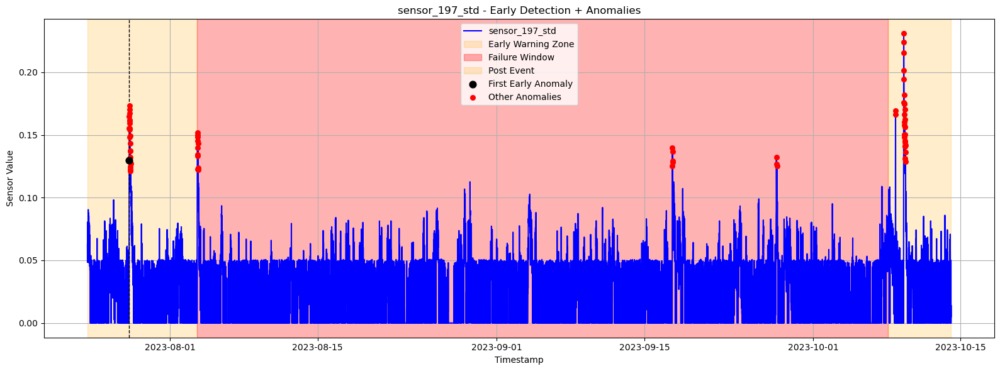

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


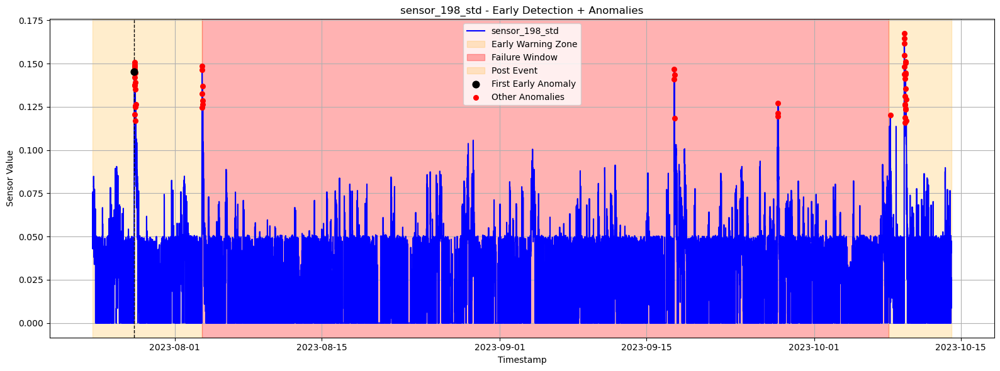

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


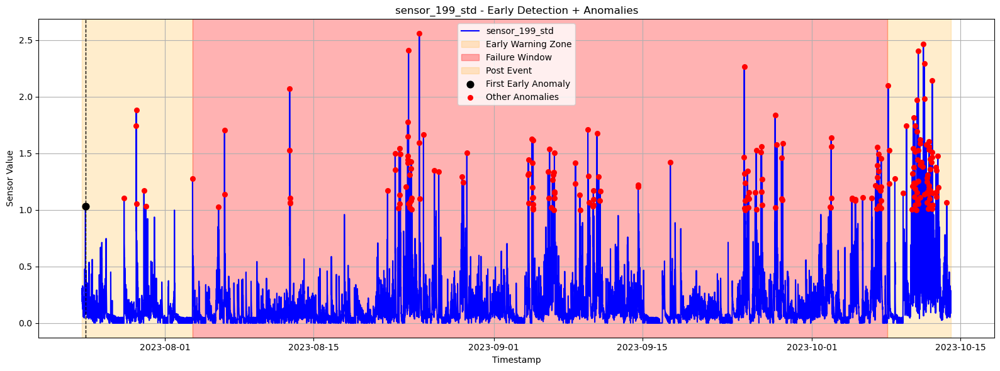

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


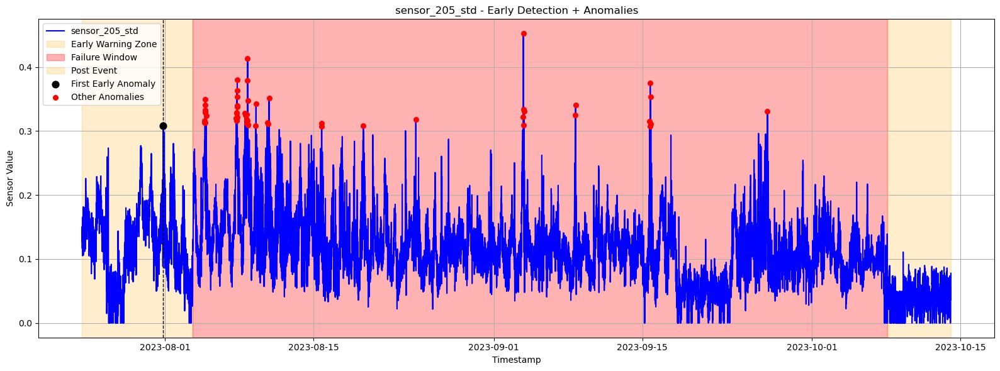

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


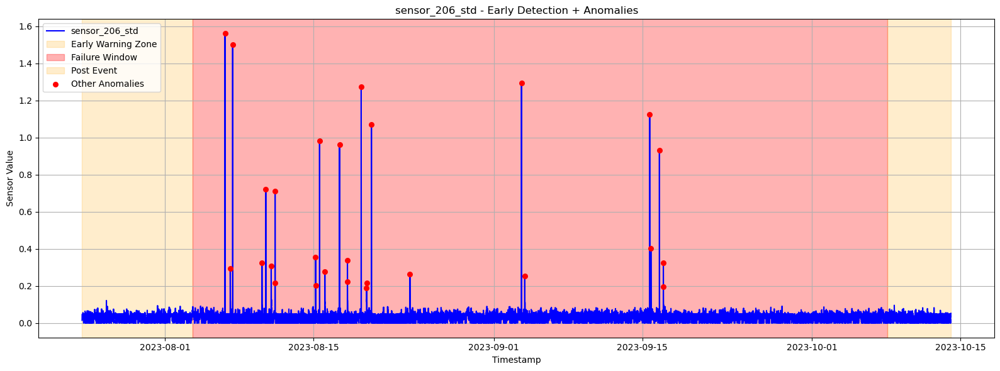

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


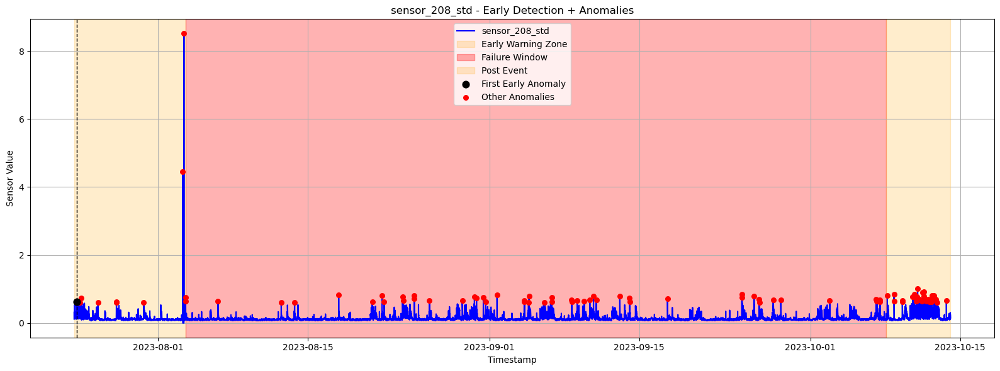

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


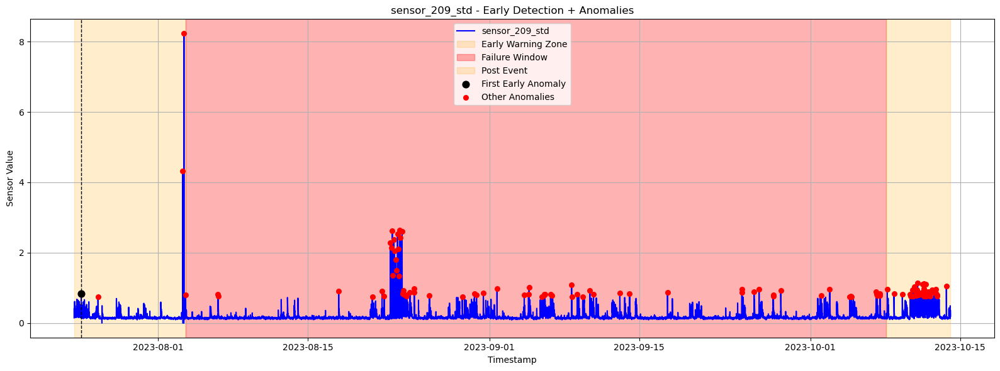

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


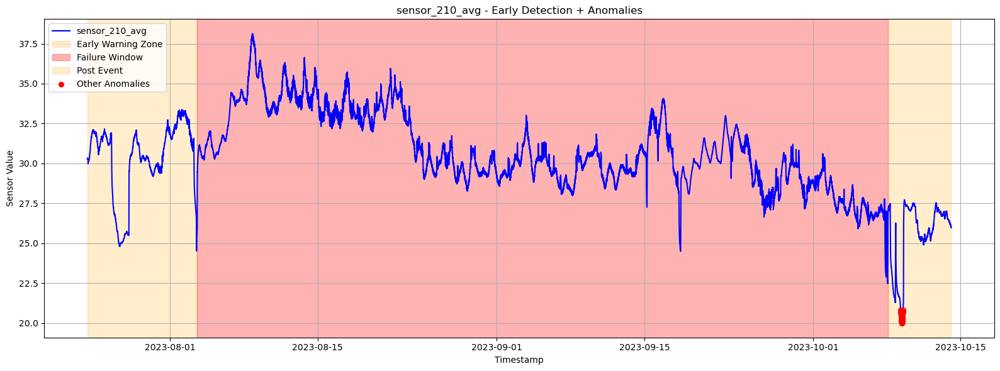

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


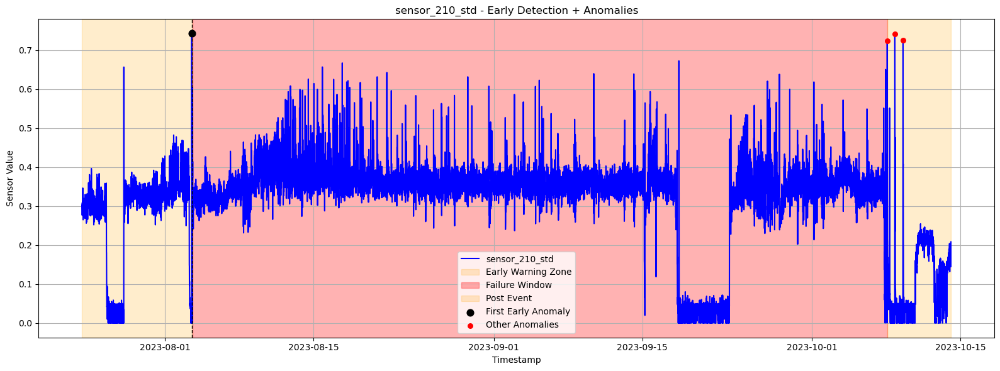

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


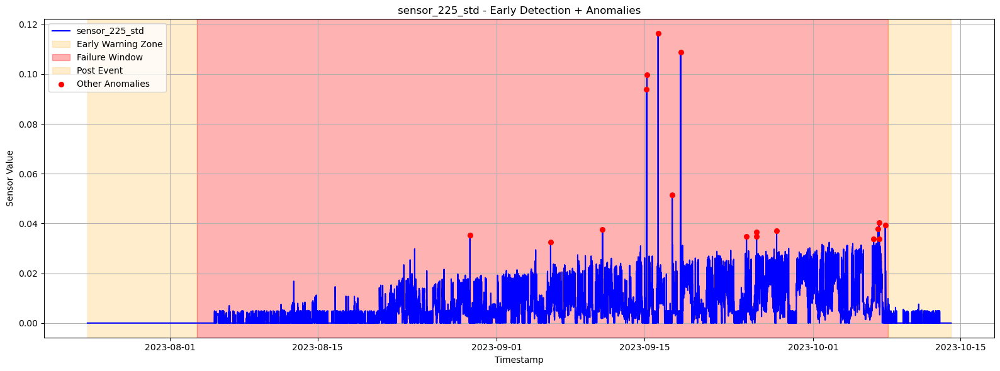

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


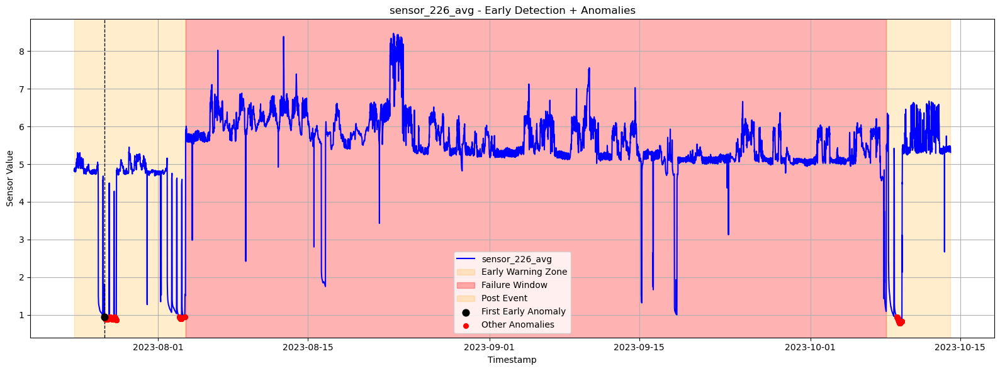

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


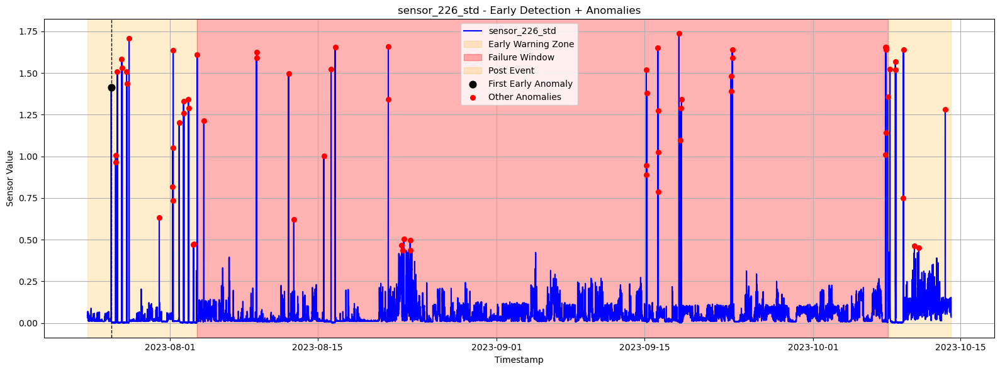

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


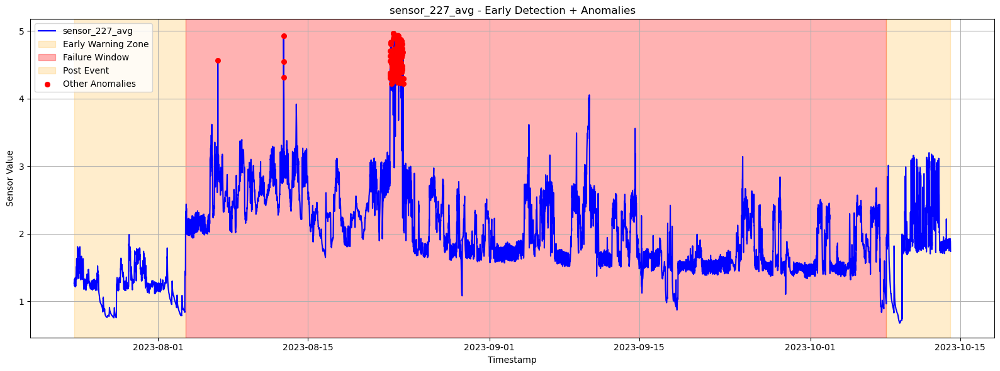

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


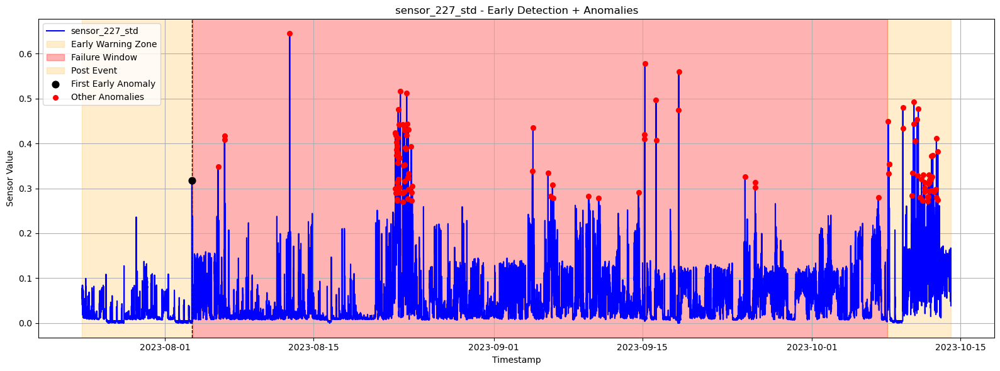

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


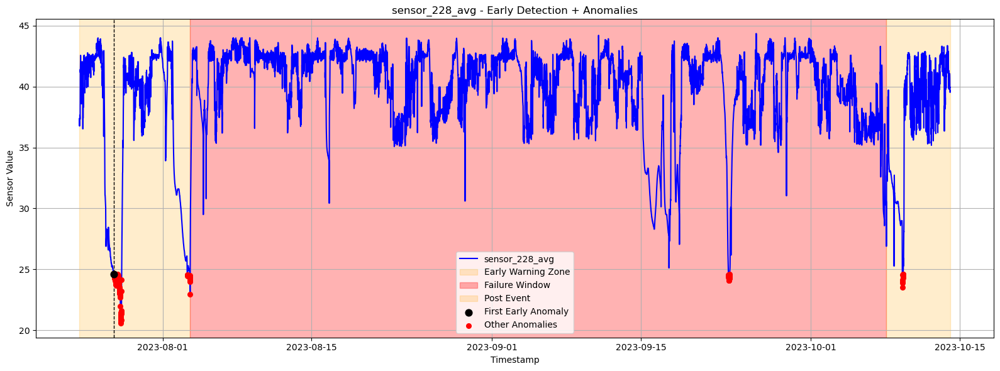

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


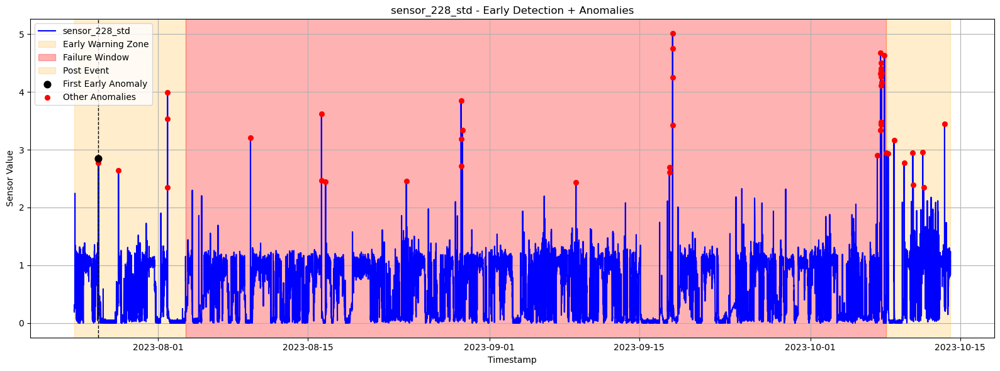

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


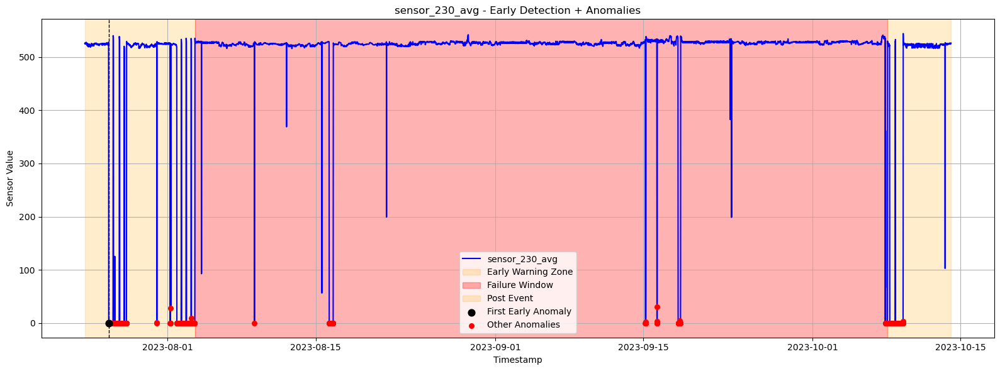

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


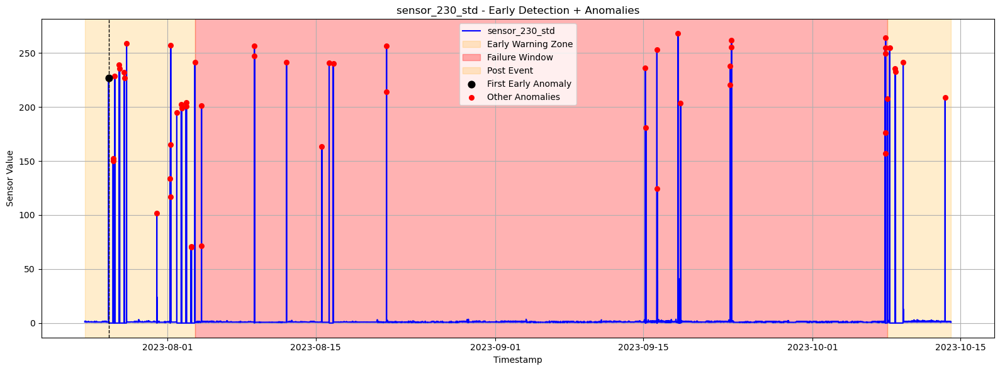

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


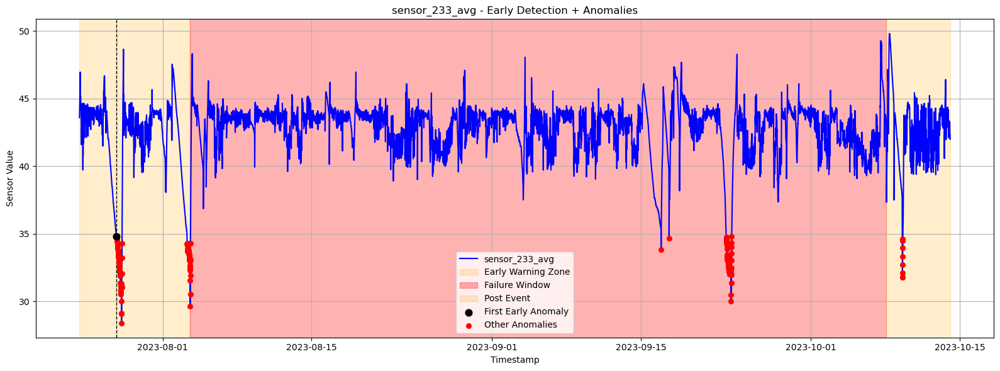

/tmp/ipykernel_14902/1940746943.py:72: FutureWarning: Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  y = df_window[feature].fillna(method='ffill').fillna(method='bfill')


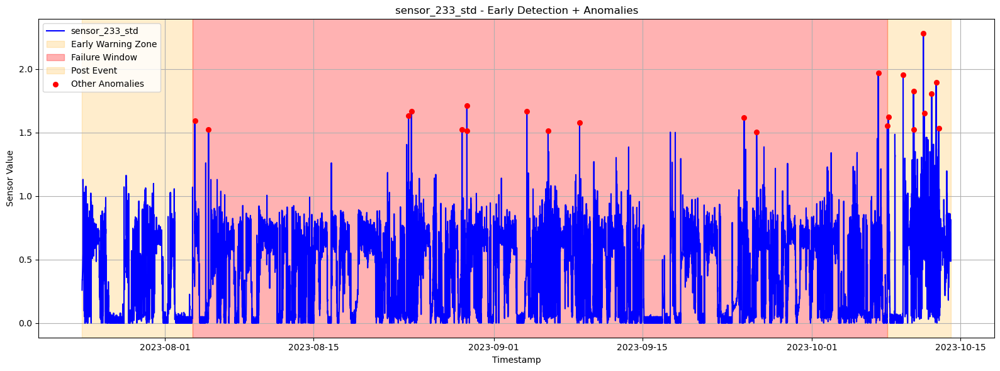

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import zscore

# === Load turbine data ===
df = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv', sep=';')
df.columns = df.columns.str.strip()
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# === Load event info ===
event_info = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/event_info.csv', sep=';')
event_info.columns = event_info.columns.str.strip().str.lower()
events_44 = event_info[event_info['asset_id'] == 44].sort_values(by='event_start')

# === Select first failure event ===
first_event = events_44.iloc[0]
event_start_id = int(first_event['event_start_id'])
event_end_id = int(first_event['event_end_id'])

# === Define buffer zone ===
buffer = 1500
start_idx = max(0, event_start_id - buffer)
end_idx = min(len(df) - 1, event_end_id + buffer)
df_window = df.iloc[start_idx:end_idx + 1].copy()

# === Define timestamps ===
event_start_time = df.iloc[event_start_id]['time_stamp']
event_end_time = df.iloc[event_end_id]['time_stamp']
early_zone_start = df.iloc[start_idx]['time_stamp']
late_zone_end = df.iloc[end_idx]['time_stamp']

# === Relevant features (edit if needed) ===
domain_features = [
    'sensor_7_avg', 'sensor_7_std', 'sensor_15_avg', 'sensor_15_std', 'sensor_18_avg', 'sensor_18_std',
    'sensor_23_avg', 'sensor_23_max', 'sensor_23_std', 'sensor_24_avg', 'sensor_24_max', 'sensor_24_std',
    'sensor_39_avg', 'sensor_40_avg', 'sensor_40_min', 'sensor_40_std', 'sensor_41_std', 'sensor_42_avg',
    'sensor_42_max', 'sensor_42_std', 'sensor_43_avg', 'sensor_43_max', 'sensor_43_std', 'sensor_44_avg',
    'sensor_44_min', 'sensor_44_max', 'sensor_44_std', 'sensor_45_avg', 'sensor_45_max', 'sensor_46_avg',
    'sensor_46_std', 'sensor_48_avg', 'sensor_48_min', 'sensor_48_max', 'sensor_49_avg', 'sensor_49_max',
    'sensor_51_avg', 'sensor_51_min', 'sensor_51_std', 'sensor_52_max', 'sensor_53_avg', 'sensor_53_min',
    'sensor_53_max', 'sensor_53_std', 'sensor_54_avg', 'sensor_54_min', 'sensor_54_max', 'sensor_54_std',
    'sensor_55_max', 'sensor_61_std', 'sensor_62_avg', 'sensor_62_std', 'sensor_65_avg', 'sensor_65_std',
    'sensor_74_avg', 'sensor_74_min', 'sensor_74_std', 'sensor_81_avg', 'sensor_81_max', 'sensor_82_avg',
    'sensor_82_max', 'sensor_83_avg', 'sensor_83_min', 'sensor_83_max', 'sensor_83_std', 'sensor_84_avg',
    'sensor_84_min', 'sensor_84_max', 'sensor_84_std', 'sensor_85_avg', 'sensor_85_min', 'sensor_85_max',
    'sensor_85_std', 'sensor_86_avg', 'sensor_86_min', 'sensor_86_max', 'sensor_86_std', 'sensor_87_avg',
    'sensor_87_std', 'sensor_88_avg', 'sensor_88_std', 'sensor_89_avg', 'sensor_89_max', 'sensor_89_std',
    'sensor_94_avg', 'sensor_94_std', 'sensor_106_avg', 'sensor_106_std', 'sensor_109_min', 'sensor_111_max',
    'sensor_113_max', 'sensor_115_avg', 'sensor_115_max', 'sensor_115_std', 'sensor_117_avg', 'sensor_117_std',
    'sensor_151_avg', 'sensor_151_std', 'sensor_152_std', 'sensor_153_std', 'sensor_155_std', 'sensor_157_std',
    'sensor_159_std', 'sensor_161_std', 'sensor_163_std', 'sensor_165_std', 'sensor_168_std', 'sensor_170_avg',
    'sensor_170_std', 'sensor_171_std', 'sensor_172_avg', 'sensor_172_std', 'sensor_173_avg', 'sensor_173_std',
    'sensor_175_avg', 'sensor_175_std', 'sensor_176_avg', 'sensor_176_std', 'sensor_177_std', 'sensor_178_avg',
    'sensor_178_std', 'sensor_179_std', 'sensor_180_avg', 'sensor_180_max', 'sensor_180_std', 'sensor_181_avg',
    'sensor_181_max', 'sensor_181_std', 'sensor_182_avg', 'sensor_182_max', 'sensor_182_std', 'sensor_183_std',
    'sensor_186_std', 'sensor_187_std', 'sensor_188_std', 'sensor_189_avg', 'sensor_189_std', 'sensor_191_avg',
    'sensor_191_std', 'sensor_192_std', 'sensor_193_std', 'sensor_194_avg', 'sensor_196_std', 'sensor_197_std',
    'sensor_198_std', 'sensor_199_avg', 'sensor_199_std', 'sensor_205_std', 'sensor_206_std', 'sensor_208_std',
    'sensor_209_std', 'sensor_210_avg', 'sensor_210_std', 'sensor_225_avg', 'sensor_225_std', 'sensor_226_avg',
    'sensor_226_std', 'sensor_227_avg', 'sensor_227_std', 'sensor_228_avg', 'sensor_228_std', 'sensor_230_avg',
    'sensor_230_std', 'sensor_233_avg', 'sensor_233_std'
    
    ['sensor_7_avg', 'sensor_7_std', 'sensor_15_avg', 'sensor_15_std', 'sensor_18_avg', 'sensor_18_std', 'sensor_23_avg', 'sensor_23_max', 'sensor_23_std', 'sensor_24_avg', 'sensor_24_max', 'sensor_24_std', 'sensor_39_avg', 'sensor_40_avg', 'sensor_40_min', 'sensor_40_std', 'sensor_41_std', 'sensor_42_avg', 'sensor_42_max', 'sensor_42_std', 'sensor_43_avg', 'sensor_43_max', 'sensor_43_std', 'sensor_44_avg', 'sensor_44_min', 'sensor_44_max', 'sensor_44_std', 'sensor_45_avg', 'sensor_45_max', 'sensor_46_avg', 'sensor_46_std', 'sensor_48_avg', 'sensor_48_min', 'sensor_48_max', 'sensor_49_avg', 'sensor_49_max', 'sensor_51_avg', 'sensor_51_min', 'sensor_51_std', 'sensor_52_max', 'sensor_53_avg', 'sensor_53_min', 'sensor_53_max', 'sensor_53_std', 'sensor_54_avg', 'sensor_54_min', 'sensor_54_max', 'sensor_54_std', 'sensor_55_max', 'sensor_61_std', 'sensor_62_avg', 'sensor_62_std', 'sensor_65_avg', 'sensor_65_std', 'sensor_74_avg', 'sensor_74_min', 'sensor_74_std', 'sensor_81_avg', 'sensor_81_max', 'sensor_82_avg', 'sensor_82_max', 'sensor_83_avg', 'sensor_83_min', 'sensor_83_max', 'sensor_83_std', 'sensor_84_avg', 'sensor_84_min', 'sensor_84_max', 'sensor_84_std', 'sensor_85_avg', 'sensor_85_min', 'sensor_85_max', 'sensor_85_std', 'sensor_86_avg', 'sensor_86_min', 'sensor_86_max', 'sensor_86_std', 'sensor_87_avg', 'sensor_87_std', 'sensor_88_avg', 'sensor_88_std', 'sensor_89_avg', 'sensor_89_max', 'sensor_89_std', 'sensor_94_avg', 'sensor_94_std', 'sensor_106_avg', 'sensor_106_std', 'sensor_109_min', 'sensor_111_max', 'sensor_113_max', 'sensor_115_avg', 'sensor_115_max', 'sensor_115_std', 'sensor_117_avg', 'sensor_117_std', 'sensor_151_avg', 'sensor_151_std', 'sensor_152_std', 'sensor_153_std', 'sensor_155_std', 'sensor_157_std', 'sensor_159_std', 'sensor_161_std', 'sensor_163_std', 'sensor_165_std', 'sensor_168_std', 'sensor_170_avg', 'sensor_170_std', 'sensor_171_std', 'sensor_172_avg', 'sensor_172_std', 'sensor_173_avg', 'sensor_173_std', 'sensor_175_avg', 'sensor_175_std', 'sensor_176_avg', 'sensor_176_std', 'sensor_177_std', 'sensor_178_avg', 'sensor_178_std', 'sensor_179_std', 'sensor_180_avg', 'sensor_180_max', 'sensor_180_std', 'sensor_181_avg', 'sensor_181_max', 'sensor_181_std', 'sensor_182_avg', 'sensor_182_max', 'sensor_182_std', 'sensor_183_std', 'sensor_186_std', 'sensor_187_std', 'sensor_188_std', 'sensor_189_avg', 'sensor_189_std', 'sensor_191_avg', 'sensor_191_std', 'sensor_192_std', 'sensor_193_std', 'sensor_194_avg', 'sensor_196_std', 'sensor_197_std', 'sensor_198_std', 'sensor_199_avg', 'sensor_199_std', 'sensor_205_std', 'sensor_206_std', 'sensor_208_std', 'sensor_209_std', 'sensor_210_avg', 'sensor_210_std', 'sensor_225_avg', 'sensor_225_std', 'sensor_226_avg', 'sensor_226_std', 'sensor_227_avg', 'sensor_227_std', 'sensor_228_avg', 'sensor_228_std', 'sensor_230_avg', 'sensor_230_std', 'sensor_233_avg', 'sensor_233_std']
]

# === Plot each sensor and classify anomaly zones ===
for feature in domain_features:
    if feature not in df_window.columns:
        print(f"Feature {feature} not found, skipping...")
        continue

    # Prepare signal and calculate Z-score anomalies
    y = df_window[feature].fillna(method='ffill').fillna(method='bfill')
    z_scores = np.abs(zscore(y))
    anomaly_flags = z_scores > 3.5
    anomaly_times = df_window['time_stamp'][anomaly_flags]
    anomaly_values = y[anomaly_flags]

    if len(anomaly_times) == 0:
        continue

    # Identify the first early anomaly (before the event)
    early_anomaly_idx = (anomaly_times < event_start_time)
    first_early_anomaly_time = None
    first_early_anomaly_value = None

    if early_anomaly_idx.any():
        first_early_anomaly_time = anomaly_times[early_anomaly_idx].iloc[0]
        first_early_anomaly_value = anomaly_values[early_anomaly_idx].iloc[0]

    # Other anomalies (excluding the first early one)
    all_anomaly_times = anomaly_times.copy()
    all_anomaly_values = anomaly_values.copy()

    if first_early_anomaly_time is not None:
        mask = anomaly_times != first_early_anomaly_time
        all_anomaly_times = anomaly_times[mask]
        all_anomaly_values = anomaly_values[mask]

    # === Plot ===
    plt.figure(figsize=(16, 6))
    plt.plot(df_window['time_stamp'], y, label=feature, color='blue')

    # Highlight event zones
    plt.axvspan(early_zone_start, event_start_time, color='orange', alpha=0.2, label='Early Warning Zone')
    plt.axvspan(event_start_time, event_end_time, color='red', alpha=0.3, label='Failure Window')
    plt.axvspan(event_end_time, late_zone_end, color='orange', alpha=0.2, label='Post Event')

    # Plot early anomaly point
    if first_early_anomaly_time:
        plt.scatter(first_early_anomaly_time, first_early_anomaly_value, color='black', s=60, label='First Early Anomaly', zorder=5)
        plt.axvline(x=first_early_anomaly_time, color='black', linestyle='--', linewidth=1)

    # Plot remaining anomalies
    plt.scatter(all_anomaly_times, all_anomaly_values, color='red', s=30, label='Other Anomalies', zorder=4)

    plt.title(f"{feature} - Early Detection + Anomalies")
    plt.xlabel("Timestamp")
    plt.ylabel("Sensor Value")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# WP 2: Supervised Learning
This notebook implements supervised learning for early failure prediction in wind turbines using domain-selected sensor features. We:

- Label data with early warnings before failures
- Train a classifier to detect early warnings
- Evaluate performance with recall, precision, ROC-AUC
- Analyze lead times and false alarms


In [19]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, precision_recall_curve, auc
from sklearn.preprocessing import StandardScaler
from datetime import timedelta

# Parameters
window_hours = 6  # Early warning window (can tune later)
window_size = pd.Timedelta(hours=window_hours)

# Load Data
df = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv', sep=';')
df.columns = df.columns.str.strip()
df['time_stamp'] = pd.to_datetime(df['time_stamp'])

# Load event info for turbine 44
df_events = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/event_info.csv', sep=';')
df_events.columns = df_events.columns.str.strip().str.lower()
events_44 = df_events[df_events['asset_id'] == 44]


### lebeling

In [20]:
df['label'] = 0  # 0 = normal
for _, row in events_44.iterrows():
    start_idx = row['event_start_id']
    end_idx = row['event_end_id']
    
    failure_time = df.loc[end_idx, 'time_stamp']
    early_window_start = failure_time - window_size
    
    df.loc[(df['time_stamp'] >= early_window_start) & (df['time_stamp'] < failure_time), 'label'] = 1  # early warning
    df.loc[(df['time_stamp'] >= failure_time) & (df.index <= end_idx), 'label'] = 2  # during failure

# Target: 1 = early warning, 0 = normal
df['target'] = (df['label'] == 1).astype(int)


### Feature Preparation

In [21]:
# Domain-relevant features
domain_features = [  # you can paste your full list of 165 here or just top 30
    
    'sensor_230_avg', 'sensor_117_avg', 'sensor_42_avg', 'sensor_226_avg', 'sensor_74_min',
    'sensor_42_max', 'sensor_74_avg', 'sensor_230_std', 'sensor_226_std', 'sensor_46_avg',
    'sensor_18_avg', 'sensor_227_std', 'sensor_117_std', 'sensor_43_avg', 'sensor_43_std',
    'sensor_55_max', 'sensor_42_std', 'sensor_54_avg', 'sensor_43_max', 'sensor_94_avg',
    'sensor_94_std', 'sensor_54_min', 'sensor_189_avg', 'sensor_191_avg', 'sensor_168_std',
    'sensor_194_avg', 'sensor_46_std', 'sensor_228_avg', 'sensor_227_avg', 'sensor_182_std'
]

features = [f for f in domain_features if f in df.columns]
X = df[features].fillna(0)
y = df['target']


### Time-Based Train/Test Split

In [22]:
split_time = df['time_stamp'].quantile(0.8)
train_idx = df['time_stamp'] < split_time
test_idx = ~train_idx

X_train, X_test = X[train_idx], X[test_idx]
y_train, y_test = y[train_idx], y[test_idx]

# Scale
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [23]:
# Separate positive and negative samples
df_pos = df[df['target'] == 1]
df_neg = df[df['target'] == 0]

# Sample equal number of normal points (or more) from before split_time
split_time = df['time_stamp'].quantile(0.8)
df_neg_train = df_neg[df_neg['time_stamp'] < split_time].sample(len(df_pos) * 5, random_state=42)
df_train = pd.concat([df_pos, df_neg_train])

# Use remaining time-based data as test
df_test = df[df['time_stamp'] >= split_time]

# Features and target
X_train = df_train[features].fillna(0)
y_train = df_train['target']
X_test = df_test[features].fillna(0)
y_test = df_test['target']

# Scale
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)


In [25]:
clf = RandomForestClassifier(n_estimators=100, class_weight='balanced', random_state=42)
clf.fit(X_train_scaled, y_train)

y_pred = clf.predict(X_test_scaled)
y_proba = clf.predict_proba(X_test_scaled)[:, 1]  # Now this won't fail


### Model Training

Confusion Matrix:
[[11141  1388]
 [    0    72]]

Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.89      0.94     12529
           1       0.05      1.00      0.09        72

    accuracy                           0.89     12601
   macro avg       0.52      0.94      0.52     12601
weighted avg       0.99      0.89      0.94     12601


ROC-AUC: 0.9986320625038799


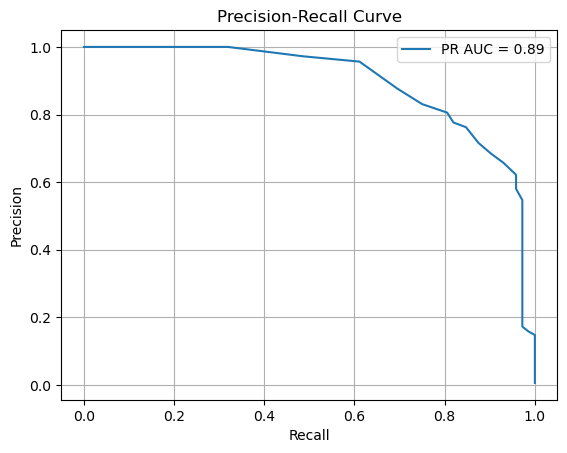

In [26]:
print("Confusion Matrix:")
print(confusion_matrix(y_test, y_pred))

print("\nClassification Report:")
print(classification_report(y_test, y_pred))

print("\nROC-AUC:", roc_auc_score(y_test, y_proba))

# Precision-Recall Curve
precision, recall, thresholds = precision_recall_curve(y_test, y_proba)
pr_auc = auc(recall, precision)

plt.plot(recall, precision, label=f'PR AUC = {pr_auc:.2f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.grid(True)
plt.legend()
plt.show()


### Confusion matrix

Confusion Matrix:
[[11141  1388]
 [    0    72]]


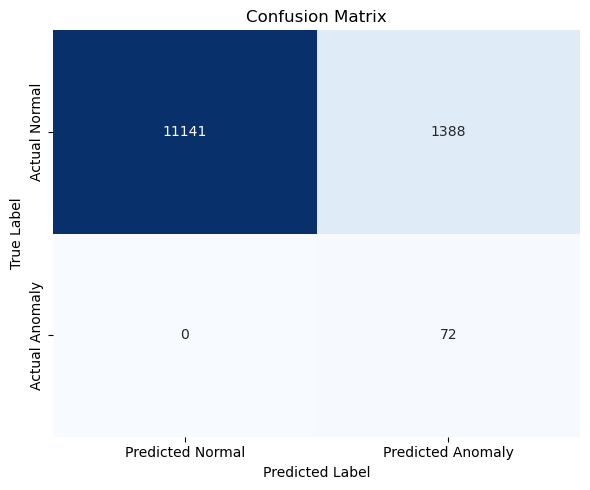


Classification Report:
              precision    recall  f1-score   support

           0       1.00      0.89      0.94     12529
           1       0.05      1.00      0.09        72

    accuracy                           0.89     12601
   macro avg       0.52      0.94      0.52     12601
weighted avg       0.99      0.89      0.94     12601


ROC-AUC: 0.9986320625038799


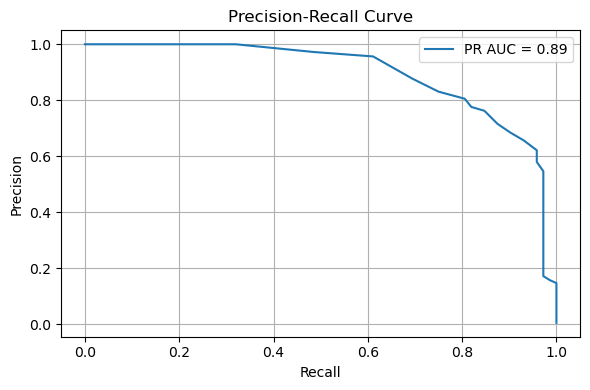

In [ ]:
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, precision_recall_curve, auc
import seaborn as sns
import matplotlib.pyplot as plt

#  Confusion Matrix (Numerical) 
cm = confusion_matrix(y_test, y_pred)
print("Confusion Matrix:")
print(cm)

#  Visualized Confusion Matrix 
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['Predicted Normal', 'Predicted Anomaly'],
            yticklabels=['Actual Normal', 'Actual Anomaly'])
plt.title("Confusion Matrix")
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.tight_layout()
plt.show()

#  Classification Report 
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

#  ROC-AUC Score 
print("\nROC-AUC:", roc_auc_score(y_test, y_proba))

#  Precision-Recall Curve 
precision, recall, thresholds = precision_recall_curve(y_test, y_proba)
pr_auc = auc(recall, precision)

plt.figure(figsize=(6, 4))
plt.plot(recall, precision, label=f'PR AUC = {pr_auc:.2f}')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


## predicts all the failure events dataset as early in advance as possible

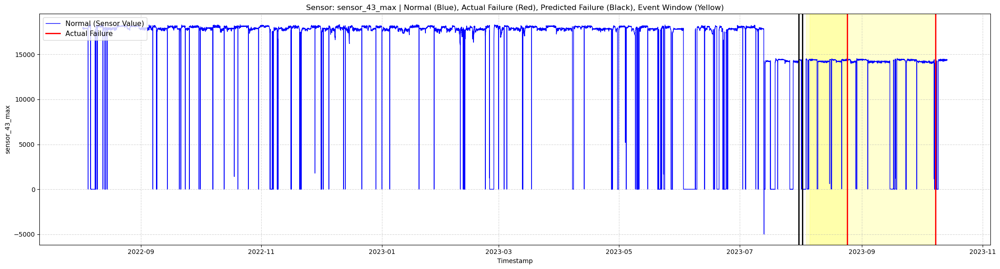

In [ ]:
import matplotlib.pyplot as plt

sensor_to_plot = 'sensor_43_max'  # Change to any sensor you want

plt.figure(figsize=(22, 6))

# Plot sensor value (normal in blue)
plt.plot(df['time_stamp'], df[sensor_to_plot], color='blue', label='Normal (Sensor Value)', linewidth=1)

# Mark event windows (yellow)
for i, event in events_44.iterrows():
    event_start = df.loc[event['event_start_id'], 'time_stamp']
    event_end = df.loc[event['event_end_id'], 'time_stamp']
    plt.axvspan(event_start, event_end, color='yellow', alpha=0.18, label='Event Window' if i == 0 else "")

# Mark actual failure points (label==2) as red vertical lines
actual_failure_times = df[df['label'] == 2]['time_stamp']
for i, t in enumerate(actual_failure_times):
    plt.axvline(t, color='red', linestyle='-', linewidth=2, label='Actual Failure' if i == 0 else "")

# Mark predicted failure (first early warning before each event) as black vertical line
for i, event in events_44.iterrows():
    event_start = df.loc[event['event_start_id'], 'time_stamp']
    event_end = df.loc[event['event_end_id'], 'time_stamp']
    early_pred_mask = (df['y_pred'] == 1) & (df['time_stamp'] < event_end)
    early_pred_times = df.loc[early_pred_mask, 'time_stamp']
    early_pred_times = early_pred_times[early_pred_times >= event_start - pd.Timedelta(hours=96)]
    if not early_pred_times.empty:
        first_early_pred_time = early_pred_times.iloc[0]
        plt.axvline(first_early_pred_time, color='black', linestyle='-', linewidth=2, label='Predicted Failure' if i == 0 else "")

plt.xlabel('Timestamp')
plt.ylabel(sensor_to_plot)
plt.title(f'Sensor: {sensor_to_plot} | Normal (Blue), Actual Failure (Red), Predicted Failure (Black), Event Window (Yellow)')
plt.legend(loc='upper left', fontsize=11)
plt.grid(True, linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

# reference : https://chat.openai.com/

## checking the Early prediction for actual failure with false alarm

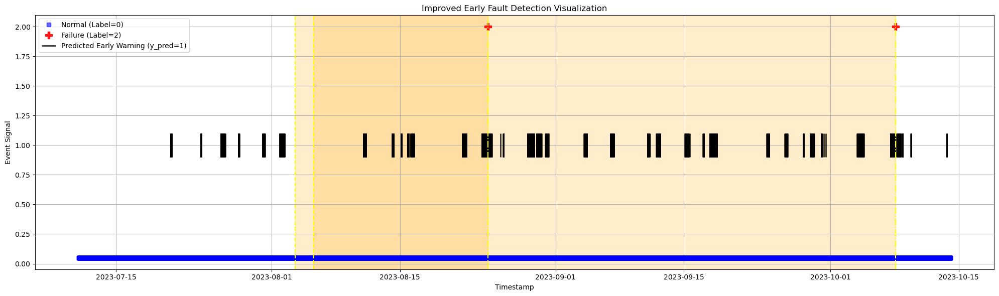

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Time window size
pre_days = pd.Timedelta(days=10)
post_days = pd.Timedelta(days=20)

# Get window around first prediction
early_pred_indices = df[df['y_pred'] == 1].index

if not early_pred_indices.empty:
    start_time = df.loc[early_pred_indices[0], 'time_stamp'] - pre_days
    end_time = df.loc[early_pred_indices[-1], 'time_stamp'] + post_days
    df_window = df[(df['time_stamp'] >= start_time) & (df['time_stamp'] <= end_time)]
else:
    print("No early warnings (y_pred=1) found.")
    df_window = df.head(0)

plt.figure(figsize=(20, 6))

#  Plot Normal as a line 
normal_mask = df_window['label'] == 0
plt.plot(df_window.loc[normal_mask, 'time_stamp'], 
         [0.05] * normal_mask.sum(), 's', 
         markersize=6, color='blue', label='Normal (Label=0)', alpha=0.6)

#  Plot Failure (Label=2) 
failure_mask = df_window['label'] == 2
plt.plot(df_window.loc[failure_mask, 'time_stamp'], 
         [2.0] * failure_mask.sum(), 'P', 
         markersize=10, color='red', label='Failure (Label=2)', alpha=0.9)

#  Plot Early Warning Predictions 
early_pred_mask = df_window['y_pred'] == 1
plt.vlines(df_window.loc[early_pred_mask, 'time_stamp'], ymin=0.9, ymax=1.1, 
           color='black', linewidth=2.0, label='Predicted Early Warning (y_pred=1)', alpha=0.8)

#  Highlight actual failure windows 
for i, event in events_44.iterrows():
    event_start = df.loc[event['event_start_id'], 'time_stamp']
    event_end = df.loc[event['event_end_id'], 'time_stamp']

    if (event_end >= start_time) and (event_start <= end_time):
        plt.axvspan(event_start, event_end, color='orange', alpha=0.2, label='Failure Window' if i == 0 else "")
        plt.axvline(event_start, color='yellow', linestyle='--', linewidth=1.5, label='Event Start' if i == 0 else "")
        plt.axvline(event_end, color='yellow', linestyle='-.', linewidth=1.5, label='Event End' if i == 0 else "")

#  Final Styling 
plt.xlabel("Timestamp")
plt.ylabel("Event Signal")
plt.title("Improved Early Fault Detection Visualization")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


### keeps false alarm rate as low as possible.

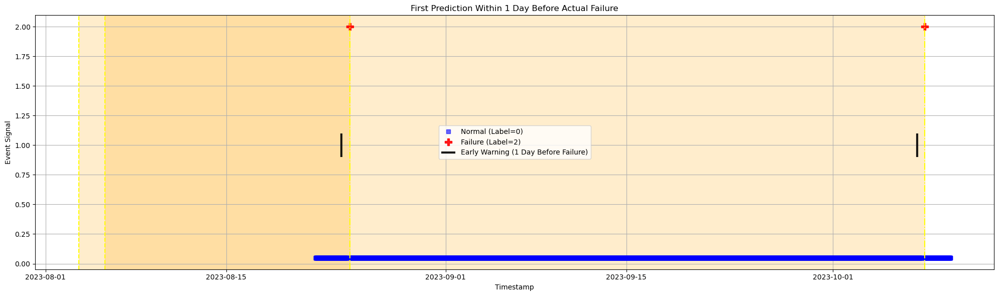

In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

# Define 1-day buffer
buffer = pd.Timedelta(days=1)

# Find actual failure times (label == 2)
failure_times = df[df['label'] == 2]['time_stamp'].tolist()

# Store valid early predictions
selected_early_preds = []

for failure_time in failure_times:
    early_start = failure_time - buffer
    early_end = failure_time

    # Get predictions in the 1-day window before failure
    valid_preds = df[(df['y_pred'] == 1) &
                     (df['time_stamp'] >= early_start) &
                     (df['time_stamp'] < early_end)].copy()

    # Pick first if any
    if not valid_preds.empty:
        first_pred_time = valid_preds.iloc[0]['time_stamp']
        selected_early_preds.append(first_pred_time)

# Define plotting range
if selected_early_preds:
    start_time = min(selected_early_preds) - pd.Timedelta(days=2)
    end_time = max(failure_times) + pd.Timedelta(days=2)
    df_window = df[(df['time_stamp'] >= start_time) & (df['time_stamp'] <= end_time)]
else:
    print("No valid early warnings found within 1-day before actual failures.")
    df_window = df.head(0)

#  Plotting 
plt.figure(figsize=(20, 6))

# Normal data
normal_mask = df_window['label'] == 0
plt.plot(df_window.loc[normal_mask, 'time_stamp'],
         [0.05] * normal_mask.sum(), 's',
         markersize=6, color='blue', label='Normal (Label=0)', alpha=0.6)

# Actual failure points
failure_mask = df_window['label'] == 2
plt.plot(df_window.loc[failure_mask, 'time_stamp'],
         [2.0] * failure_mask.sum(), 'P',
         markersize=10, color='red', label='Failure (Label=2)', alpha=0.9)

# Plot selected early warnings
for ts in selected_early_preds:
    plt.vlines(ts, ymin=0.9, ymax=1.1, color='black', linewidth=3.0,
               alpha=0.9, label='Early Warning (1 Day Before Failure)' if ts == selected_early_preds[0] else "")

# Highlight failure windows for context (optional)
for i, event in events_44.iterrows():
    event_start = df.loc[event['event_start_id'], 'time_stamp']
    event_end = df.loc[event['event_end_id'], 'time_stamp']

    if (event_end >= start_time) and (event_start <= end_time):
        plt.axvspan(event_start, event_end, color='orange', alpha=0.2, label='Failure Window' if i == 0 else "")
        plt.axvline(event_start, color='yellow', linestyle='--', linewidth=1.5, label='Event Start' if i == 0 else "")
        plt.axvline(event_end, color='yellow', linestyle='-.', linewidth=1.5, label='Event End' if i == 0 else "")

# Formatting
plt.xlabel("Timestamp")
plt.ylabel("Event Signal")
plt.title("First Prediction Within 1 Day Before Actual Failure")
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# reference: https://chat.openai.com/

### markdown the time difference between predicted failure and actual failure

In [ ]:
from datetime import timedelta

#  CONFIGURATION 
ROLLING_WINDOW = 5         # for smoothing
VOTE_THRESHOLD = 5         # how many out of 5 to confirm
DEBOUNCE_HOURS = 48        # suppress repeated predictions within this gap
EARLY_WINDOW_HOURS = 24    # match predictions within 24h before actual failure

#  STEP 1: Smooth Predictions Using Rolling Voting 
df['y_pred_smooth'] = df['y_pred'].rolling(window=ROLLING_WINDOW, min_periods=1).sum() >= VOTE_THRESHOLD
df['y_pred_smooth'] = df['y_pred_smooth'].astype(int)

#  STEP 2: Debounce Predictions 
debounced_preds = []
last_alert_time = None

for ts in df[df['y_pred_smooth'] == 1]['time_stamp']:
    if last_alert_time is None or (ts - last_alert_time) > timedelta(hours=DEBOUNCE_HOURS):
        debounced_preds.append(ts)
        last_alert_time = ts

#  STEP 3: Match Early Warnings to Actual Failures 
failure_times = df[df['label'] == 2]['time_stamp'].tolist()
matched_preds = []
early_failure_pairs = []

for failure_time in failure_times:
    early_start = failure_time - timedelta(hours=EARLY_WINDOW_HOURS)
    early_end = failure_time

    valid_preds = [ts for ts in debounced_preds if early_start <= ts < early_end]

    if valid_preds:
        pred_time = valid_preds[0]
        lead_hours = (failure_time - pred_time).total_seconds() / 3600
        matched_preds.append(pred_time)
        early_failure_pairs.append((failure_time, pred_time, lead_hours))

#  STEP 4: Count False Alarms 
false_alarms = [ts for ts in debounced_preds if ts not in matched_preds]

#  STEP 5: Print Summary 
print("\n====== Early Warning Match Report ======")
for i, (fail_time, pred_time, lead_hrs) in enumerate(early_failure_pairs, 1):
    print(f"[Failure {i}]")
    print(f"  Actual Failure Time:  {fail_time}")
    print(f"  Predicted Time:       {pred_time}")
    print(f"  Lead Time:            {lead_hrs:.2f} hours\n")

print("====== False Alarm Summary ======")
print(f"Total Predictions Made (after smoothing + debounce): {len(debounced_preds)}")
print(f"Matched Early Warnings:                              {len(matched_preds)}")
print(f"False Alarms:                                        {len(false_alarms)}")

# reference: https://chat.openai.com/


====== Early Warning Match Report ======
[Failure 1]
  Actual Failure Time:  2023-08-24 14:00:00
  Predicted Time:       2023-08-23 23:50:00
  Lead Time:            14.17 hours

[Failure 2]
  Actual Failure Time:  2023-10-08 02:20:00
  Predicted Time:       2023-10-07 13:40:00
  Lead Time:            12.67 hours

====== False Alarm Summary ======
Total Predictions Made (after smoothing + debounce): 22
Matched Early Warnings:                              2
False Alarms:                                        20


In [ ]:
import matplotlib.pyplot as plt
import pandas as pd

def plot_early_fault_detection(
    data_path,
    event_info_path,
    asset_id,
    y_pred_col='y_pred',
    label_col='label',
    time_col='time_stamp'
):
    # Load data
    df = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/90.csv", sep=';')
    df[time_col] = pd.to_datetime(df[time_col])
    event_info = pd.read_csv("/home/9826/machine_learning/Care_To_Compare/Wind Farm C/event_info.csv", sep=';')
    event_info.columns = event_info.columns.str.strip().str.lower()
    events = event_info[event_info['asset_id'] == asset_id]

    # Time window size
    pre_days = pd.Timedelta(days=10)
    post_days = pd.Timedelta(days=20)

    # Get window around first prediction
    early_pred_indices = df[df[y_pred_col] == 1].index

    if not early_pred_indices.empty:
        start_time = df.loc[early_pred_indices[0], time_col] - pre_days
        end_time = df.loc[early_pred_indices[-1], time_col] + post_days
        df_window = df[(df[time_col] >= start_time) & (df[time_col] <= end_time)]
    else:
        print("No early warnings (y_pred=1) found.")
        df_window = df.head(0)

    plt.figure(figsize=(20, 6))

    # Plot Normal as a line
    normal_mask = df_window[label_col] == 0
    plt.plot(df_window.loc[normal_mask, time_col],
             [0.05] * normal_mask.sum(), 's',
             markersize=6, color='blue', label='Normal (Label=0)', alpha=0.6)

    # Plot Failure (Label=2)
    failure_mask = df_window[label_col] == 2
    plt.plot(df_window.loc[failure_mask, time_col],
             [2.0] * failure_mask.sum(), 'P',
             markersize=10, color='red', label='Failure (Label=2)', alpha=0.9)

    # Plot Early Warning Predictions
    early_pred_mask = df_window[y_pred_col] == 1
    plt.vlines(df_window.loc[early_pred_mask, time_col], ymin=0.9, ymax=1.1,
               color='black', linewidth=2.0, label='Predicted Early Warning (y_pred=1)', alpha=0.8)

    # Highlight actual failure windows
    for i, event in events.iterrows():
        event_start = df.loc[event['event_start_id'], time_col]
        event_end = df.loc[event['event_end_id'], time_col]

        if (event_end >= start_time) and (event_start <= end_time):
            plt.axvspan(event_start, event_end, color='orange', alpha=0.2, label='Failure Window' if i == 0 else "")
            plt.axvline(event_start, color='yellow', linestyle='--', linewidth=1.5, label='Event Start' if i == 0 else "")
            plt.axvline(event_end, color='yellow', linestyle='-.', linewidth=1.5, label='Event End' if i == 0 else "")

    plt.xlabel("Timestamp")
    plt.ylabel("Event Signal")
    plt.title("Improved Early Fault Detection Visualization")
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()



# Unsupervised Approach

###  PCA + KMeans + t-SNE (for Visualization) + Silhouette Score:


### Step 1: Import Libraries

In [66]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score


### Step 2: Load and Preprocess the Dataset

In [91]:
df = pd.read_csv('/home/9826/machine_learning/Care_To_Compare/Wind Farm C/datasets/44.csv', sep=';')
df['target'] = df['status_type_id'].apply(lambda x: 0 if x in [0, 2] else 1)
df.columns = df.columns.str.strip()
df['time_stamp'] = pd.to_datetime(df['time_stamp'])


### Step 3: Select Top Sensor Features

In [92]:
features = [
    'sensor_230_avg', 'sensor_117_avg', 'sensor_42_avg', 'sensor_226_avg', 'sensor_74_min',
    'sensor_42_max', 'sensor_74_avg', 'sensor_230_std', 'sensor_226_std', 'sensor_46_avg',
    'sensor_18_avg', 'sensor_227_std', 'sensor_117_std', 'sensor_43_avg', 'sensor_43_std',
    'sensor_55_max', 'sensor_42_std', 'sensor_54_avg', 'sensor_43_max', 'sensor_94_avg',
    'sensor_94_std', 'sensor_54_min', 'sensor_189_avg', 'sensor_191_avg', 'sensor_168_std',
    'sensor_194_avg', 'sensor_46_std', 'sensor_228_avg', 'sensor_227_avg', 'sensor_182_std'
]

X = df[features].dropna()
X_scaled = StandardScaler().fit_transform(X)


###  Step 4: PCA Dimensionality Reduction

In [93]:
pca = PCA(n_components=10, random_state=42)
X_pca = pca.fit_transform(X_scaled)


In [94]:

window_size = 15  # You can adjust this (must be odd for majority)
labels_df = pd.DataFrame({'label': kmeans_labels})

def rolling_majority(arr):
    vals, counts = np.unique(arr, return_counts=True)
    return vals[np.argmax(counts)]

labels_df['label_smooth'] = (
    labels_df['label']
    .rolling(window=window_size, center=True, min_periods=1)
    .apply(rolling_majority)
    .astype(int)
)

### Step 5: KMeans Clustering

In [95]:
kmeans = KMeans(n_clusters=2, random_state=42)
kmeans_labels = kmeans.fit_predict(X_pca)


/opt/miniconda/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



### Step 6: Visualize Clusters using t-SNE

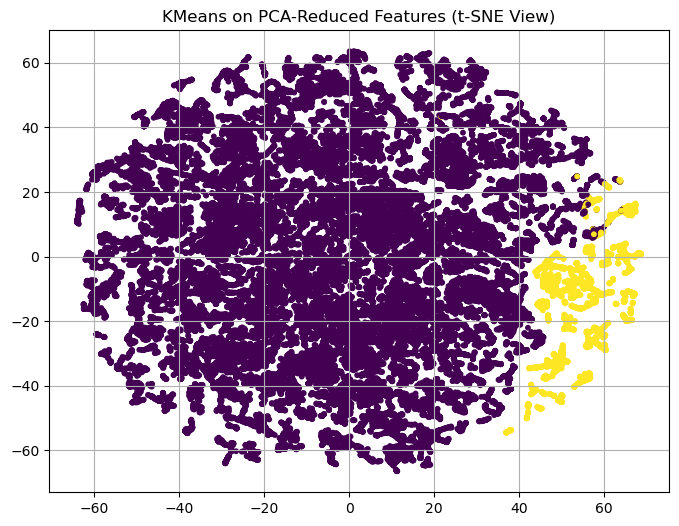

In [87]:
X_tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, random_state=42).fit_transform(X_pca)

plt.figure(figsize=(8, 6))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=kmeans_labels, cmap='viridis', s=10)
plt.title("KMeans on PCA-Reduced Features (t-SNE View)")
plt.grid(True)
plt.show()


### optional checking

/opt/miniconda/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/opt/miniconda/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/opt/miniconda/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
/opt/miniconda/lib/python3.11/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the valu

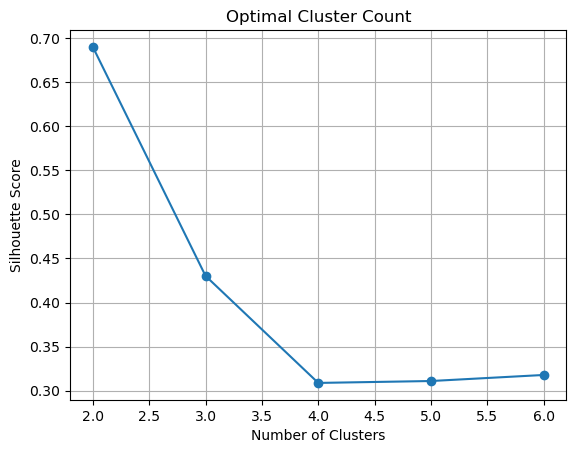

In [72]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import KMeans

# Try with more clusters (e.g., 2 to 6) and compute Silhouette
scores = []
for k in range(2, 7):
    km = KMeans(n_clusters=k, random_state=42)
    labels = km.fit_predict(X_pca)  # or directly on standardized data
    score = silhouette_score(X_pca, labels)
    scores.append((k, score))

# Plot silhouette scores
import matplotlib.pyplot as plt
ks, s_vals = zip(*scores)
plt.plot(ks, s_vals, marker='o')
plt.xlabel('Number of Clusters')
plt.ylabel('Silhouette Score')
plt.title('Optimal Cluster Count')
plt.grid(True)
plt.show()


### Step 7: Evaluate Clustering Quality

In [83]:
score = silhouette_score(X_pca, kmeans_labels)
print(f"Silhouette Score (KMeans on PCA-reduced): {score:.4f}")


Silhouette Score (KMeans on PCA-reduced): 0.6898


### cnfusion matrix

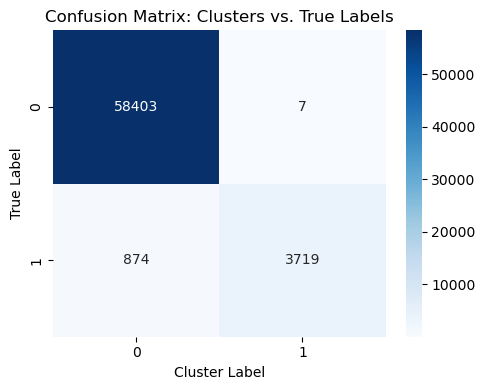

In [96]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt

# Align indices if needed (since X was dropna)
true_labels = df.loc[X.index, 'target']  # or use your actual label column
cluster_labels = kmeans_labels  # or labels_df['label_smooth'] for smoothed

cm = confusion_matrix(true_labels, cluster_labels)
plt.figure(figsize=(5, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues')
plt.xlabel('Cluster Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix: Clusters vs. True Labels')
plt.tight_layout()
plt.show()

### 3D visualization of cluster


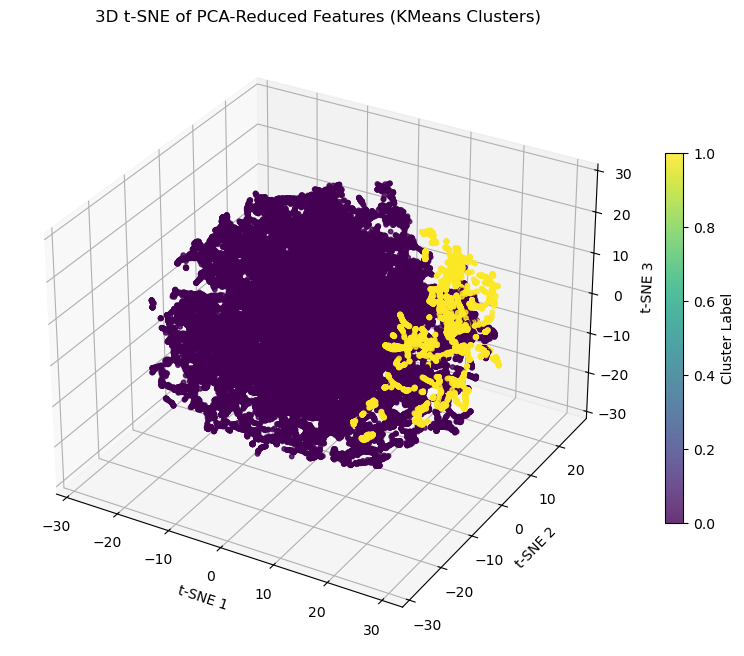

In [74]:
from mpl_toolkits.mplot3d import Axes3D
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

# === Compute a 3-dimensional t-SNE embedding of your PCA data ===
tsne_3d = TSNE(
    n_components=3,
    perplexity=30,
    learning_rate=200,
    random_state=42
)
X_tsne_3d = tsne_3d.fit_transform(X_pca)

# === Plot in 3D ===
fig = plt.figure(figsize=(10, 8))
ax  = fig.add_subplot(111, projection='3d')

scatter = ax.scatter(
    X_tsne_3d[:, 0],
    X_tsne_3d[:, 1],
    X_tsne_3d[:, 2],
    c=kmeans_labels,
    cmap='viridis',
    s=10,
    alpha=0.8
)

ax.set_title("3D t-SNE of PCA-Reduced Features (KMeans Clusters)")
ax.set_xlabel("t-SNE 1")
ax.set_ylabel("t-SNE 2")
ax.set_zlabel("t-SNE 3")

# add a colorbar (optional)
cbar = fig.colorbar(scatter, ax=ax, shrink=0.6)
cbar.set_label("Cluster Label")

plt.show()


### 3D Interactive visualization for clustering

In [ ]:
import pandas as pd
import plotly.express as px
from sklearn.manifold import TSNE

#  Step 1: Compute 3D t-SNE from PCA-reduced features 
tsne_3d = TSNE(n_components=3, perplexity=30, learning_rate=200, random_state=42)
X_tsne_3d = tsne_3d.fit_transform(X_pca)

#  Step 2: Prepare DataFrame for Plotly 
df_tsne = pd.DataFrame(X_tsne_3d, columns=['t-SNE 1', 't-SNE 2', 't-SNE 3'])
df_tsne['Cluster'] = kmeans_labels

#  Step 3: Create Interactive 3D Plot 
fig = px.scatter_3d(
    df_tsne,
    x='t-SNE 1',
    y='t-SNE 2',
    z='t-SNE 3',
    color='Cluster',
    color_continuous_scale='Viridis',
    opacity=0.8,
    title="Interactive 3D t-SNE of PCA-Reduced Features (KMeans Clusters)"
)

# Customize layout
fig.update_layout(
    scene=dict(
        xaxis_title='t-SNE 1',
        yaxis_title='t-SNE 2',
        zaxis_title='t-SNE 3'
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()
# Reference: https://chat.openai.com/


### CARE score

In [ ]:
import numpy as np

#  INPUTS (you must provide these from earlier analysis) 
total_failures = len(failure_times)
true_positives = len(matched_preds)     # matched early warnings
false_alarms = len(false_alarms)        # unmatched predictions
total_predictions = len(debounced_preds)
lead_times = [lf[2] for lf in early_failure_pairs]  # in hours

#  STEP 1: Compute Metrics 
TPR = true_positives / total_failures if total_failures > 0 else 0
FAR = false_alarms / total_predictions if total_predictions > 0 else 1

# Normalize lead time (assuming max useful early time = 24h)
lead_time_norm = [min(lt, 24) / 24 for lt in lead_times]
EARLINESS = np.mean(lead_time_norm) if lead_time_norm else 0

#  STEP 2: CARE Score 
# Use exponential decay on FAR and EARLINESS
CARE = TPR * np.exp(-FAR) * EARLINESS

#  PRINT 
print("====== CARE Score Report ======")
print(f"True Positive Rate (TPR):     {TPR:.2f}")
print(f"False Alarm Rate (FAR):       {FAR:.2f}")
print(f"Avg Normalized Lead Time:     {EARLINESS:.2f}")
print(f"\nCARE Score:                   {CARE:.4f}")
# reference: https://chat.openai.com/

====== CARE Score Report ======
True Positive Rate (TPR):     1.00
False Alarm Rate (FAR):       0.91
Avg Normalized Lead Time:     0.56

CARE Score:                   0.2252


## Early prediction 

Failure 16: Actual failure time: 2023-10-08 02:20:00
Failure 16: First predicted anomaly before failure: 2023-07-30 23:50:00
Failure 43: Actual failure time: 2023-08-24 14:00:00
Failure 43: First predicted anomaly before failure: 2023-08-01 21:10:00


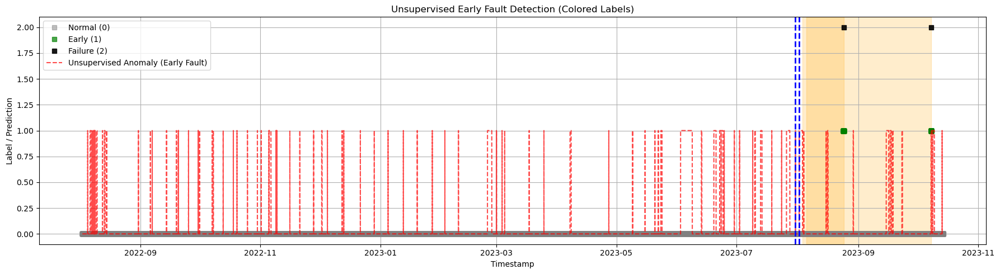

In [29]:
import matplotlib.pyplot as plt

plt.figure(figsize=(18, 5))

# Plot actual labels with custom colors
normal_mask = df['label'] == 0
early_mask = df['label'] == 1
failure_mask = df['label'] == 2

plt.plot(df.loc[normal_mask, 'time_stamp'], [0]*normal_mask.sum(), 's', color='gray', label='Normal (0)', alpha=0.5)
plt.plot(df.loc[early_mask, 'time_stamp'], [1]*early_mask.sum(), 's', color='green', label='Early (1)', alpha=0.7)
plt.plot(df.loc[failure_mask, 'time_stamp'], [2]*failure_mask.sum(), 's', color='black', label='Failure (2)', alpha=0.9)

# Plot unsupervised anomaly predictions
plt.plot(df['time_stamp'], df['anomaly_pred'], label='Unsupervised Anomaly (Early Fault)', color='red', linestyle='--', alpha=0.7)

# Highlight actual failure windows and print times
for i, event in events_44.iterrows():
    event_start = df.loc[event['event_start_id'], 'time_stamp']
    event_end = df.loc[event['event_end_id'], 'time_stamp']
    plt.axvspan(event_start, event_end, color='orange', alpha=0.2, label='Failure Window' if i == 0 else "")

    # Print actual failure time
    print(f"Failure {i+1}: Actual failure time: {event_end}")

    # Find first predicted anomaly before failure
    pred_mask = (df['anomaly_pred'] == 1) & (df['time_stamp'] < event_end)
    pred_times = df.loc[pred_mask, 'time_stamp']
    pred_times = pred_times[pred_times >= event_start - pd.Timedelta(hours=96)]
    if not pred_times.empty:
        first_pred_time = pred_times.iloc[0]
        print(f"Failure {i+1}: First predicted anomaly before failure: {first_pred_time}")
        plt.axvline(first_pred_time, color='blue', linestyle='--', linewidth=2, label='Predicted Early Fault' if i == 0 else "")

plt.xlabel('Timestamp')
plt.ylabel('Label / Prediction')
plt.title('Unsupervised Early Fault Detection (Colored Labels)')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()